In [ ]:
import time

import numpy as np
import pandas as pd
import yfinance as yf
from matplotlib import pyplot as plt
from tqdm import tqdm

import pandas as pd
import warnings

warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Yahoo download

In [ ]:
snp500 = pd.read_html(
    'https://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
snp500[0]

,Symbol,Security,GICS Sector,GICS Sub-Industry,Headquarters Location,Date added,CIK,Founded
0,MMM,3M,Industrials,Industrial Conglomerates,"Saint Paul, Minnesota",1957-03-04,66740,1902
1,AOS,A. O. Smith,Industrials,Building Products,"Milwaukee, Wisconsin",2017-07-26,91142,1916
2,ABT,Abbott,Health Care,Health Care Equipment,"North Chicago, Illinois",1957-03-04,1800,1888
3,ABBV,AbbVie,Health Care,Biotechnology,"North Chicago, Illinois",2012-12-31,1551152,2013 (1888)
4,ACN,Accenture,Information Technology,IT Consulting & Other Services,"Dublin, Ireland",2011-07-06,1467373,1989
...,...,...,...,...,...,...,...,...
498,XYL,Xylem Inc.,Industrials,Industrial Machinery & Supplies & Components,"White Plains, New York",2011-11-01,1524472,2011
499,YUM,Yum! Brands,Consumer Discretionary,Restaurants,"Louisville, Kentucky",1997-10-06,1041061,1997
500,ZBRA,Zebra Technologies,Information Technology,Electronic Equipment & Instruments,"Lincolnshire, Illinois",2019-12-23,877212,1969
501,ZBH,Zimmer Biomet,Health Care,Health Care Equipment,"Warsaw, Indiana",2001-08-07,1136869,1927


In [ ]:
snp500 = pd.read_html(
    'https://en.wikipedia.org/wiki/List_of_S%26P_500_companies')[0]
tickers = snp500.Symbol.to_list()
tickers[tickers.index('BRK.B')] = 'BRK-B'
tickers[tickers.index('BF.B')] = 'BF-B'

In [ ]:
data = yf.download(tickers, period="max")

In [ ]:
def yahoo_restructure_columns(data):
    '''
    1. Rename columns to camel case
    2. Flatten columns index
    3. Add row (date) index as column
    4. Remove row index name
    '''
    data = data.copy()
    data.rename(columns={'Adj Close':'adj_close', 'Close':'close', 'High':'high', 'Low':'low', 'Open':'open', 'Volume':'volume'}, inplace=True)
    data.columns = ["_".join(i) for i in data.columns.to_flat_index()]
    data['date'] = data.index
    data.index.name = None
    return data

In [ ]:
data = yahoo_restructure_columns(data)
data.to_csv('../data/raw/yahoo_snp500--.csv', index=False)

### Import from file

In [ ]:
def get_last_N_years(data, N):
    end_date = data.index.max()
    start_date = end_date - pd.DateOffset(years=N)
    return data[data.index >= start_date]

def get_tickers(data):
    return list({c[len('close_'):] for c in data.columns if c.startswith('close_')})

In [ ]:
data = pd.read_csv('../data/raw/yahoo_snp500.csv', parse_dates=['date'], index_col='date')

data = get_last_N_years(data, 30)
tickers = get_tickers(data)

### Preprocessing

In [ ]:
def yahoo_clean_data(data, max_nan=100, max_consecutive_nan=10, max_consecutive_zero_diff=20, max_time_jump = 10):
    '''
    1. Remove duplicates
    2. Remove columns with more than <max_nan> missing values
    3. Remove rows with more than <max_consecutive_nan> consecutive missing values
    4. Forward interpolate remaining missing values
    5. Remove rows with negative values
    6. Remove rows with zero values (without counting volume columns)
    7. Remove previous rows when there is a time jump greater than <max_time_jump>
    consecutive equal values

    '''
    data = data.copy()
    data = data.drop_duplicates()

    data = data.dropna(axis=1, thresh=(data.shape[0]-max_nan))

    mask = data.apply(lambda x: x.isna().groupby(x.notna().cumsum()).transform('count'))
    mask = mask <= max_consecutive_nan
    data = data[mask.all(axis=1)]

    data =  data.interpolate(method="linear", limit_direction="forward")

    criteria = (data < 0).any(axis=1)
    data = data.drop(data[criteria].index, axis=0)

    no_volume_data = data[data.columns.difference([i for i in data.columns if "volume" in i])]
    criteria = (no_volume_data <= 0).any(axis=1)
    data = data.drop(data[criteria].index, axis=0)

    rows_with_jump = data[data.index.to_series().diff().dt.days > 10]
    if len(rows_with_jump):
        last_index_with_jump = rows_with_jump.index[-1]
        data = data.loc[last_index_with_jump:]

    return data

def add_cyclical_time_features(data):
    day = 24*60*60
    year = 365.2425

    data['day_of_year_sin'] = np.sin(data.index.day_of_year * 2 * np.pi/year)
    data['day_of_year_cos'] = np.cos(data.index.day_of_year * 2 * np.pi/year)
    data['day_of_week_sin'] = np.sin((data.index.day_of_week+1) * 2 * np.pi/5)
    data['day_of_week_cos'] = np.sin((data.index.day_of_week+1) * 2 * np.pi/5)

def ohlc_adjust_dividend_and_split(data, tickers):
    '''
    Adjusts dividends as per https://help.yahoo.com/kb/SLN28256.html
    Yahoo finance ohlc data is already split adjusted:
        https://github.com/joshuaulrich/quantmod/issues/253
    '''
    data = data.copy()
    for ticker in tqdm(tickers):
        dividends = yf.Ticker(ticker).dividends
        # splits = yf.Ticker(ticker).splits

        if len(dividends):
            for date, dividend in dividends.items():
                date = date.tz_localize(None)
                if not pd.isnull(dividend) and date > data.index[0]:
                    prev_close = data.loc[(data.index < date), f'close_{ticker}'][-1]
                    data.loc[(data.index < date), f'open_{ticker}'] *= 1 - dividend/prev_close
                    data.loc[(data.index < date), f'high_{ticker}'] *= 1 - dividend/prev_close
                    data.loc[(data.index < date), f'low_{ticker}'] *= 1 - dividend/prev_close
                    data.loc[(data.index < date), f'close_{ticker}'] *= 1 - dividend/prev_close
        # if len(splits):
        #     for date, split in splits.items():
        #         date = date.tz_localize(None)
        #         if not pd.isnull(split) and date > data.index[0]:
        #             data.loc[(data.index < date), f'open_{ticker}'] /= split
        #             data.loc[(data.index < date), f'high_{ticker}'] /= split
        #             data.loc[(data.index < date), f'low_{ticker}'] /= split
        #             data.loc[(data.index < date), f'close_{ticker}'] /= split
    return data

In [ ]:
data = yahoo_clean_data(data)
tickers = get_tickers(data)

add_cyclical_time_features(data)

plt.plot(np.array(data['day_of_year_sin'])[:360])
plt.plot(np.array(data['day_of_year_cos'])[:360])
plt.xlabel('Day')
plt.title('Day of year signal')

In [ ]:
data = ohlc_adjust_dividend_and_split(data, tickers)
data = data.drop(columns=[i for i in data.columns if i.startswith('adj_close')])

In [ ]:
data.to_csv('../data/clean_adjusted/yahoo_snp500-_years.csv', index=True)

### Labeling

In [ ]:
data = pd.read_csv('../data/clean_adjusted/yahoo_snp500-10_years.csv', parse_dates=['date'], index_col='date')
tickers = get_tickers(data)

In [ ]:
def fixed_time_horizon(close, horizon=5, threshold=.1):
    """
    Labels data according to returns over a horizon:
        r_t+h,t = p_t+h /p_t - 1

        y_i = 1 if r_t+h,t > threshold
        y_i = -1 if r_t+h,t < -threshold
        y_i = 0 if -threshold < r_t+h,t < threshold
    """
    horizon_returns = (close.shift(-horizon) / close - 1).dropna()

    labels = pd.Series(0,index=horizon_returns.index)
    labels += horizon_returns > threshold
    labels -= horizon_returns < -threshold

    return labels

def binary_fixed_time_horizon(close, horizon=5, threshold=.5):
    """
    Labels data according to returns over a horizon:
        r_t+h,t = p_t+h /p_t - 1

        y_i = 1 if r_t+h,t > threshold
        y_i = 0 if r_t+h,t < threshold
    """
    horizon_returns = (close.shift(-horizon) / close - 1).dropna()

    labels = pd.Series(0,index=horizon_returns.index)
    labels += horizon_returns > threshold

    return labels

def dynamic_threshold(close, horizon=5, span=10):
    """
    Calculates the exponentially weighted moving standard deviation of returns, with:
        r_t+h,t = p_t+h /p_t - 1

        y_i = 1 if r_t+h,t > ema_std_t
        y_i = -1 if r_t+h,t < -ema_std_t
        y_i = 0 if -ema_std_t < r_t+h,t < ema_std_t
    """
    horizon_returns = close.shift(-horizon) / close - 1

    daily_returns = close / close.shift(1) - 1
    previous_day_std = daily_returns.shift(1).rolling(window=span).std()
    ema_std = previous_day_std.ewm(span=span).mean().dropna()

    df = pd.concat([horizon_returns,ema_std], axis=1, keys=['horizon_returns', 'ema_std']).dropna()
    labels = pd.Series(0,index=df.index)
    labels += df['horizon_returns'] > df['ema_std']
    labels -= df['horizon_returns'] < -df['ema_std']

    return labels

def binary_dynamic_threshold(close, horizon=5, span=10):
    """
    Calculates the exponentially weighted moving standard deviation of returns, with:
        r_t+h,t = p_t+h /p_t - 1

        y_i = 1 if r_t+h,t > ema_std_t
        y_i = 0 if r_t+h,t <= -ema_std_t
    """
    horizon_returns = close.shift(-horizon) / close - 1

    daily_returns = close / close.shift(1) - 1
    previous_day_std = daily_returns.shift(1).rolling(window=span).std()
    ema_std = previous_day_std.ewm(span=span).mean().dropna()

    df = pd.concat([horizon_returns,ema_std], axis=1, keys=['horizon_returns', 'ema_std']).dropna()
    labels = pd.Series(0,index=df.index)
    labels += df['horizon_returns'] > df['ema_std']

    return labels


def get_labels(data, tickers, method="dynamic_threshold", horizon=4, span=10, threshold=.06):
    """
    Produces a label dataframe with labels per ticker <label_{ticker_name}>

    <method>:
        dynamic_threshold
        fixed_time_horizon
        triple_barrier
    """
    data = data.copy()
    labels = pd.DataFrame()

    if method == "triple_barrier":
        labels = add_triple_barrier_labels(data)
    else:
        for ticker in tqdm(tickers):
            close = data[f'close_{ticker}']
            if method == "fixed_time_horizon":
                labels[f'label_{ticker}'] = fixed_time_horizon(close, horizon, threshold)
            elif method == "dynamic_threshold":
                labels[f'label_{ticker}'] = dynamic_threshold(close, horizon, span)
            labels = labels.copy()
    return labels

def reduce_labels(labels_df, method='mode', verbose_stats=True, threshold=.4):
    '''
    Reduces a DataFrame of label_{ticker_name} to individual labels.
    '''
    if method not in {'mode', 'sign_of_sum', 'balanced'}:
        print('Invalid argument for reduce_labels: Not a valid labeling method!')
        return

    if method == 'mode':
        labels = labels_df.mode(axis=1)[0]

    if method == 'sign_of_sum':
        labels = labels_df.apply(lambda x:np.sign(sum(x)),axis=1)
    if method == 'balanced':
        mean_ups = (labels_df == 1).mean(axis=1)
        mean_downs = (labels_df == -1).mean(axis=1)
        labels = pd.Series(0, labels_df.index)
        labels += np.logical_and(mean_ups > mean_downs, mean_ups > threshold)
        labels -= np.logical_and(mean_downs > mean_ups, mean_downs > threshold)

    if verbose_stats:
        print('**********************************')
        print("Class distribution for reduced labels")
        print(labels.value_counts(normalize=True))
        print('**********************************')

    return labels

In [ ]:
labels = get_labels(data, tickers, "dynamic_threshold", horizon=2, span=5)
#labels = get_labels(data, tickers, "fixed_time_horizon", horizon=1, threshold=.01)
#labels = get_labels(data, tickers, "triple_barrier")

reduced_labels = reduce_labels(labels, method='balanced')

In [ ]:
labelled_data = data.copy()
labelled_data['label'] = reduced_labels
labelled_data = labelled_data.dropna()

In [ ]:
def plot_data_and_labels(df):
    N = 200
    df = df[:N]

    plt.plot(df['close'])
    plt.scatter(df[df['label']==1].index, df[df['label']==1]['close'], color='g')
    plt.scatter(df[df['label']==-1].index, df[df['label']==-1]['close'], color='r')
    #plt.scatter(df[df['label']==0].index, df[df['label']==0]['close'], color='b')

In [ ]:
snp500_data = yf.download("SPY", period="max")
snp500_data = snp500_data.loc[labelled_data.index]

df = pd.concat([snp500_data['Close'], labelled_data['label']], axis=1, keys=['close', 'label']).dropna()
plot_data_and_labels(df)

In [ ]:
labelled_data.to_csv('../data/yahoo_snp500-_years-b-dt-h_2-s_5.csv')

## Add TA indicators

In [ ]:
data = pd.read_csv('../data/yahoo_snp500-10_years-b-dt-h_2-s_5.csv', parse_dates=['date'], index_col='date')
tickers = get_tickers(data)

In [ ]:
from ta import add_all_ta_features
from ta.utils import dropna


def add_ta_features(data, tickers):
    data = data.copy()
    for ticker in tqdm(tickers):
        data = add_all_ta_features(
            data, open=f"open_{ticker}", high=f"high_{ticker}",
            low=f"low_{ticker}", close=f"close_{ticker}",volume=f"volume_{ticker}", fillna=True, colprefix=f"{ticker}_")
        data = data.copy()
    return data

def rename_ta_features(data, tickers):
    data = data.copy()
    for ticker in tickers:
        prev_cols = [i for i in data.columns if ticker in i and i.startswith(f"{ticker}_")]
        new_cols = [f"{i[len(ticker)+1:]}_{ticker}" for i in prev_cols]
        cols = {k:v for k,v in zip(prev_cols, new_cols)}
        if len(cols):
            data.rename(columns=cols, inplace=True)
    return data

In [ ]:
data = add_ta_features(data, tickers)
data = rename_ta_features(data, tickers)

In [ ]:
data.to_parquet('../data/yahoo_snp500-ta-10_years-b-dt-h_2-s_5.parquet', compression='snappy')

## Evaluate and fix non-stationarity

In [ ]:
data = pd.read_parquet('/content/drive/MyDrive/data/yahoo_snp500_updated-stat2-30_years')

In [ ]:
test_stationarity(data['close_diff_252_AEP'], verbose=True)

ADF Statistic: -4.491898756607408
p-value: 0.00020337509847772697
lag: 34
Critical Values:
   1%: -3.431268514249962
   5%: -2.861945910598893
   10%: -2.5669860621190232
The time series is stationary (reject the null hypothesis).



True

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss
from scipy import stats
import numba

def test_stationarity(series, method="adf", verbose=False):
    if method == "adf":
        result = adfuller(series)

        adf_statistic = result[0]
        p_value = result[1]
        lag = result[2]
        critical_values = result[4]

        if verbose:
            print(f'ADF Statistic: {adf_statistic}')
            print(f'p-value: {p_value}')
            print(f'lag: {lag}')
            print('Critical Values:')
            for key, value in critical_values.items():
                print(f'   {key}: {value}')

            if p_value <= 0.05:
                print("The time series is stationary (reject the null hypothesis).\n")
            else:
                print("The time series is non-stationary (fail to reject the null hypothesis).\n")
    elif method == "kpss":
        result = kpss(series)

        kpss_statistic = result[0]
        p_value = result[1]

        if verbose:
            print(f'KPSS Statistic: {kpss_statistic}')
            print(f'p-value: {p_value}')

            if p_value <= 0.05:
                print("The time series is non-stationary (reject the null hypothesis).\n")
            else:
                print("The time series is stationary (fail to reject the null hypothesis).\n")

    return p_value <= 0.05

def make_stationary_series(series, method="diff", period=252):
    res = None
    if method=="diff":
        res =  series.diff(periods=period).dropna()
    elif method=="linear_detrend":
        diff_series = series.diff(periods=period).dropna()

        x = np.arange(len(diff_series))
        slope, intercept, _, _, _ = stats.linregress(x, diff_series)
        res = diff_series - (slope * x + intercept)
    elif method=="log_diff":
        res = np.log(series).diff(periods=period).dropna()
    return res

def get_non_stationary_cols(data):
    non_stationary_cols = []
    for col in tqdm(data.columns):
        series = data[col]

        is_stationary = test_stationarity(series)
        if not is_stationary:
            non_stationary_cols.append(col)
    return non_stationary_cols

def make_stationary_data(data, method="diff", max_degree=None, cols=None):
    '''
    <method>:
        diff
        log_diff
        linear_detrend
    '''
    data = data.copy()
    if cols is None:
        non_stationary_cols = get_non_stationary_cols(data)
    else:
        non_stationary_cols = cols

    while len(non_stationary_cols) or max_degree:
        for col in tqdm(non_stationary_cols):
            series = data[col]

            data[col] = make_stationary_series(series, method)

            is_stationary = test_stationarity(series)
            if is_stationary and col in non_stationary_cols:
                non_stationary_cols.remove(col)

        if max_degree:
            max_degree -= 1

        data = data.dropna()
    data = data.dropna()
    return data

In [ ]:
data = pd.read_parquet('/content/drive/MyDrive/data/yahoo_snp500_updated-ta-30_years.parquet')
#data = pd.read_parquet('/content/drive/MyDrive/data/yahoo_snp500-ta-30_years-b-dt-h_2-s_5.parquet')
tickers = get_tickers(data)

In [ ]:
test_stationarity(data['close_AEP_diff_1'], verbose=True)

In [ ]:
labels = data['label']
data = data.drop(columns='label')

In [ ]:
cols = ['volatility_dch_','volume_nvi_','volatility_dch_','trend_ichimoku_a_','high_','open_','volume_obv_','volume_nvi_', 'volatility_bbh_', 'volatility_kcc_', 'volatility_kcl_', 'volatility_dch_', 'trend_sma_fast_', 'trend_ema_fast_', 'trend_ichimoku_conv_', 'trend_ichimoku_a_', 'trend_visual_ichimoku_a_', 'trend_psar_up_', 'momentum_kama_', 'close_', 'high_', 'low_', 'open_', 'volume_adi_', 'volume_obv_', 'volume_vwap_', 'volume_nvi_', 'volatility_bbm_', 'volatility_bbh_', 'volatility_bbl_', 'volatility_kcc_', 'volatility_kch_', 'volatility_kcl_', 'volatility_dcl_', 'volatility_dch_', 'volatility_dcm_', 'trend_sma_fast_', 'trend_sma_slow_', 'trend_ema_fast_', 'trend_ema_slow_', 'trend_ichimoku_conv_', 'trend_ichimoku_base_', 'trend_ichimoku_a_', 'trend_ichimoku_b_', 'trend_visual_ichimoku_a_', 'trend_visual_ichimoku_b_', 'trend_psar_up_', 'trend_psar_down_', 'momentum_kama_','others_cr_']
pattern = '|'.join(cols)
cols = list(data.filter(regex=pattern).columns)

In [ ]:
data = make_stationary_data(data, method="diff", max_degree=None, cols=cols)

100%|██████████| 1/1 [00:00<00:00,  1.37it/s]


In [ ]:
def get_tickers2(data):
    '''
    Gets tickers for stat2 data (for which get_tickers mistakenly gets diff_{n}_{ticker} as columns).
    '''
    return list({c[len('close_diff_1_'):] for c in data.columns if c.startswith('close_diff_1_')})

In [ ]:
data = pd.read_parquet('/content/drive/MyDrive/data/yahoo_snp500_updated-stat2-30_years')
#data = pd.read_parquet('/content/drive/MyDrive/data/yahoo_snp500-ta-30_years-b-dt-h_2-s_5.parquet')
tickers = get_tickers2(data)

In [ ]:
for i, ticker in tqdm(enumerate(tickers)):
    cols = [f'close_{ticker}', f'high_{ticker}', f'open_{ticker}', f'low_{ticker}']
    cols += [
        f'momentum_kama_{ticker}',
        f'others_cr_{ticker}',
        f'trend_ema_fast_{ticker}',
        f'trend_ema_slow_{ticker}',
        f'trend_ichimoku_a_{ticker}',
        f'trend_ichimoku_b_{ticker}',
        f'trend_ichimoku_base_{ticker}',
        f'trend_ichimoku_conv_{ticker}',
        f'trend_psar_down_{ticker}',
        f'trend_psar_up_{ticker}',
        f'trend_sma_fast_{ticker}',
        f'trend_sma_slow_{ticker}',
        f'trend_visual_ichimoku_a_{ticker}',
        f'trend_visual_ichimoku_b_{ticker}',
        f'volatility_bbh_{ticker}',
        f'volatility_bbl_{ticker}',
        f'volatility_bbm_{ticker}',
        f'volatility_dch_{ticker}',
        f'volatility_dcl_{ticker}',
        f'volatility_dcm_{ticker}',
        f'volatility_kcc_{ticker}',
        f'volatility_kch_{ticker}',
        f'volatility_kcl_{ticker}',
        f'volume_adi_{ticker}',
        f'volume_nvi_{ticker}',
        f'volume_obv_{ticker}',
        f'volume_vwap_{ticker}'
    ]
    data = data.drop(columns=cols)

300it [05:37,  1.13s/it]


In [ ]:
data = data.drop(columns=['label'])

In [ ]:
def add_all_differences(data):
    data = data.copy()
    cols = ['close_', 'high_', 'open_', 'low_']
    cols += [
                'momentum_kama_',
                'others_cr_',
                'trend_ema_fast_',
                'trend_ema_slow_',
                'trend_ichimoku_a_',
                'trend_ichimoku_b_',
                'trend_ichimoku_base_',
                'trend_ichimoku_conv_',
                'trend_psar_down_',
                'trend_psar_up_',
                'trend_sma_fast_',
                'trend_sma_slow_',
                'trend_visual_ichimoku_a_',
                'trend_visual_ichimoku_b_',
                'volatility_bbh_',
                'volatility_bbl_',
                'volatility_bbm_',
                'volatility_dch_',
                'volatility_dcl_',
                'volatility_dcm_',
                'volatility_kcc_',
                'volatility_kch_',
                'volatility_kcl_',
                'volume_adi_',
                'volume_nvi_',
                'volume_obv_',
                'volume_vwap_'
            ]
    for i, ticker in tqdm(enumerate(tickers)):
        for col in cols:
            ticker_col = data[f'{col}{ticker}']
            for period in [1,5,20,252]:
                data[f'{col}diff_{period}_{ticker}']= make_stationary_series(ticker_col, period=period)
            data = data.drop(columns=[f'{col}{ticker}'])
        if i%100==0:
            data = data.copy()
    return data
data = add_all_differences(data)

In [ ]:
data.to_parquet('/content/drive/MyDrive/data/yahoo_snp500_updated-stat3-30_years', compression='snappy')

Plot close_AEP
False


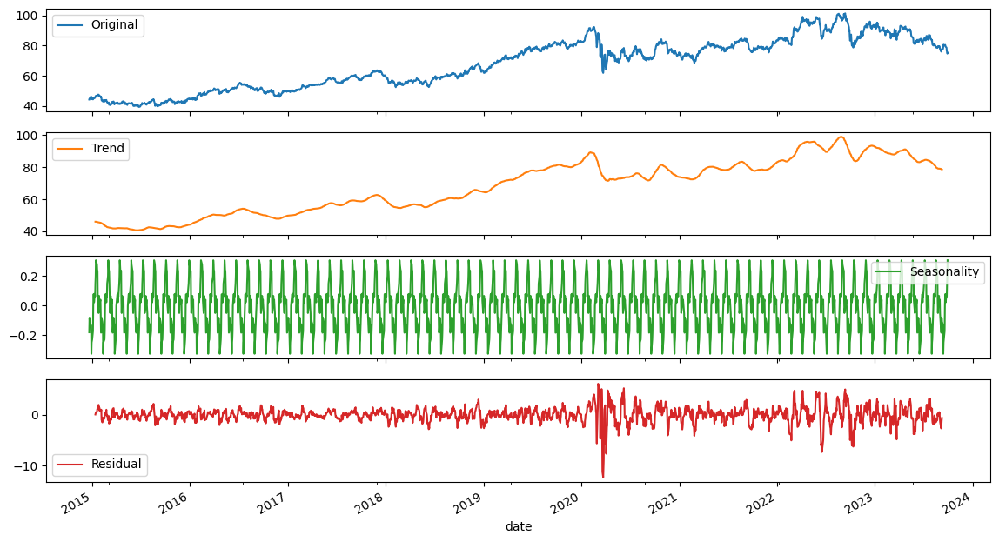

Plot high_AEP
False


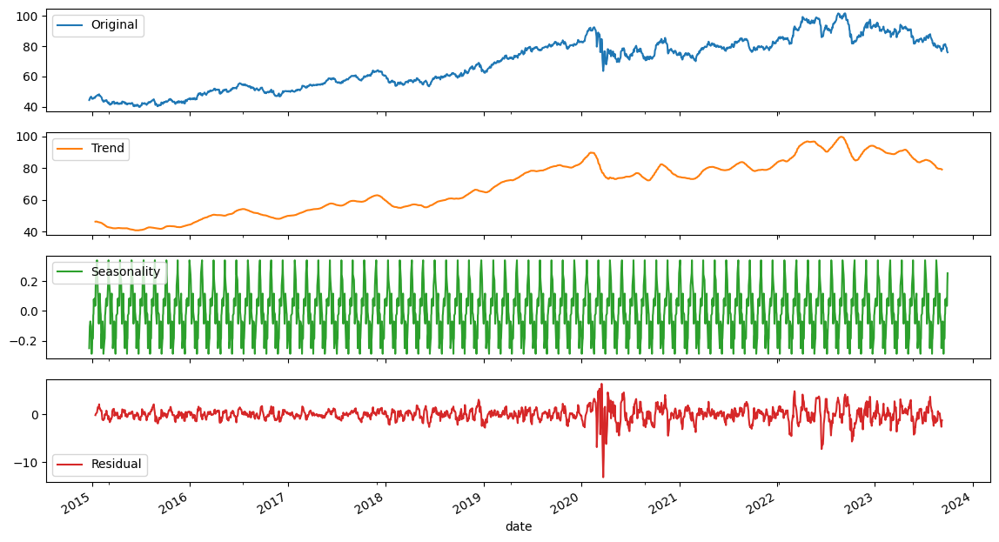

Plot low_AEP
False


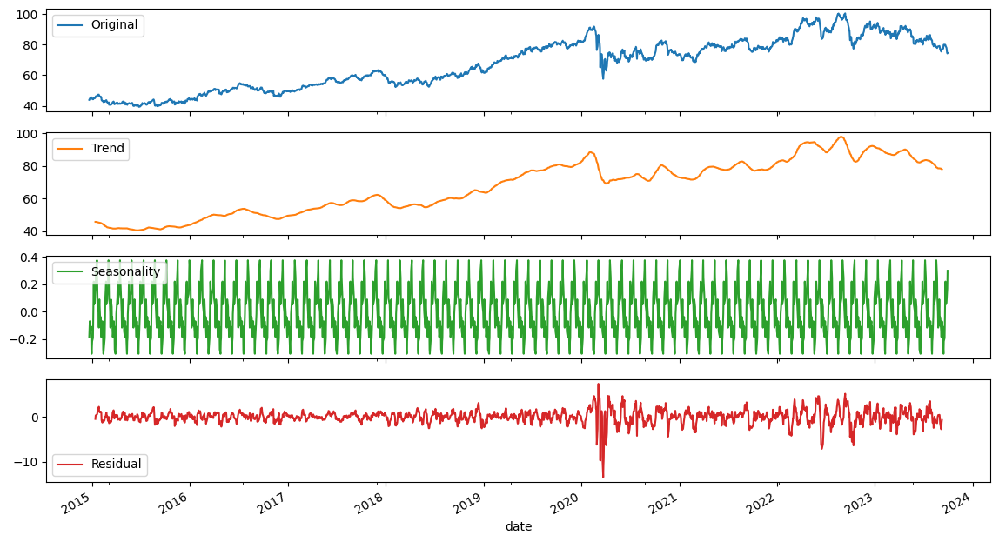

Plot open_AEP
False


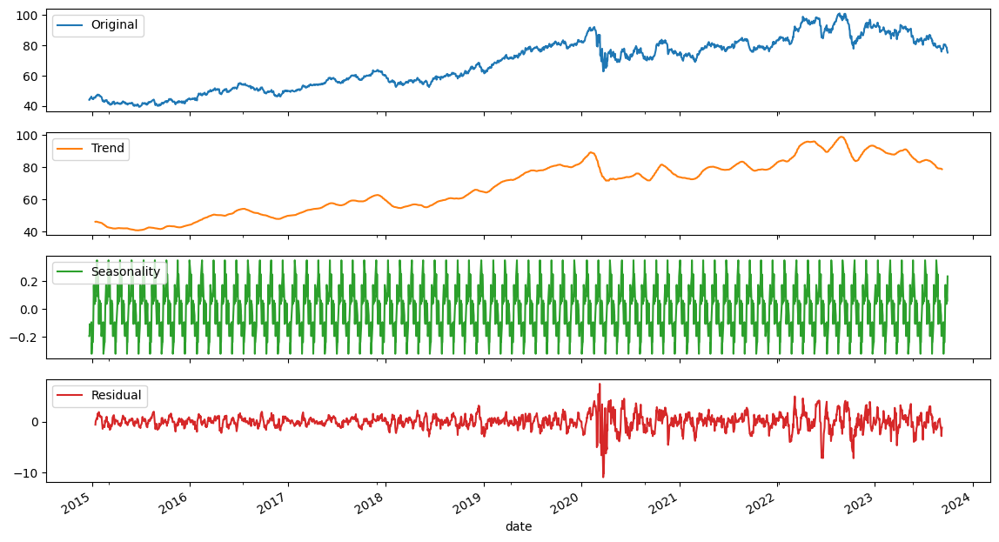

Plot volume_AEP
True


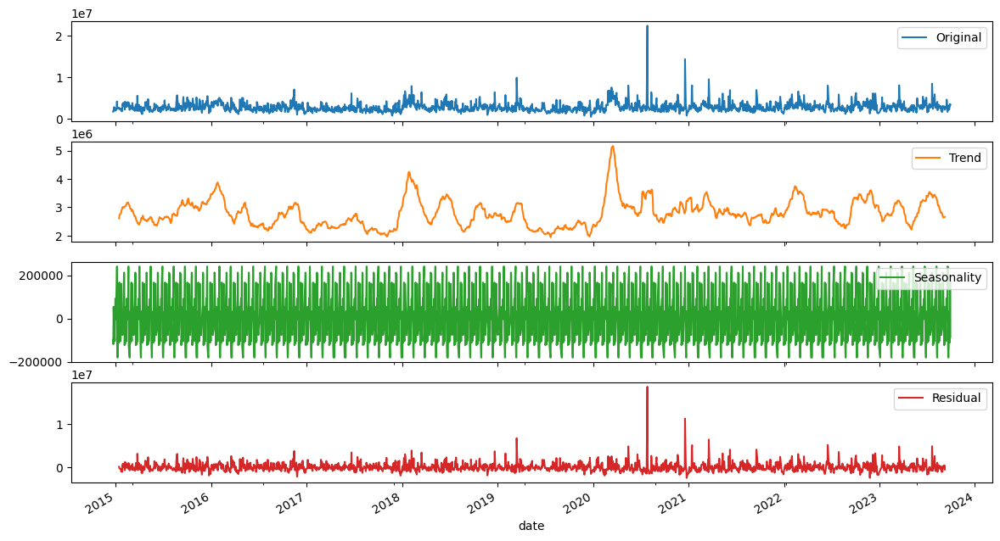

Plot volume_adi_AEP
False


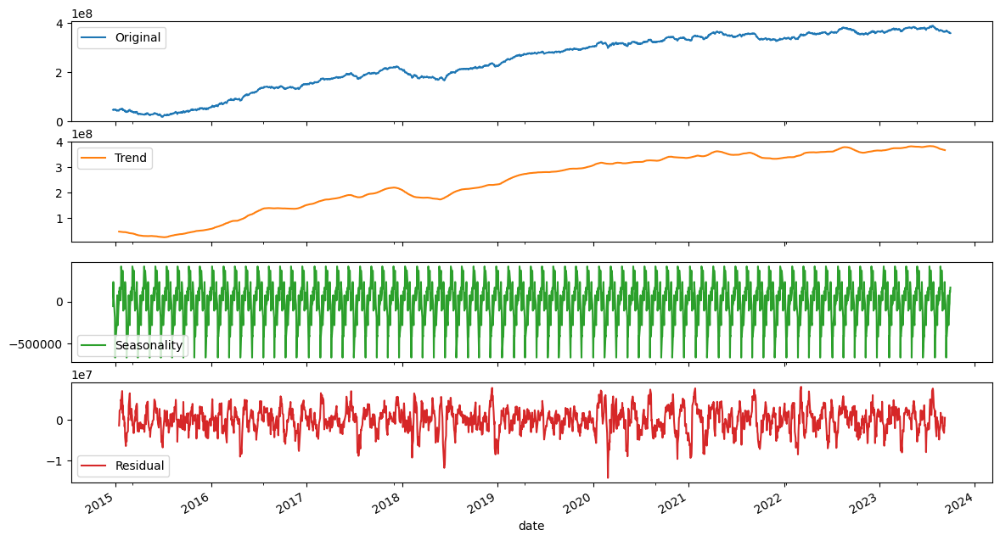

Plot volume_obv_AEP
False


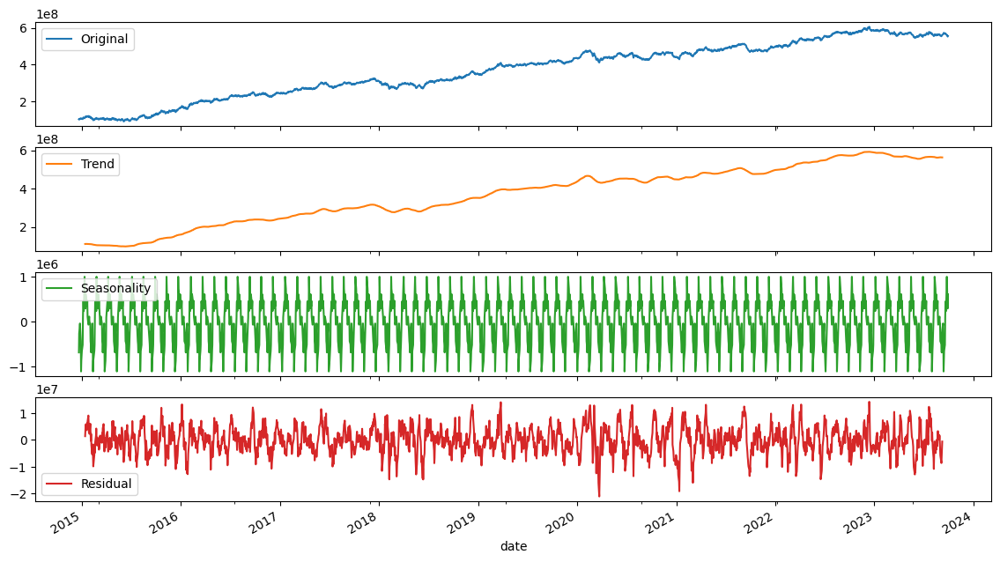

Plot volume_cmf_AEP
True


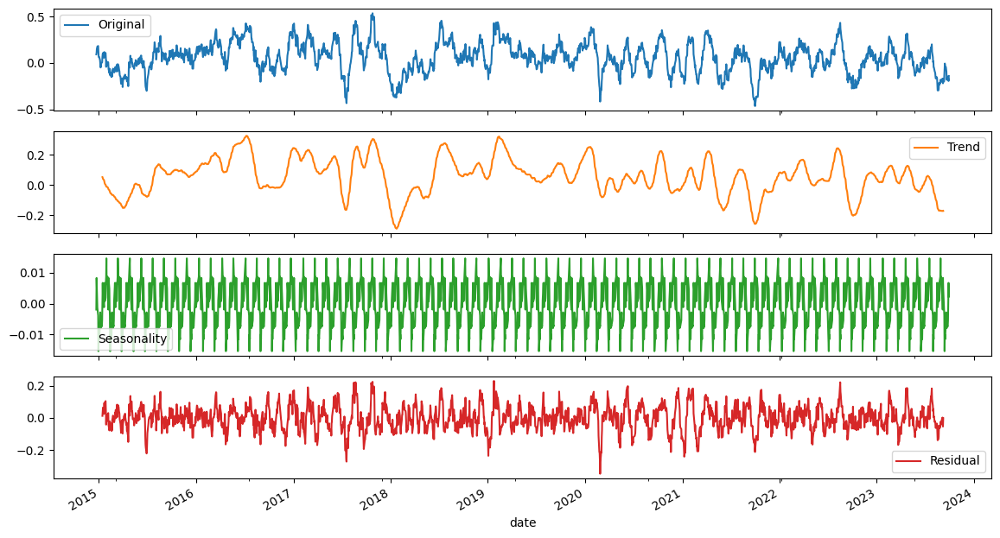

Plot volume_fi_AEP
True


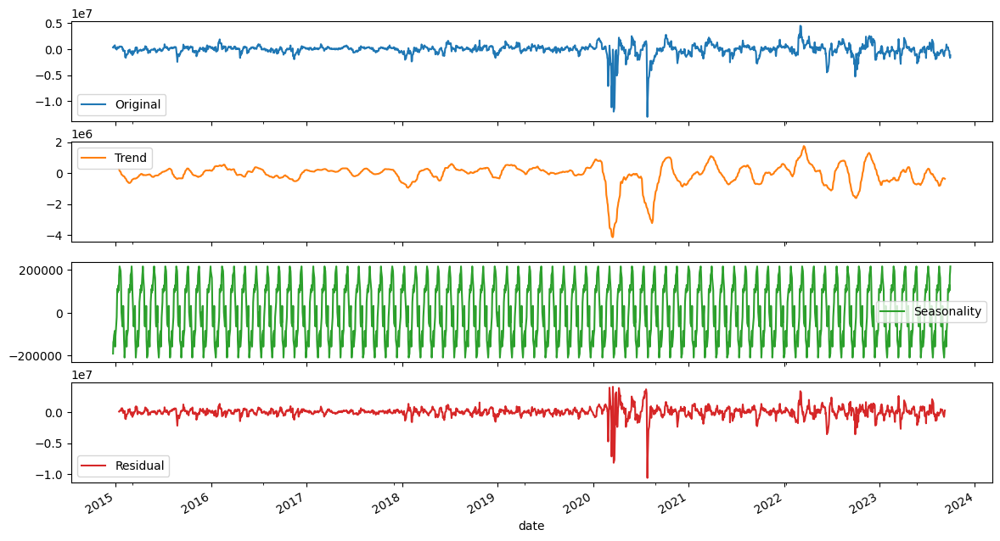

Plot volume_em_AEP
True


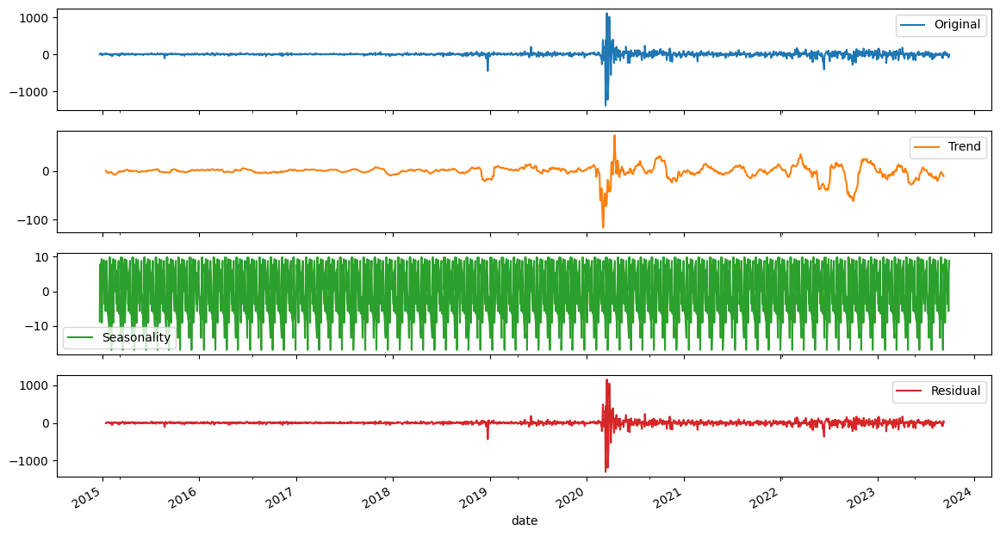

Plot volume_sma_em_AEP
True


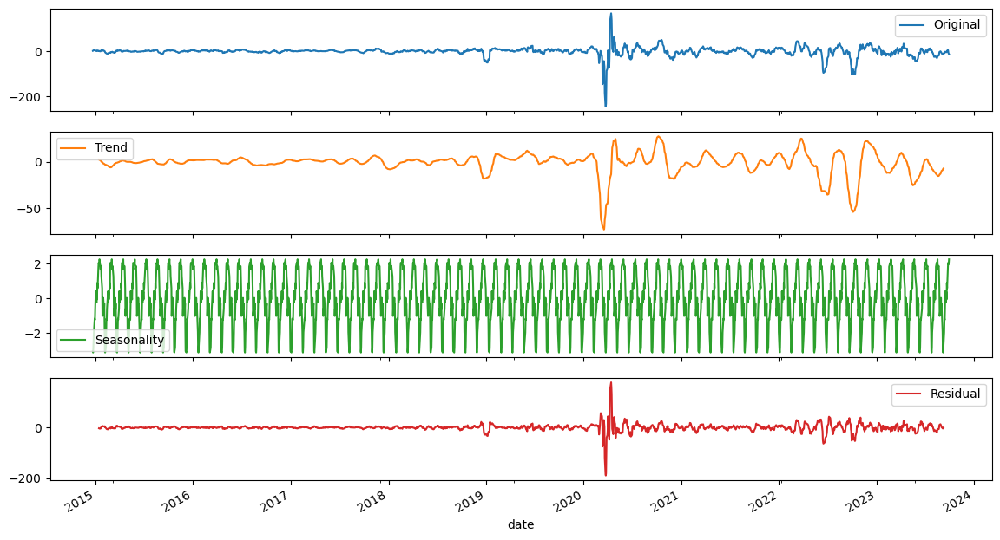

Plot volume_vpt_AEP
True


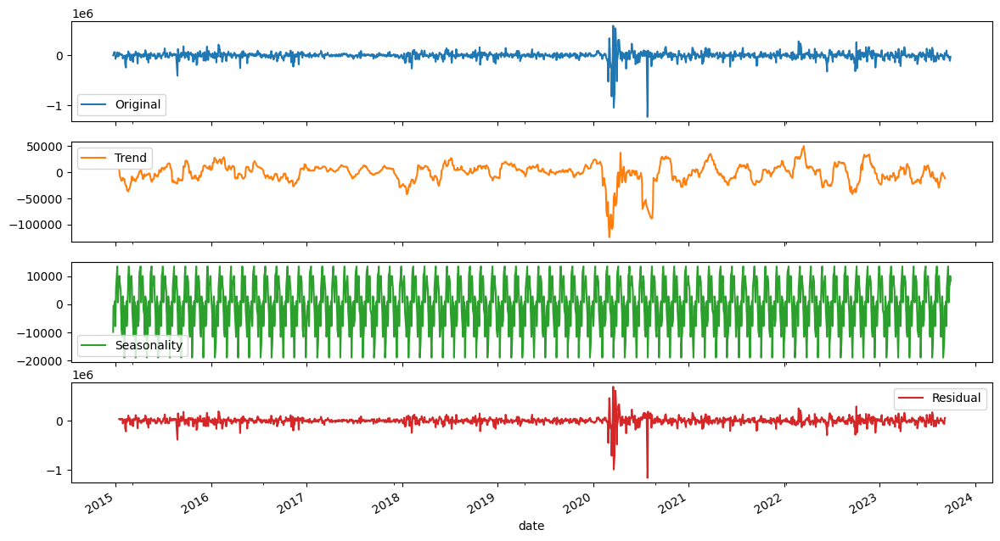

Plot volume_vwap_AEP
False


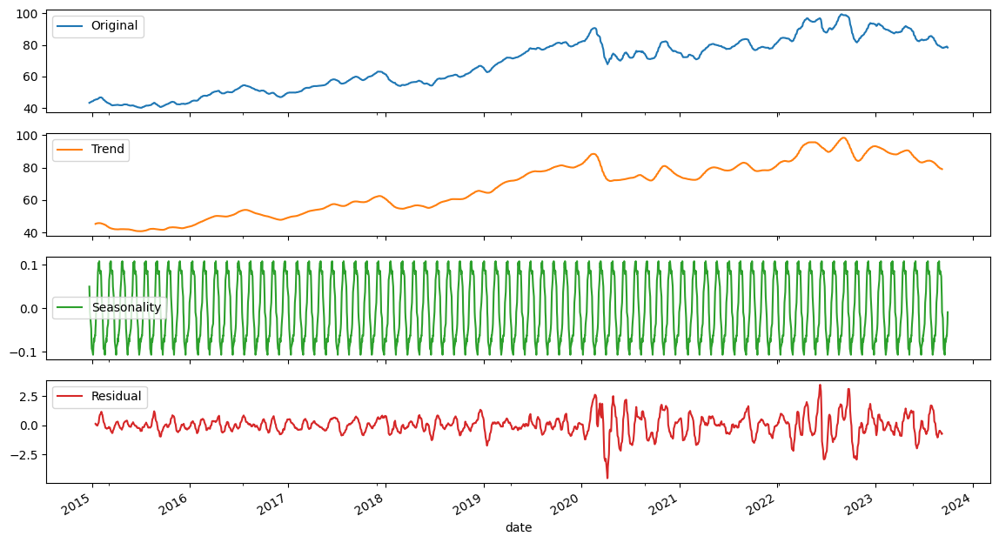

Plot volume_mfi_AEP
True


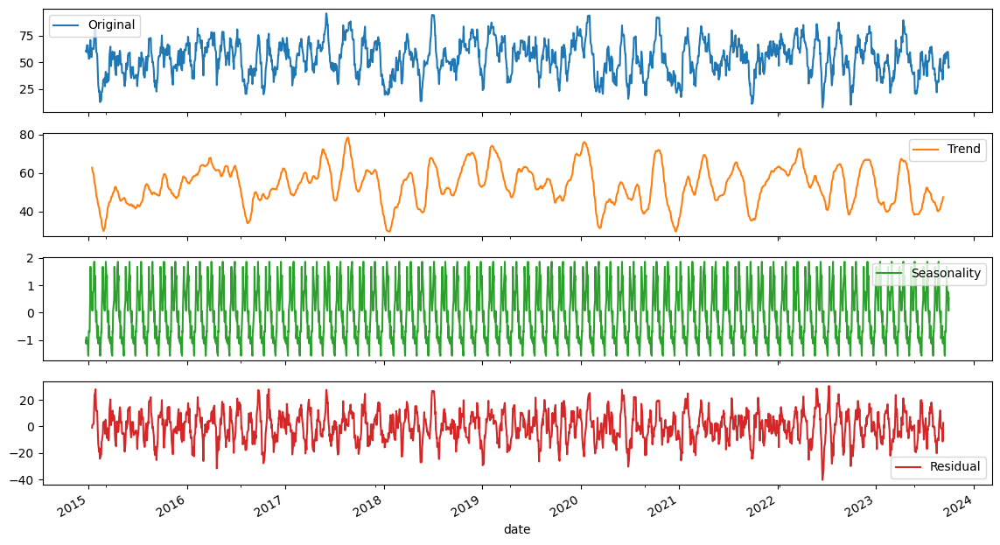

Plot volume_nvi_AEP
False


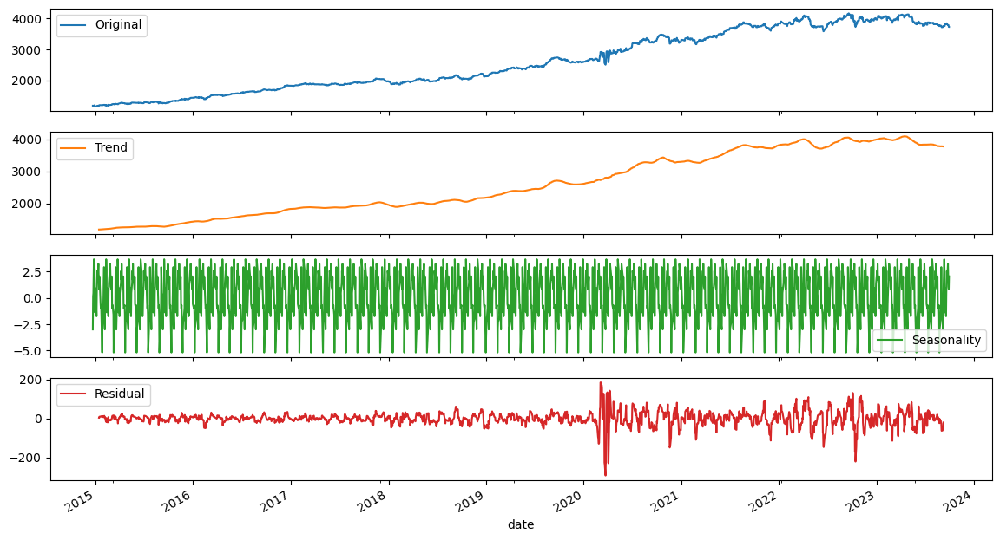

Plot volatility_bbm_AEP
False


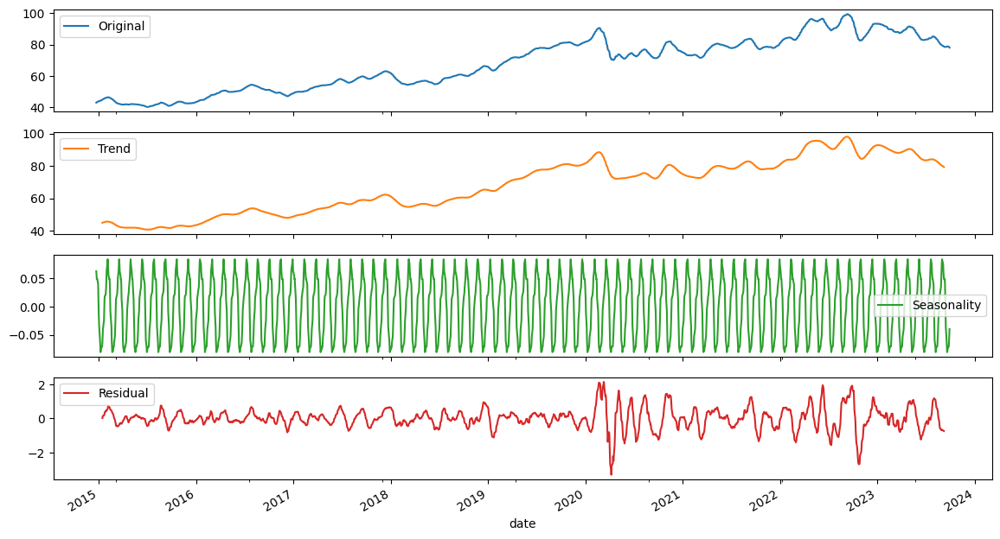

Plot volatility_bbh_AEP
False


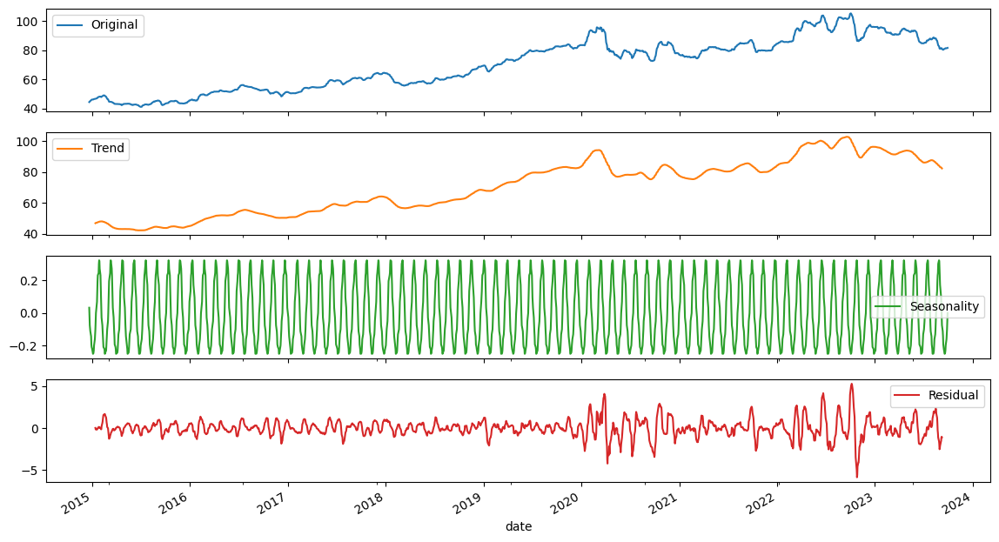

Plot volatility_bbl_AEP
False


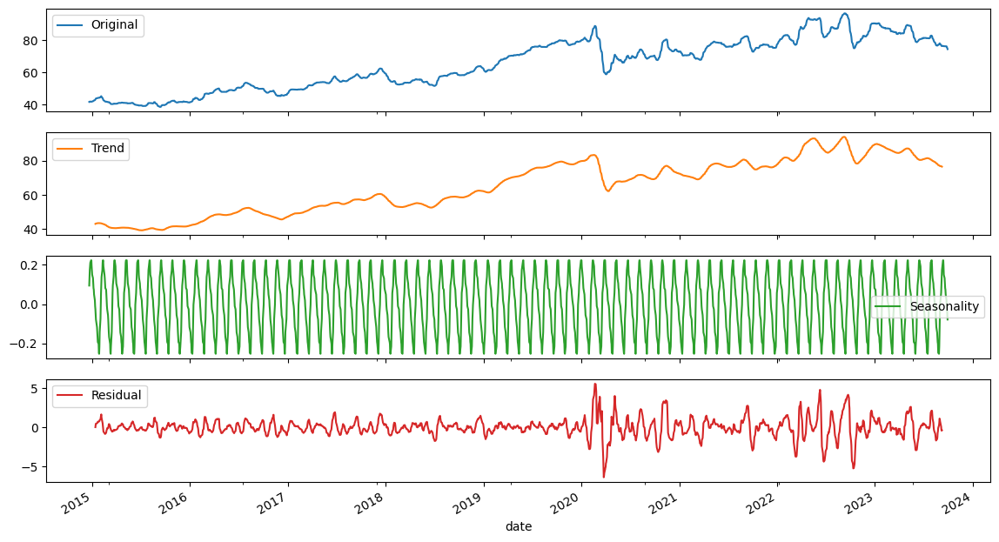

Plot volatility_bbw_AEP
True


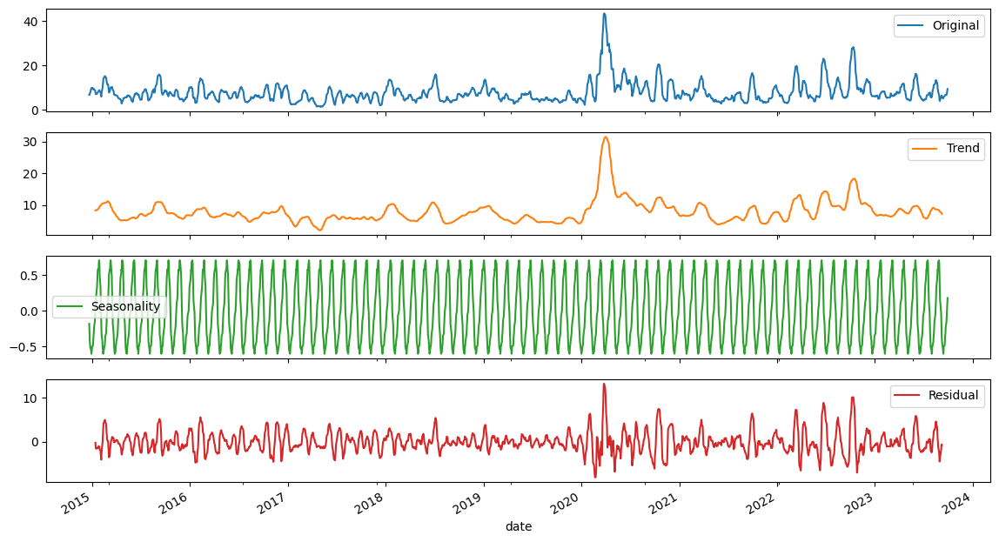

Plot volatility_bbp_AEP
True


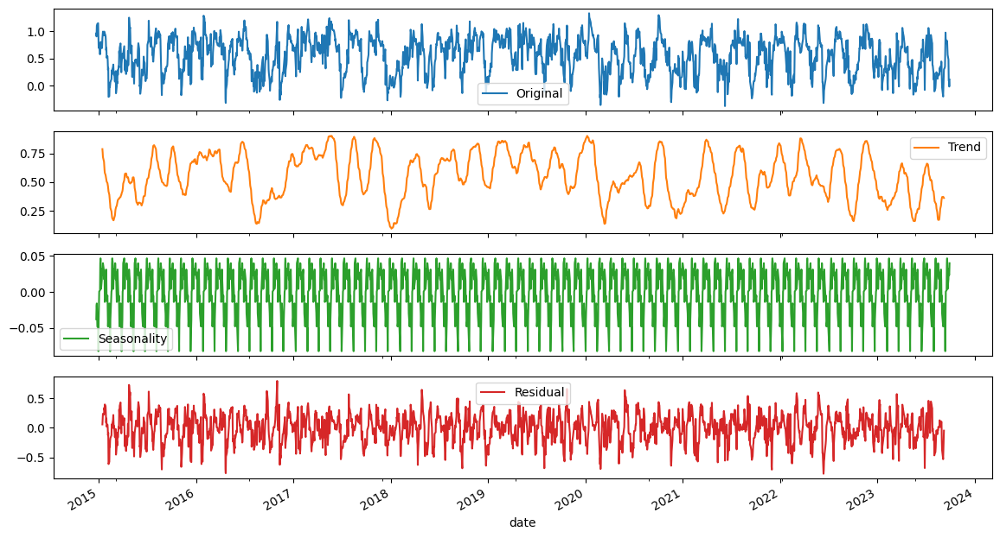

Plot volatility_bbhi_AEP
True


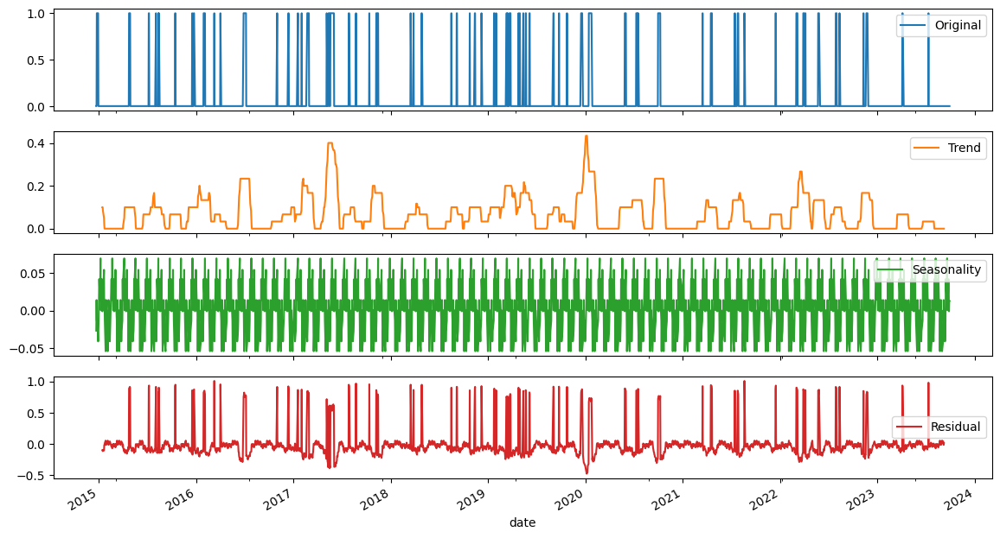

Plot volatility_bbli_AEP
True


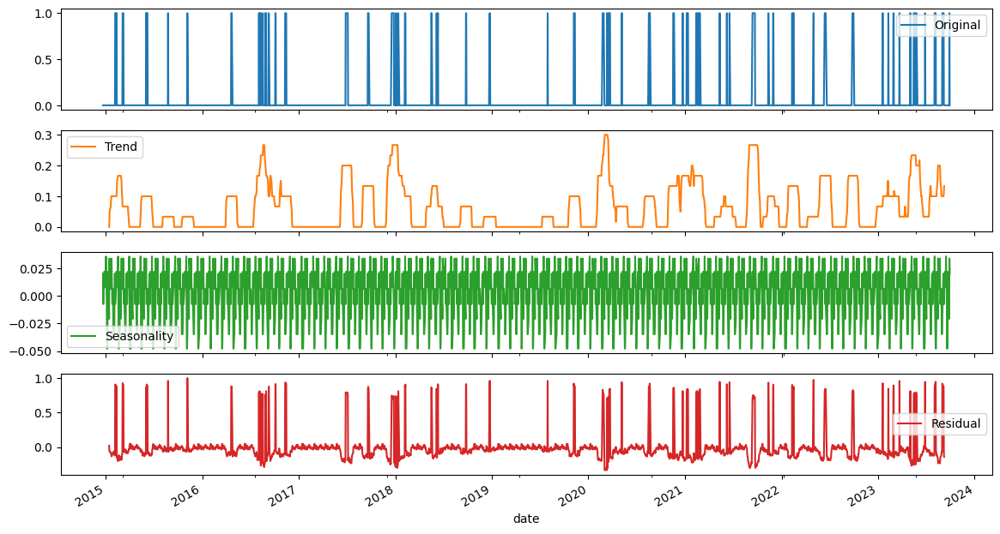

Plot volatility_kcc_AEP
False


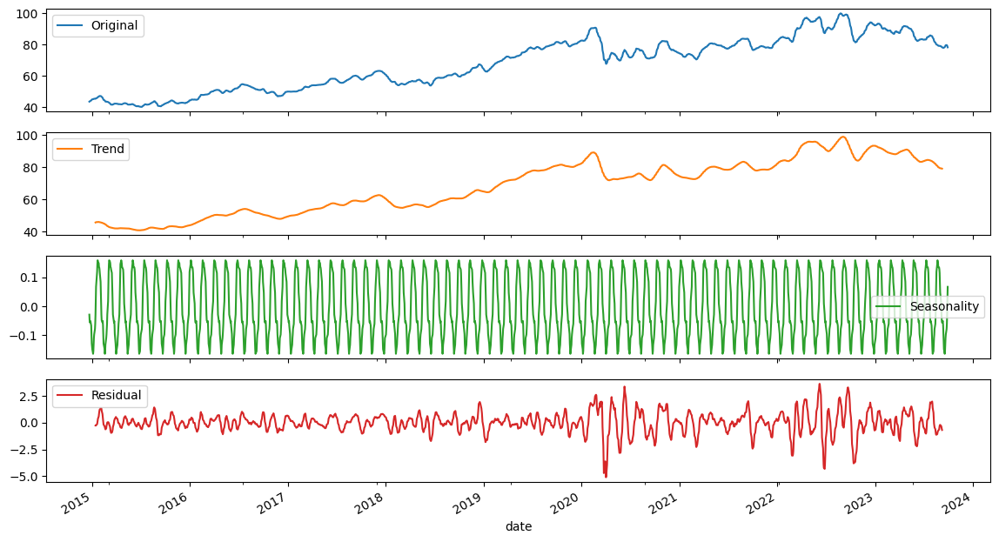

Plot volatility_kch_AEP
False


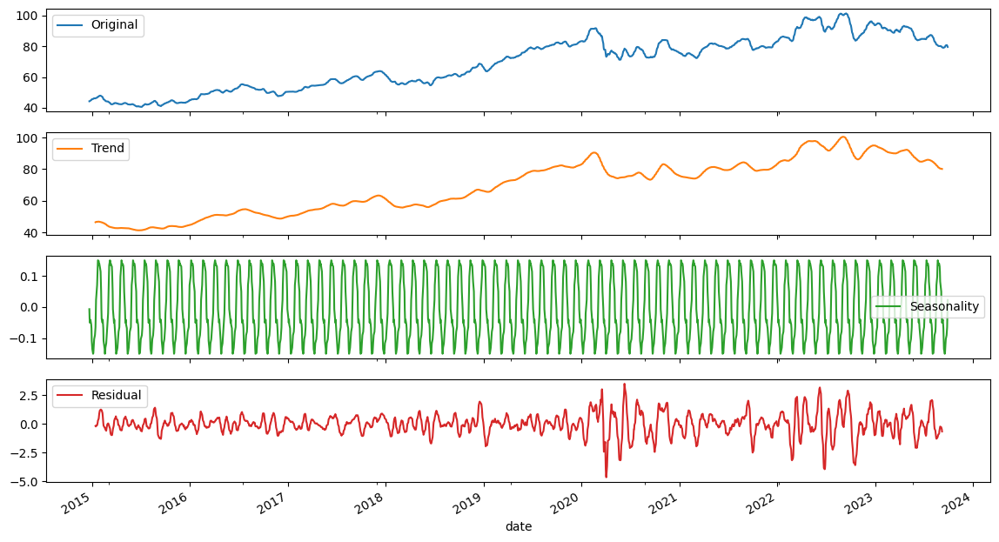

Plot volatility_kcl_AEP
False


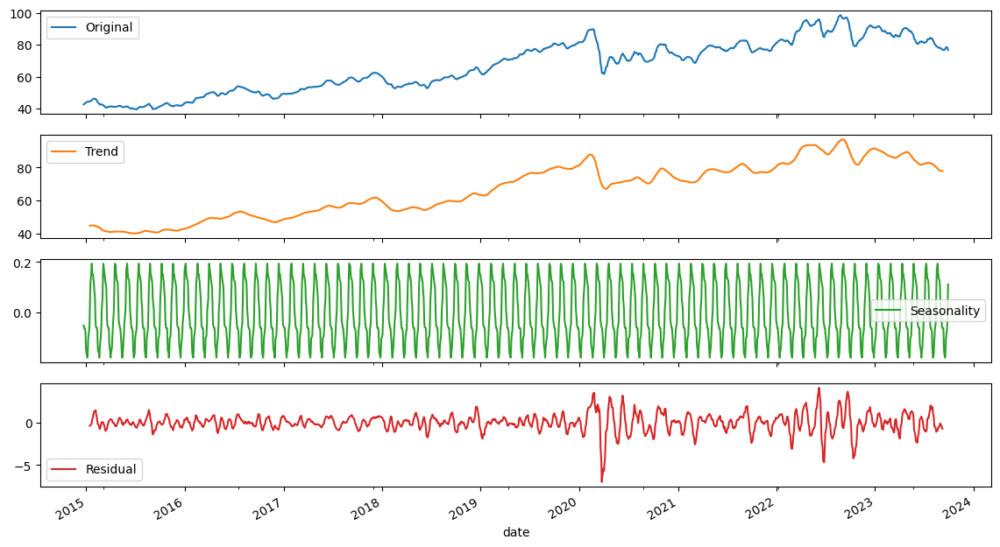

Plot volatility_kcw_AEP
True


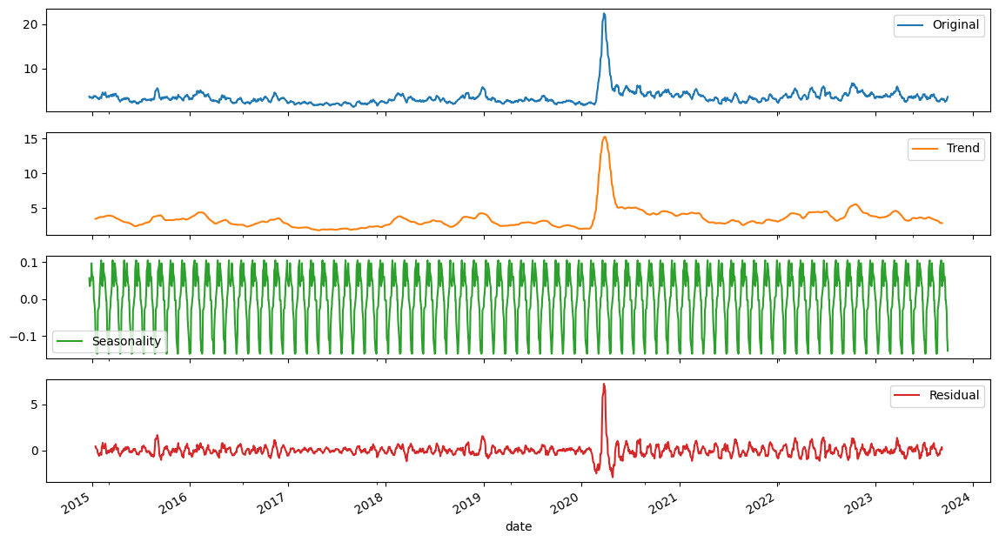

Plot volatility_kcp_AEP
True


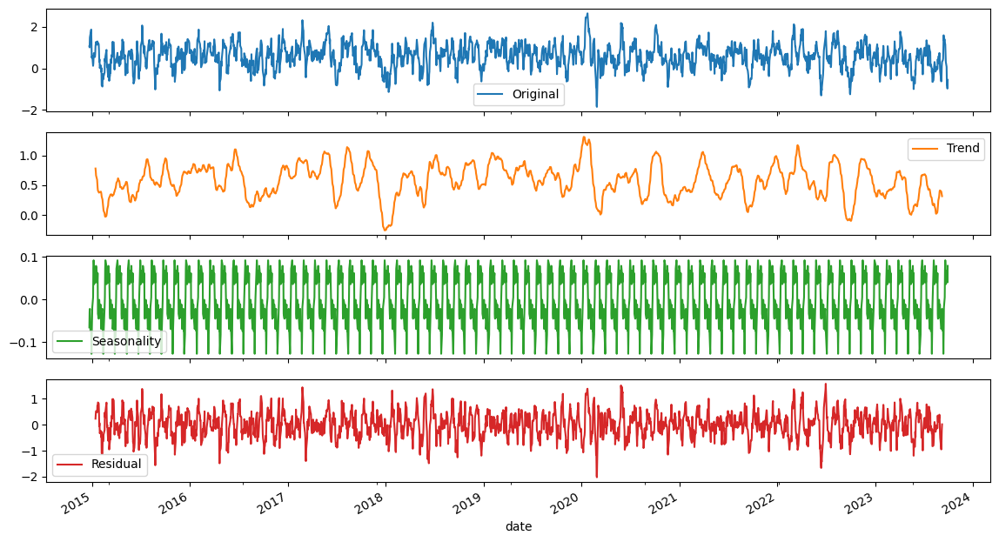

Plot volatility_kchi_AEP
True


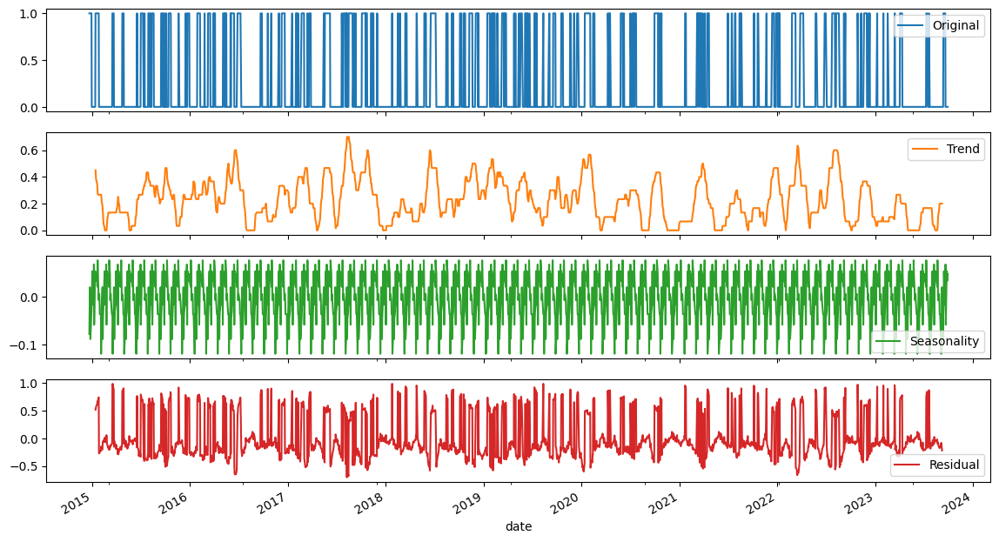

Plot volatility_kcli_AEP
True


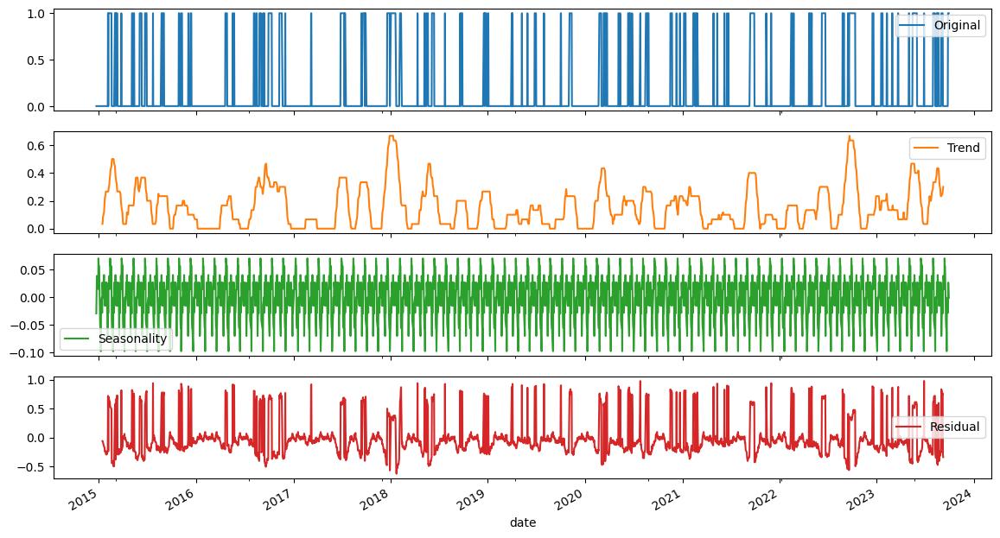

Plot volatility_dcl_AEP
False


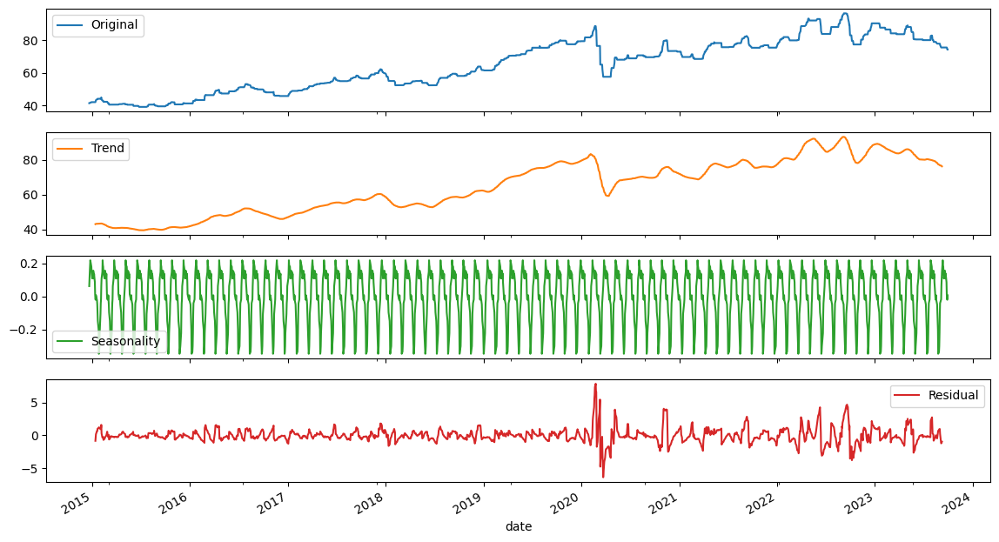

Plot volatility_dch_AEP
False


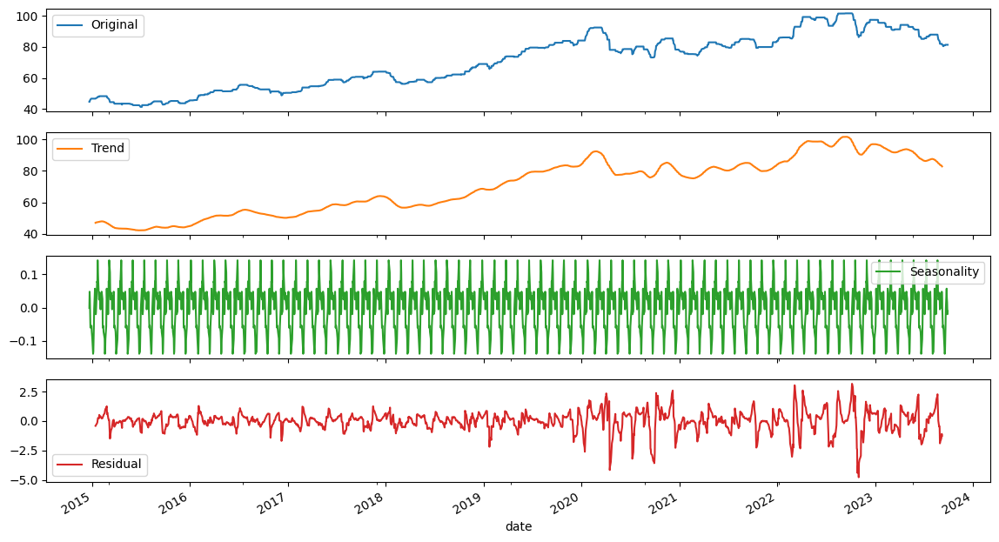

Plot volatility_dcm_AEP
False


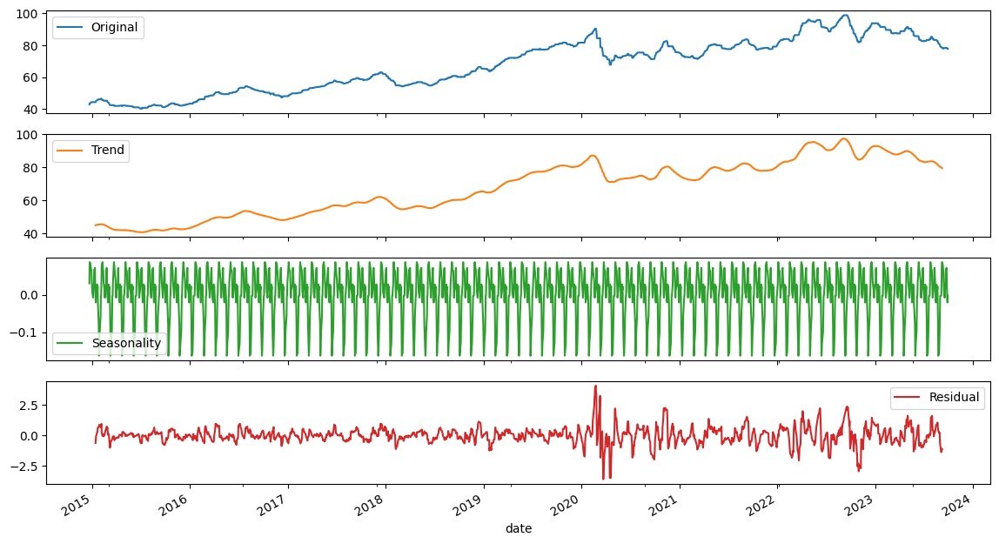

Plot volatility_dcw_AEP
True


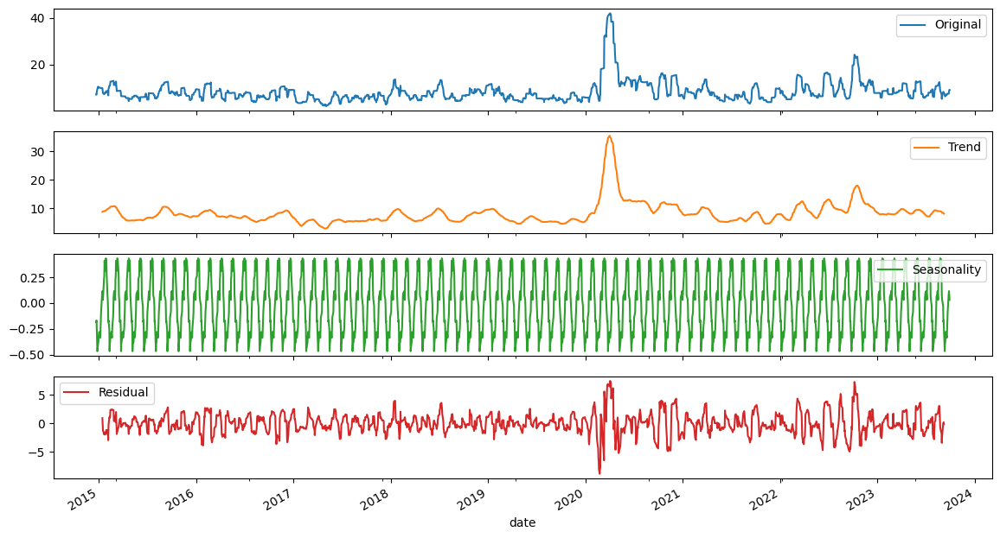

Plot volatility_dcp_AEP
True


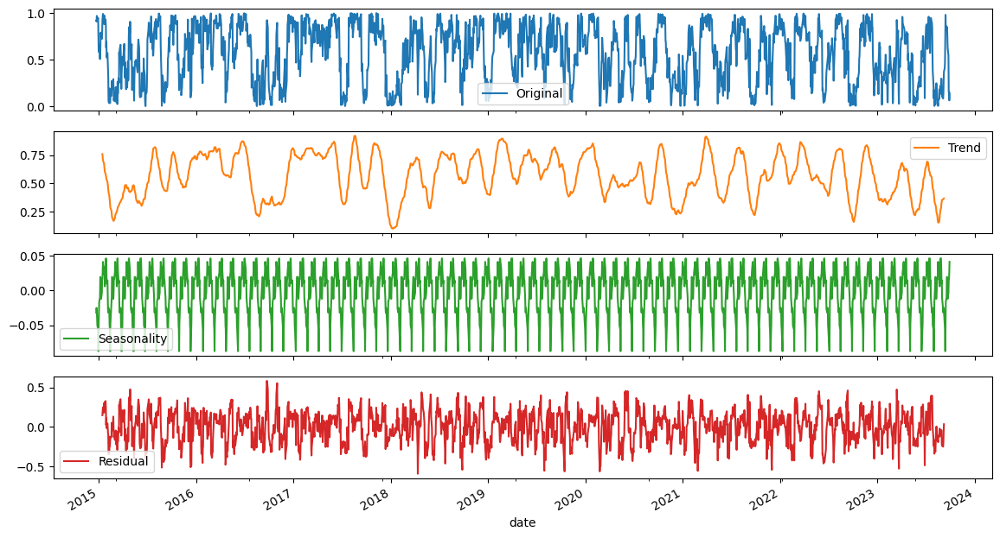

Plot volatility_atr_AEP
True


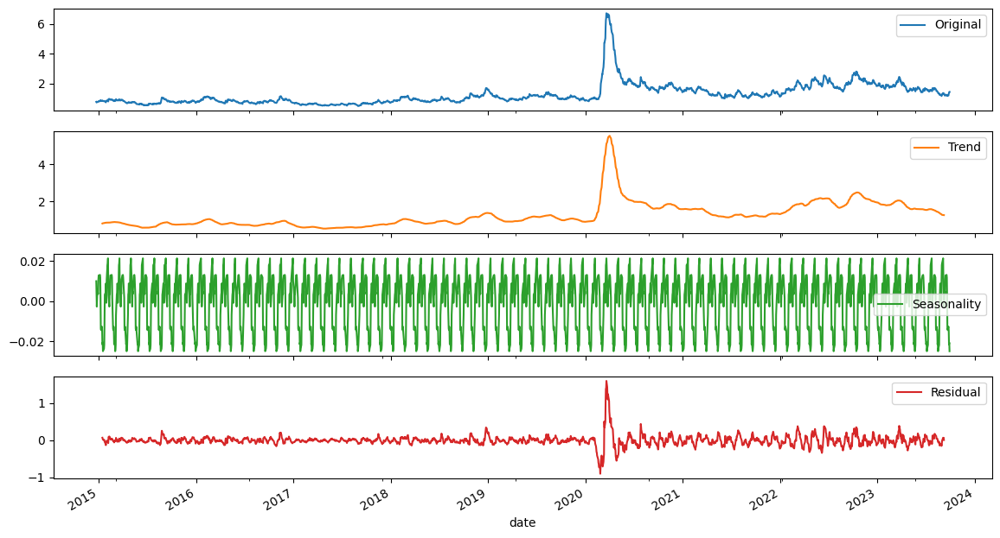

Plot volatility_ui_AEP
True


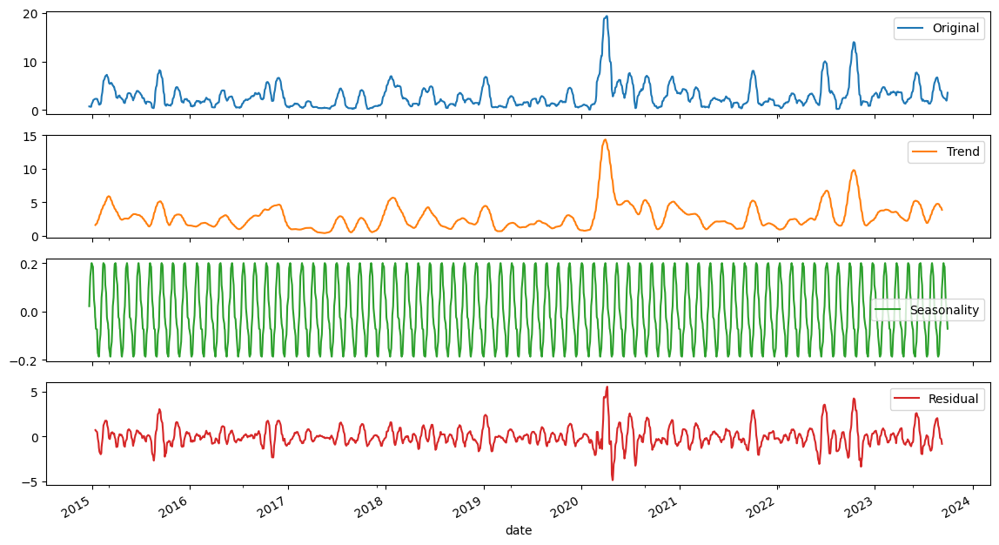

Plot trend_macd_AEP
True


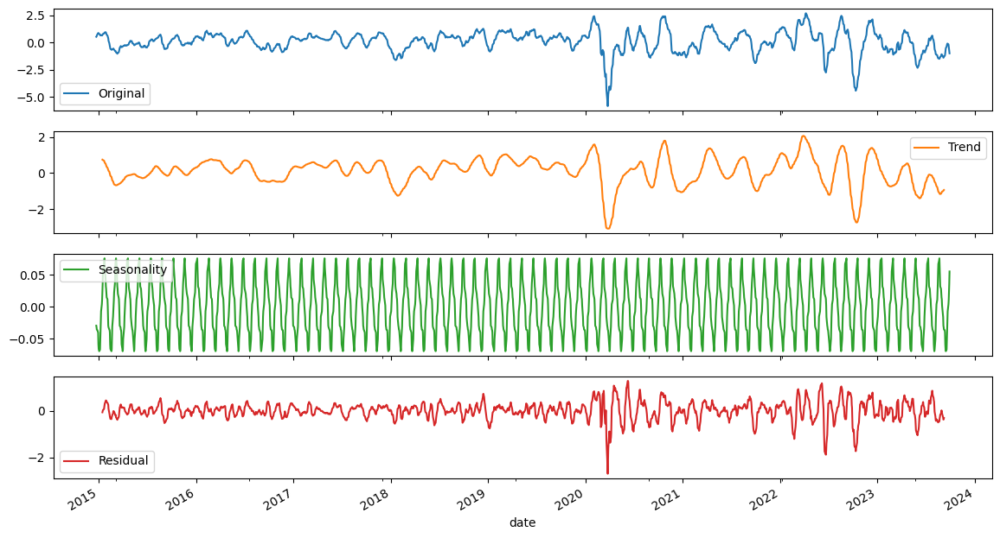

Plot trend_macd_signal_AEP
True


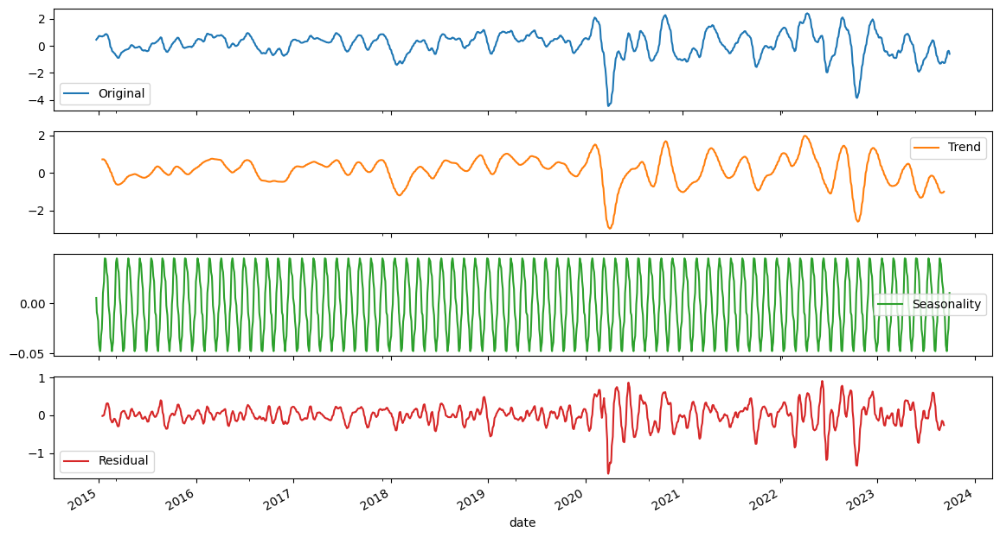

Plot trend_macd_diff_AEP
True


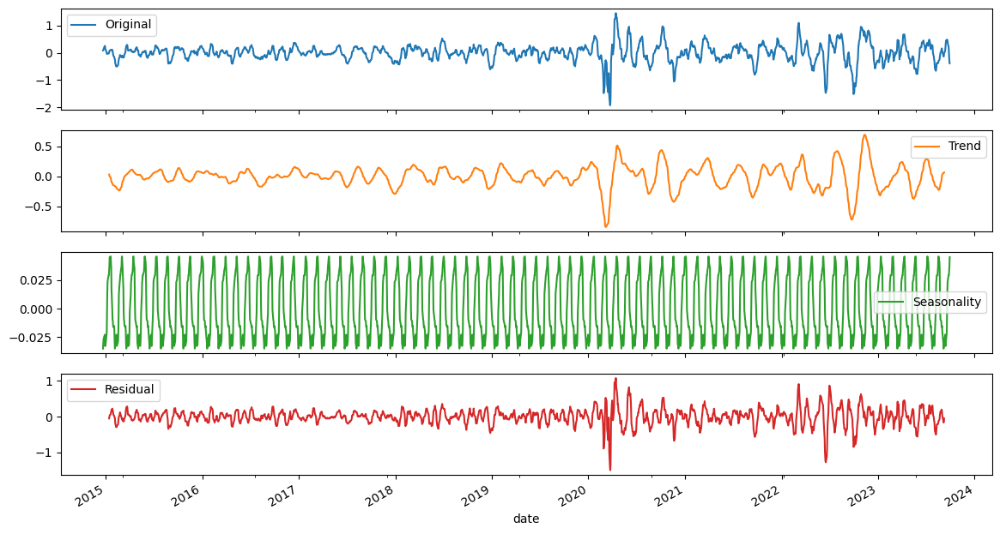

Plot trend_sma_fast_AEP
False


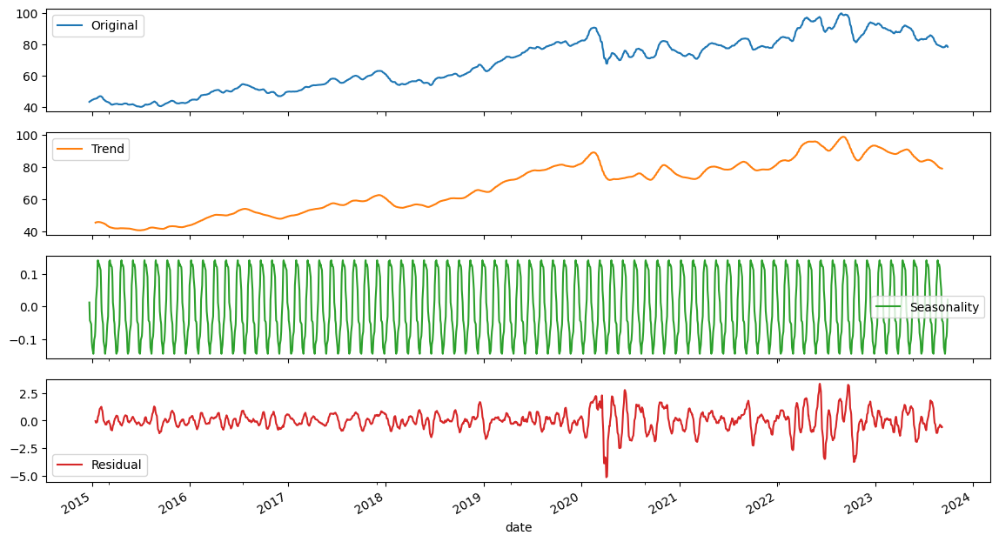

Plot trend_sma_slow_AEP
False


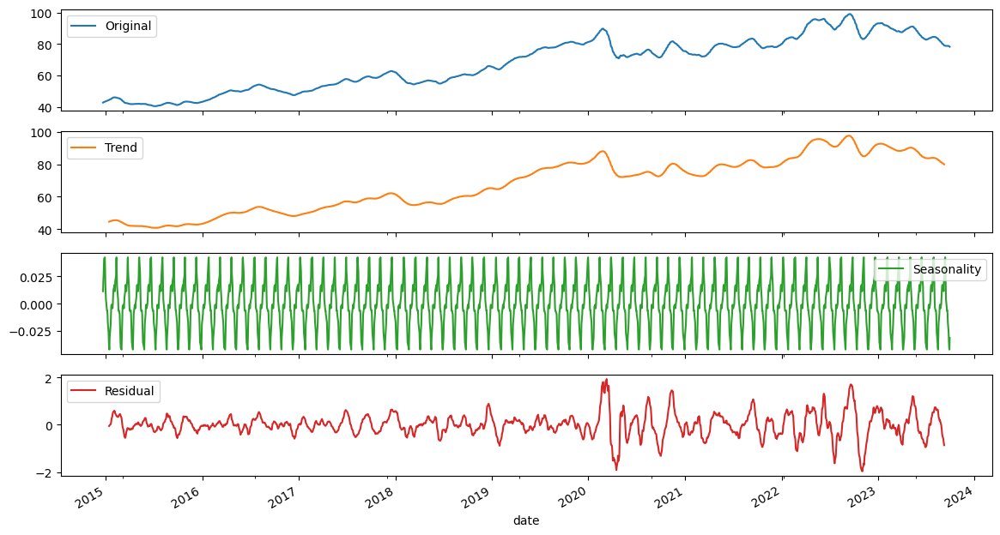

Plot trend_ema_fast_AEP
False


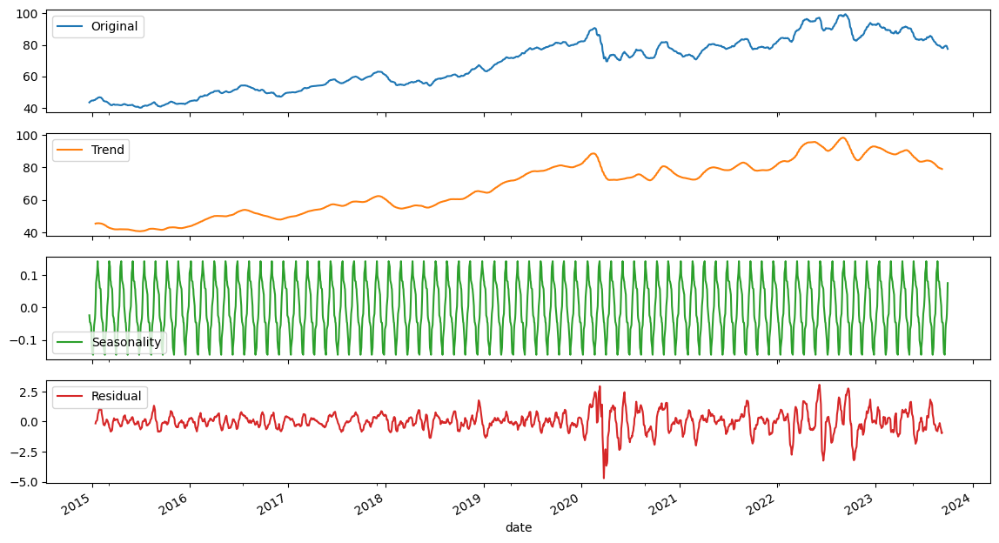

Plot trend_ema_slow_AEP
False


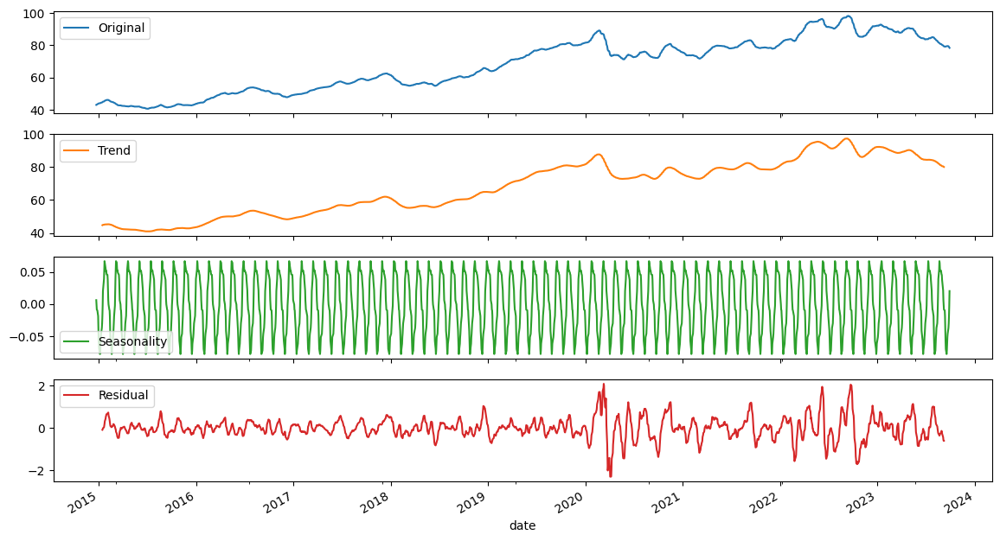

Plot trend_vortex_ind_pos_AEP
True


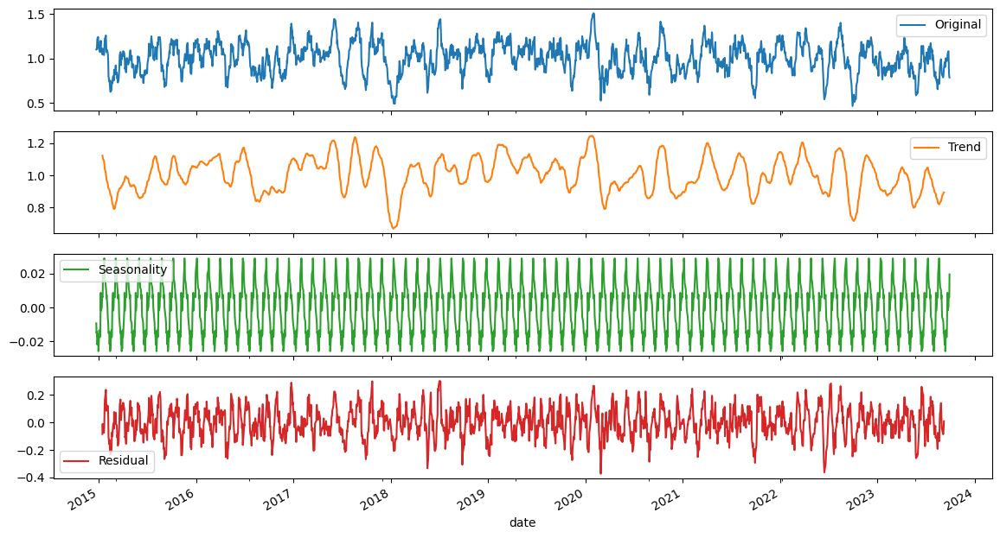

Plot trend_vortex_ind_neg_AEP
True


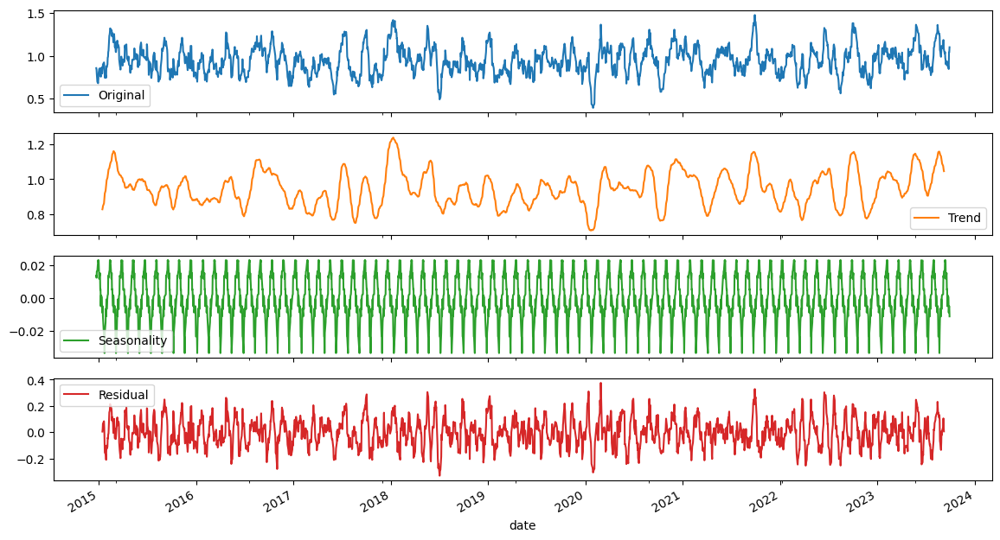

Plot trend_vortex_ind_diff_AEP
True


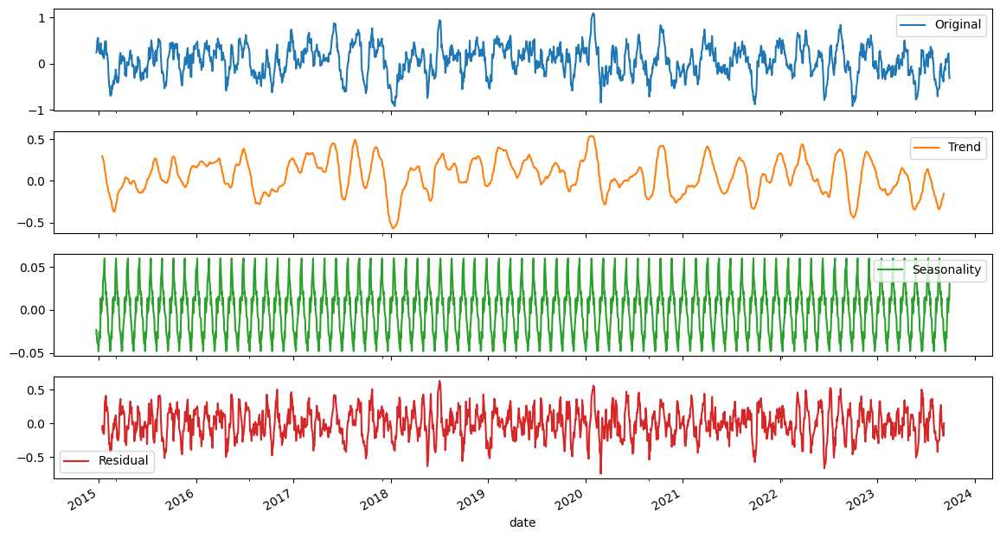

Plot trend_trix_AEP
True


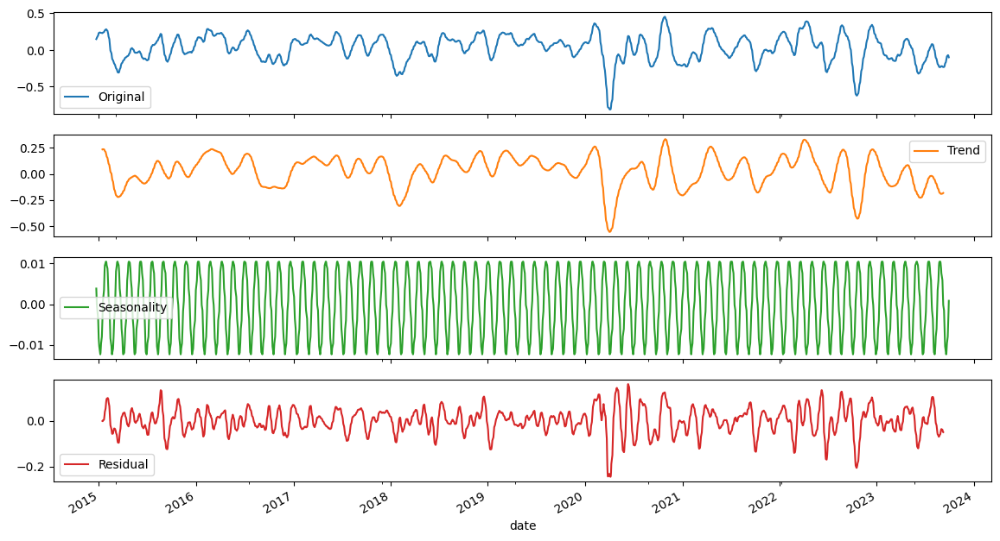

Plot trend_mass_index_AEP
True


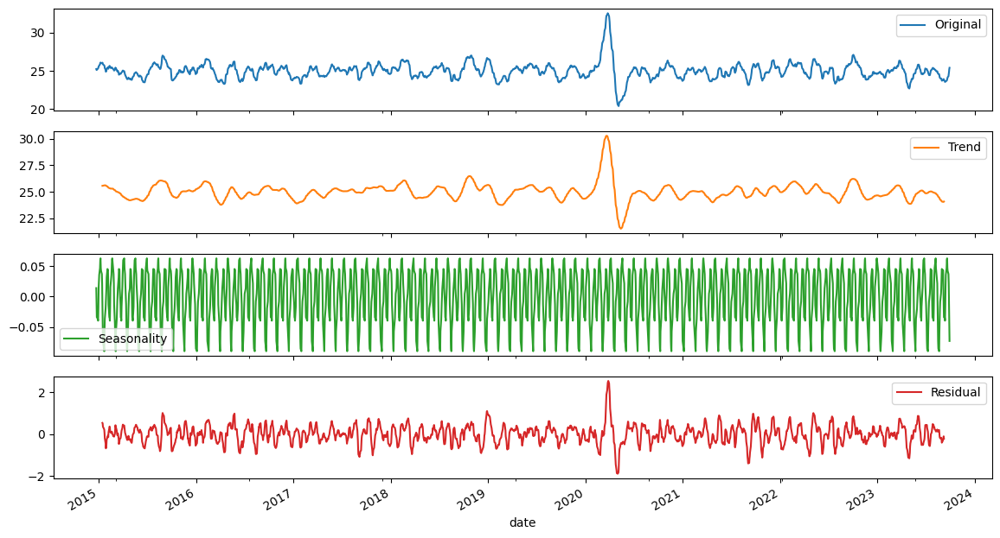

Plot trend_dpo_AEP
True


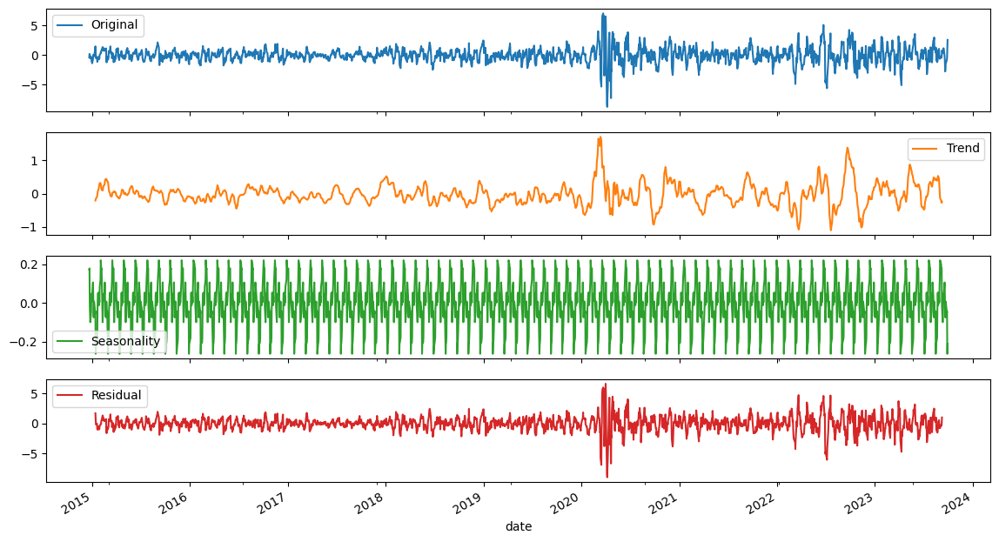

Plot trend_kst_AEP
True


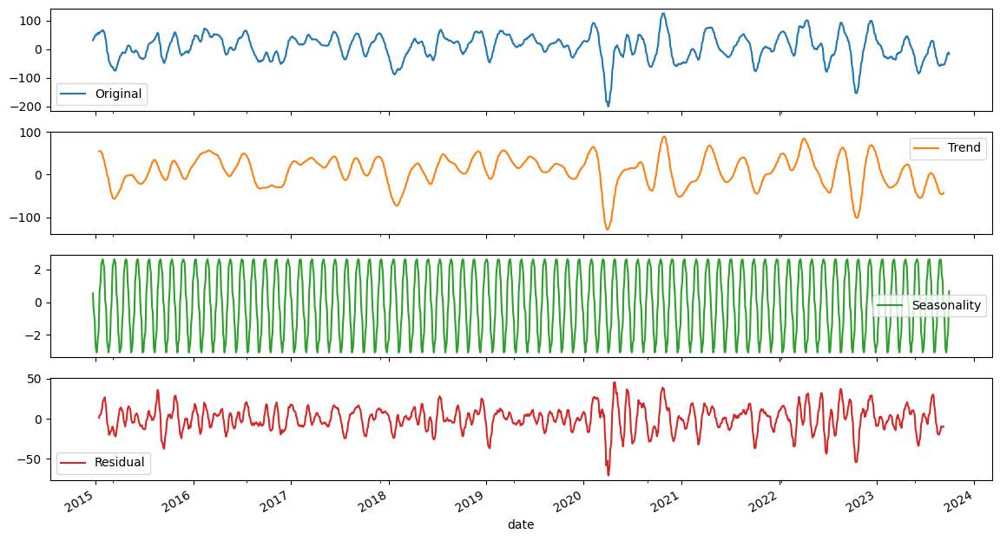

Plot trend_kst_sig_AEP
True


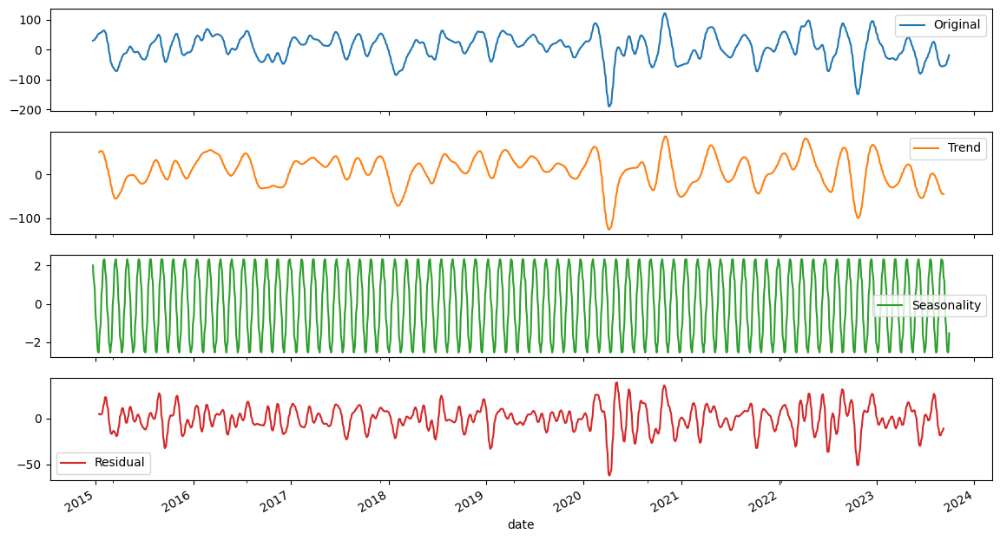

Plot trend_kst_diff_AEP
True


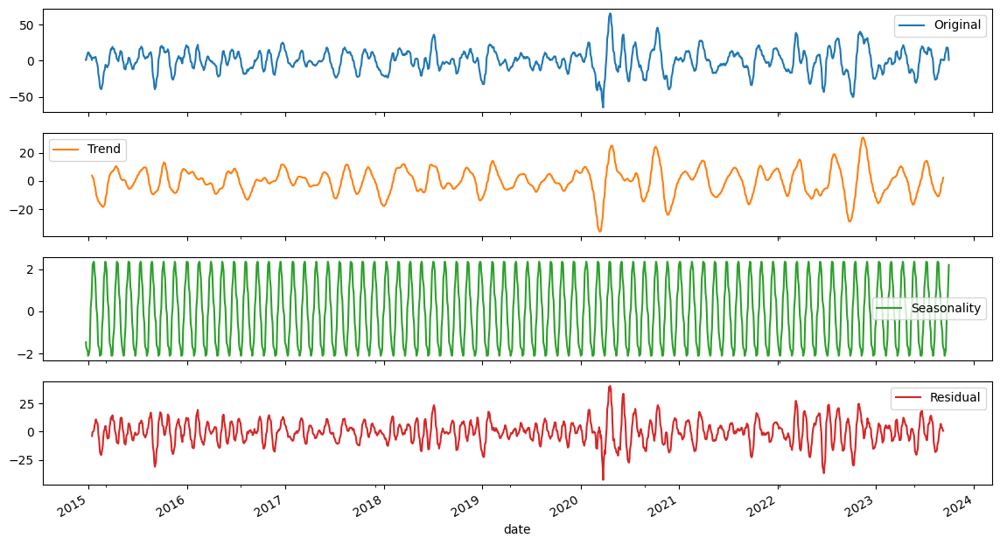

Plot trend_ichimoku_conv_AEP
False


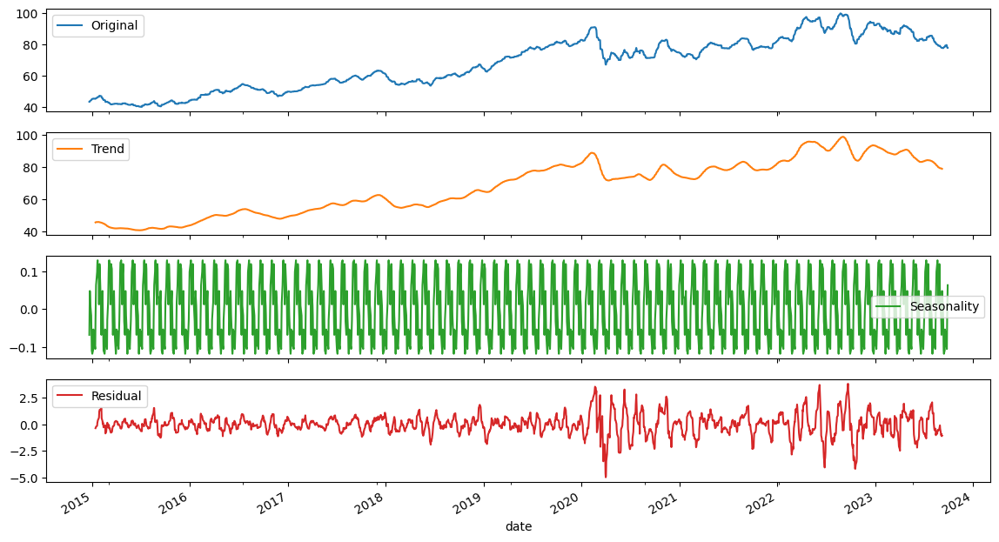

Plot trend_ichimoku_base_AEP
False


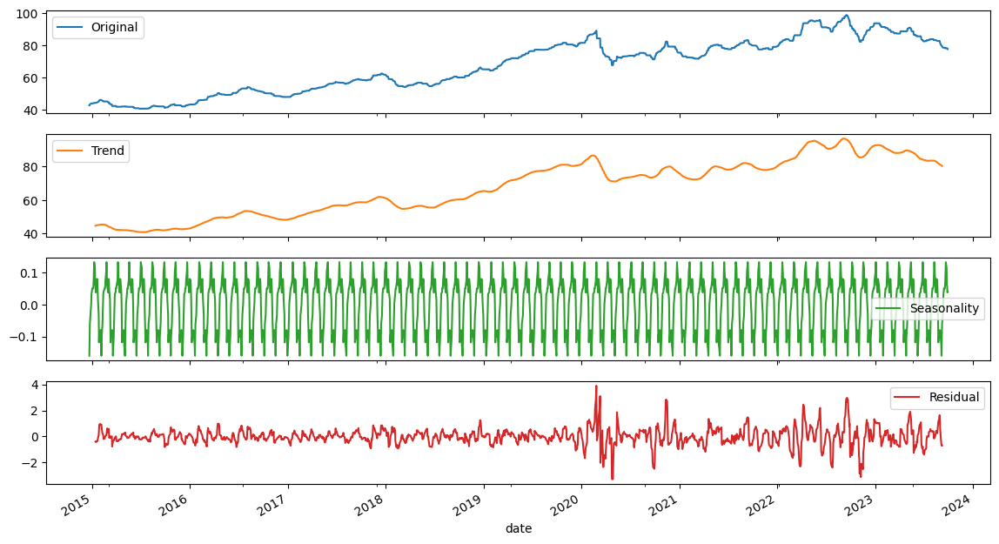

Plot trend_ichimoku_a_AEP
False


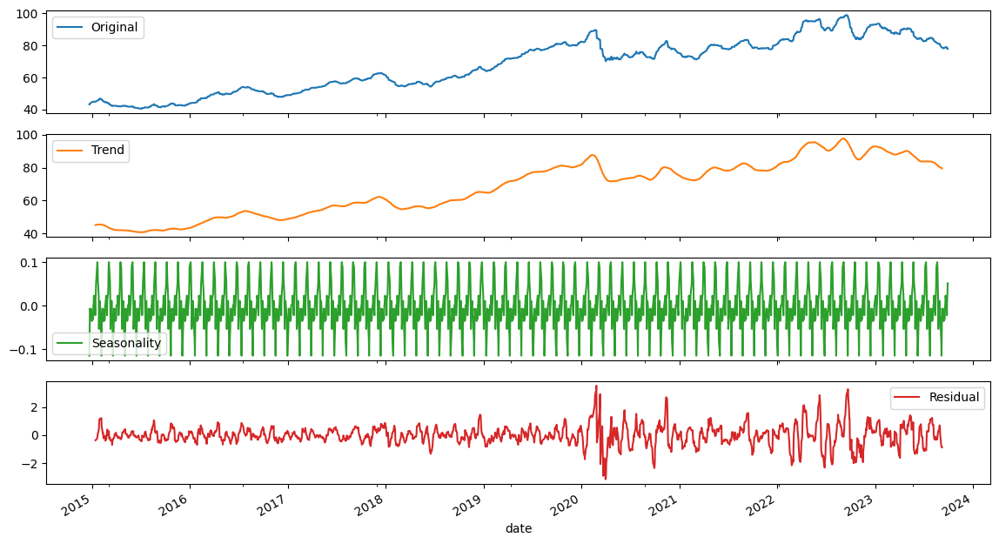

Plot trend_ichimoku_b_AEP
False


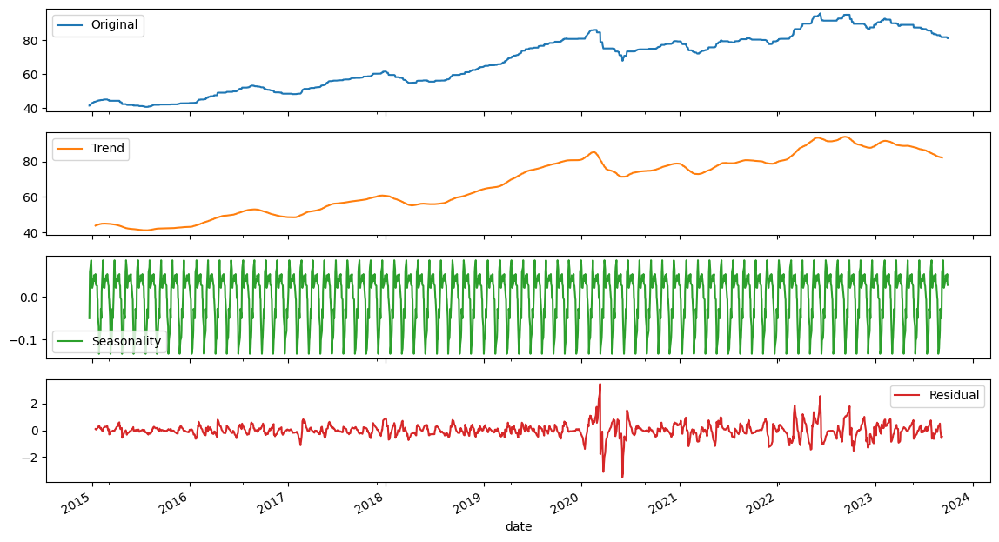

Plot trend_stc_AEP
True


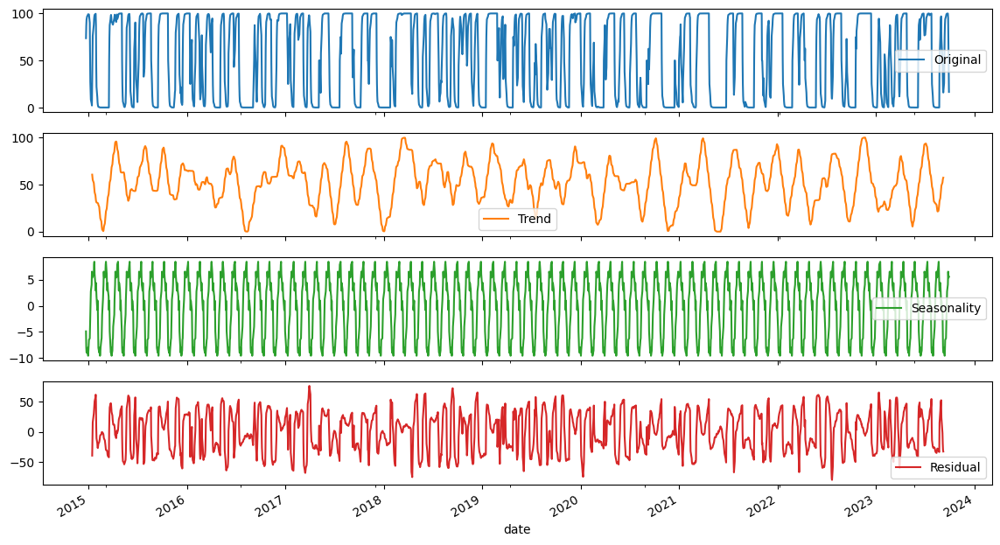

Plot trend_adx_AEP
True


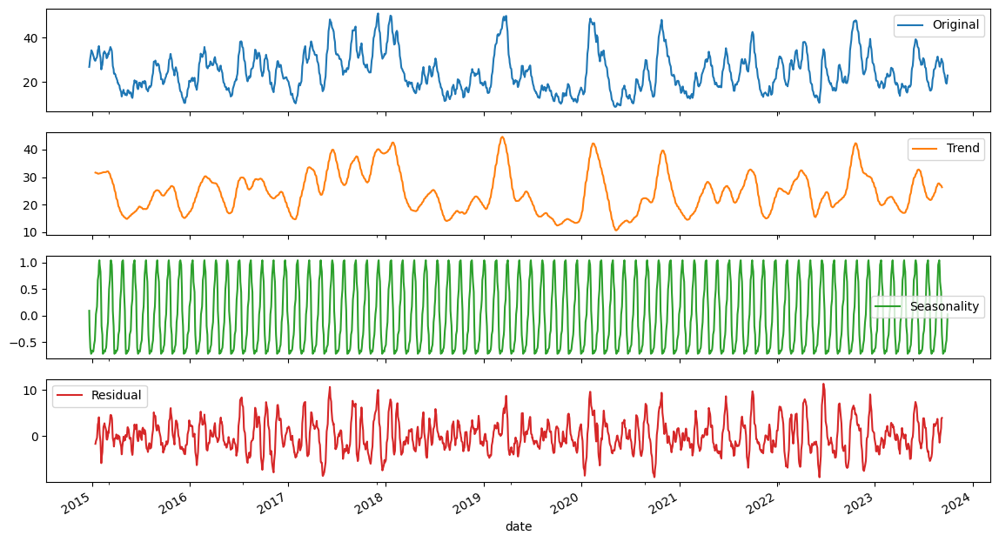

Plot trend_adx_pos_AEP
True


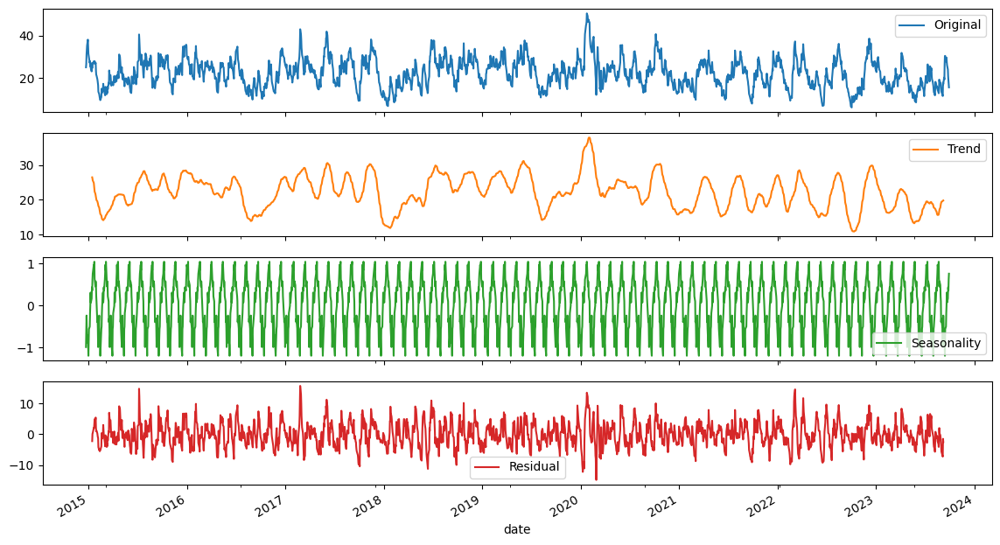

Plot trend_adx_neg_AEP
True


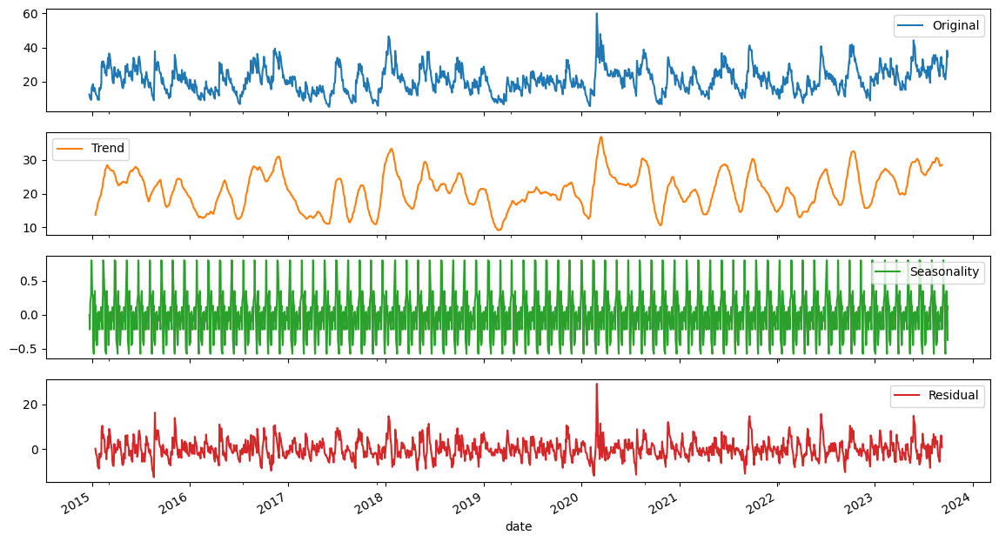

Plot trend_cci_AEP
True


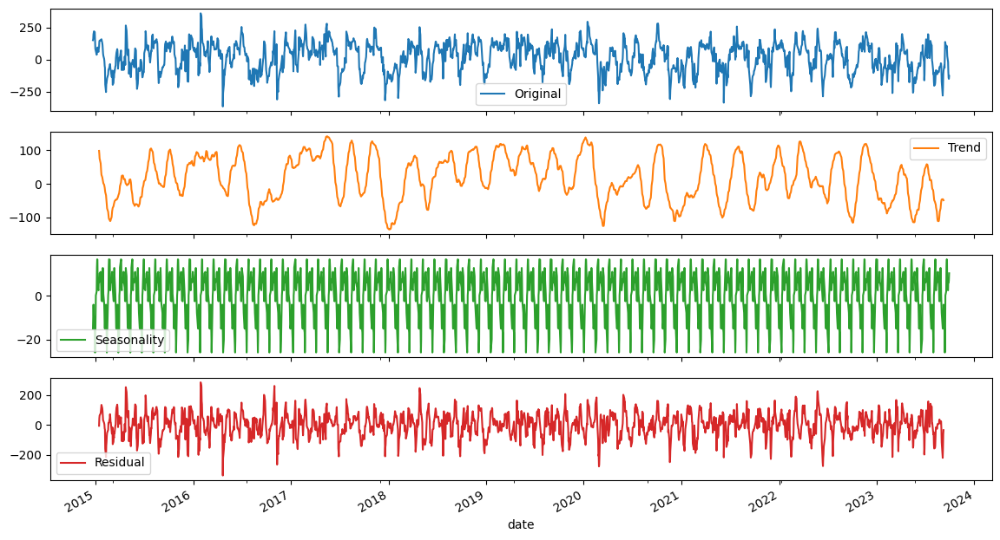

Plot trend_visual_ichimoku_a_AEP
False


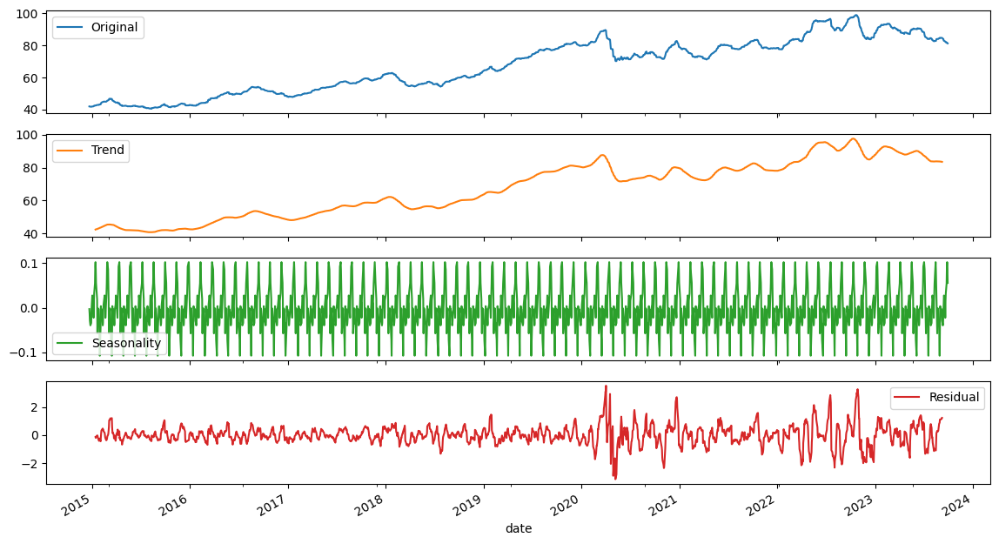

Plot trend_visual_ichimoku_b_AEP
False


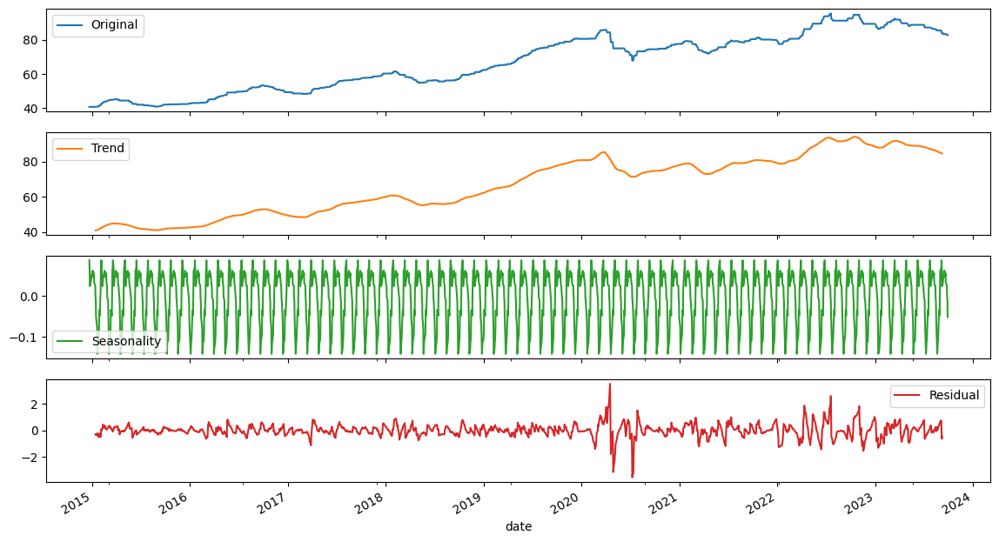

Plot trend_aroon_up_AEP
True


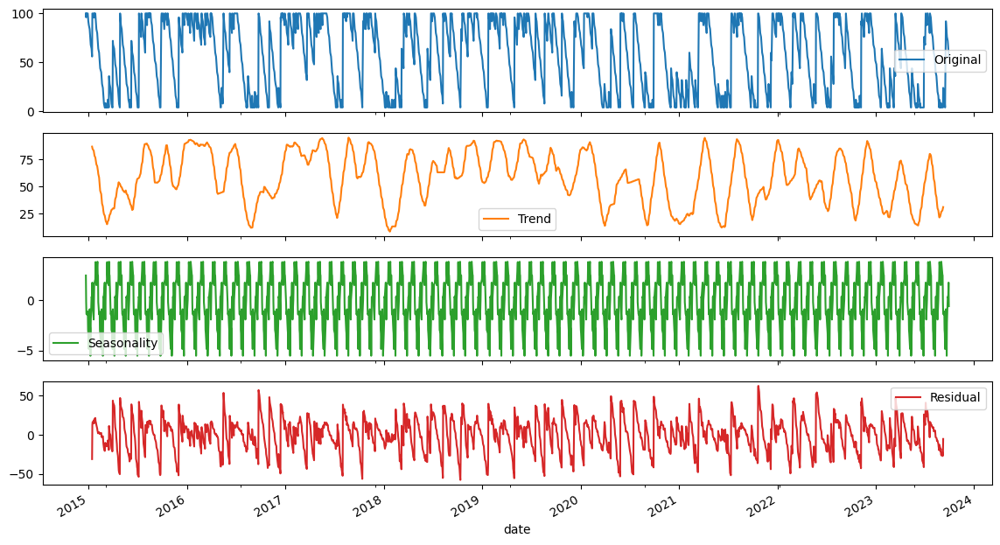

Plot trend_aroon_down_AEP
True


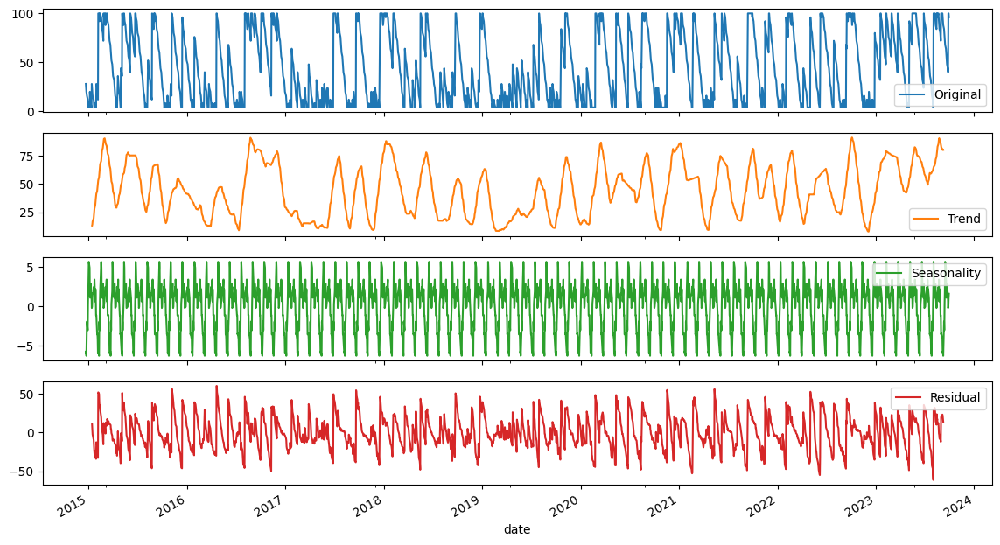

Plot trend_aroon_ind_AEP
True


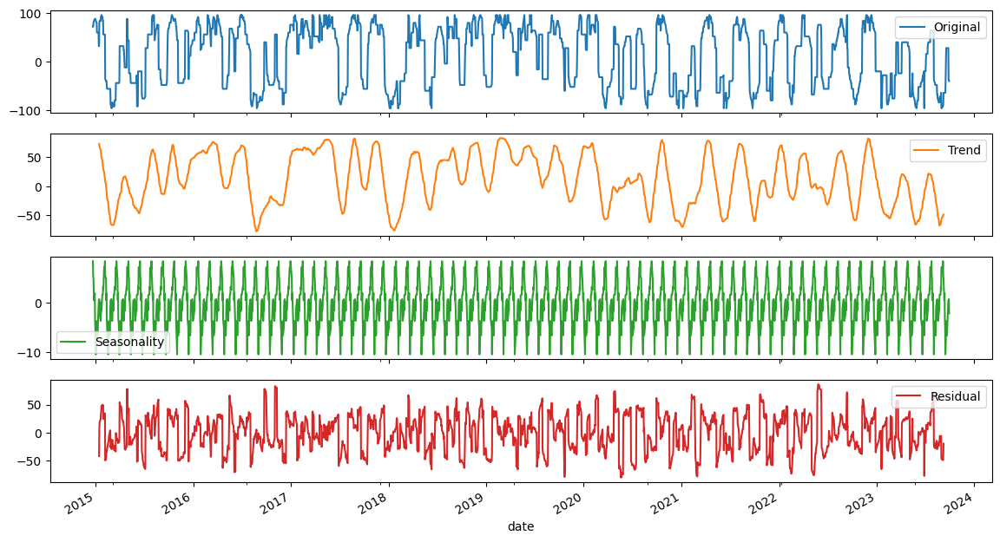

Plot trend_psar_up_AEP
False


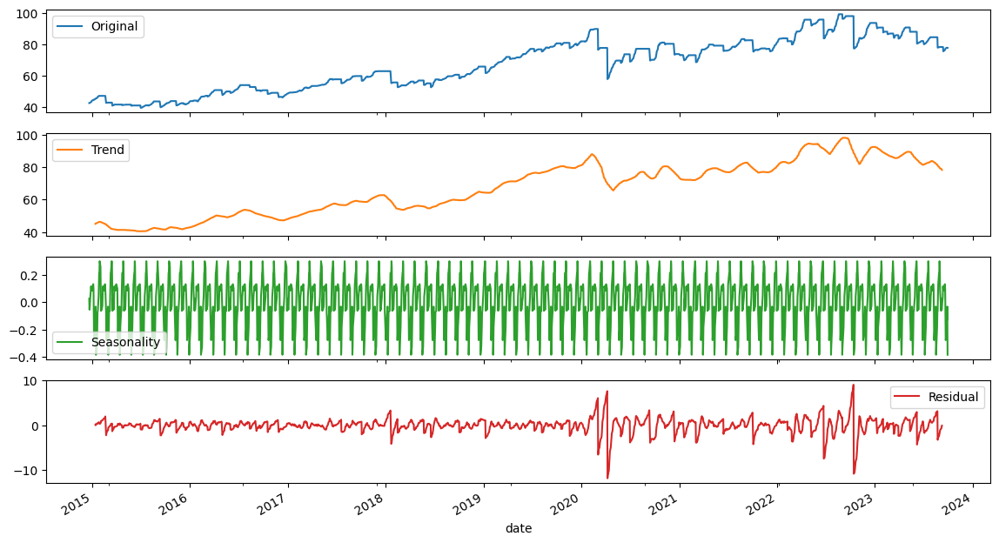

Plot trend_psar_down_AEP
False


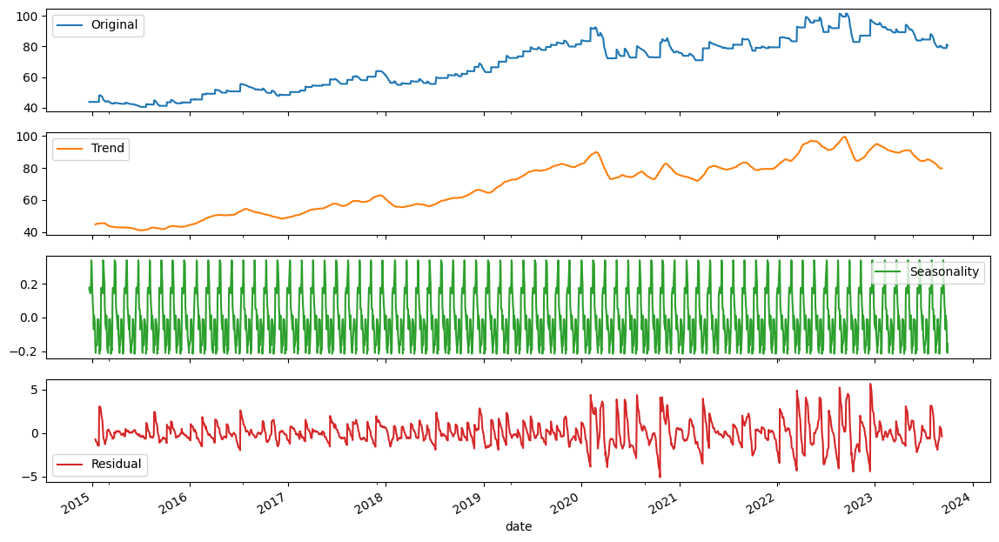

Plot trend_psar_up_indicator_AEP
True


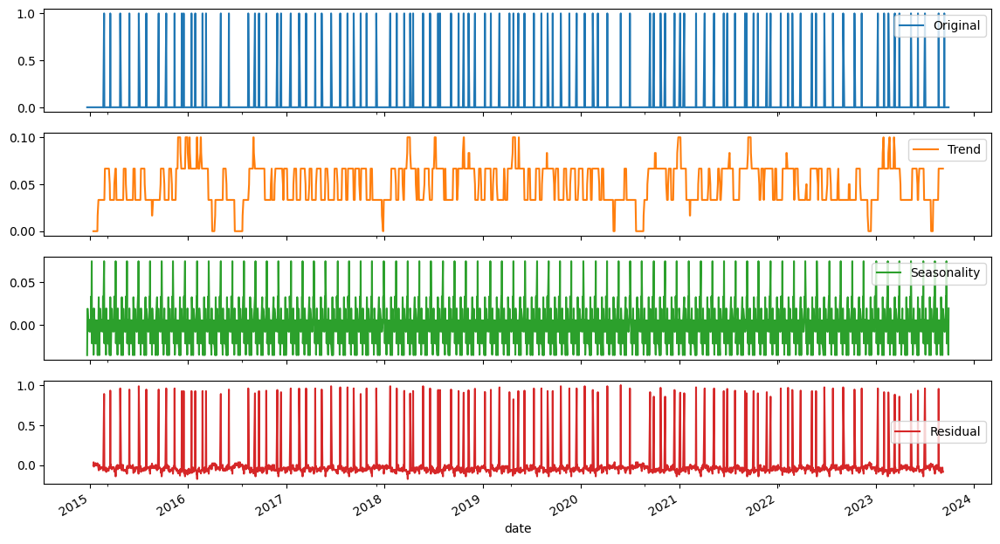

Plot trend_psar_down_indicator_AEP
True


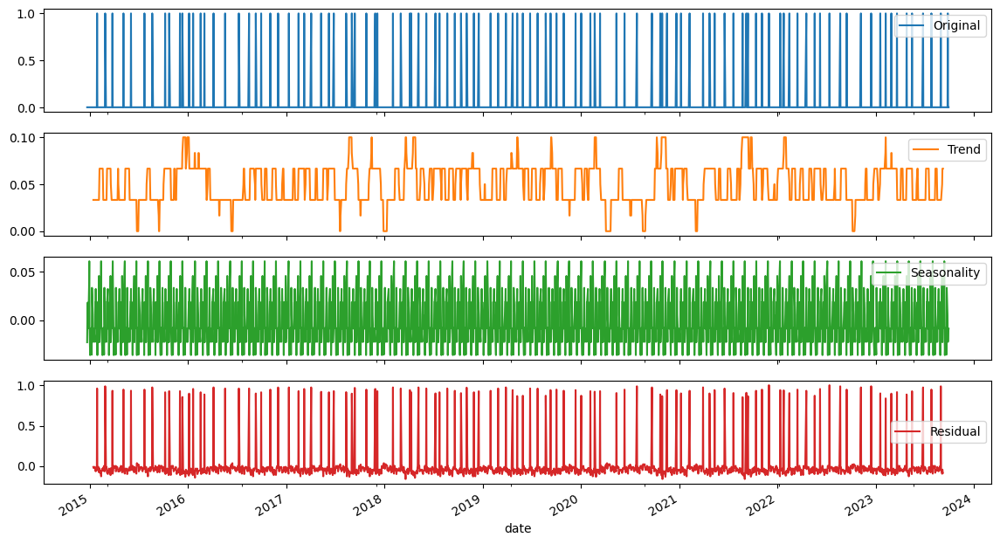

Plot momentum_rsi_AEP
True


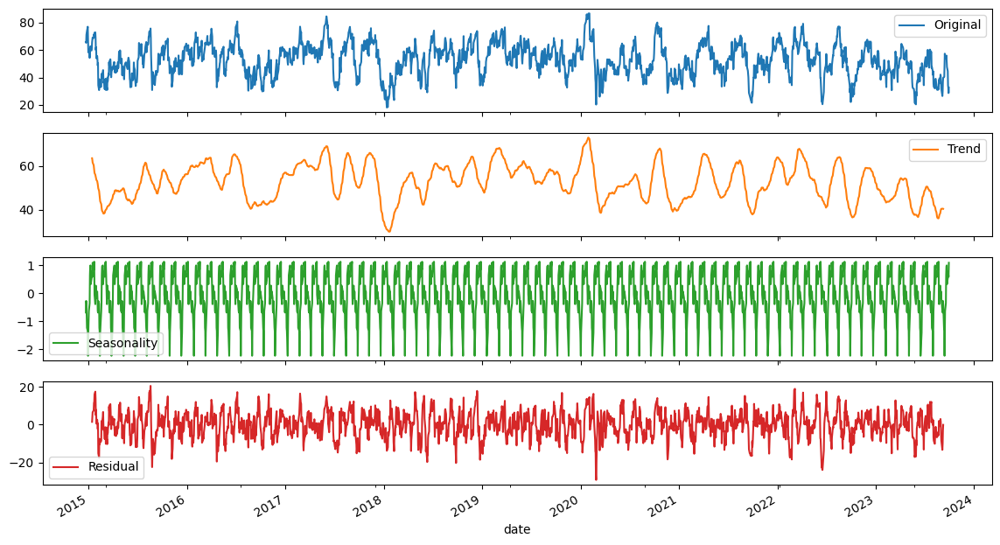

Plot momentum_stoch_rsi_AEP
True


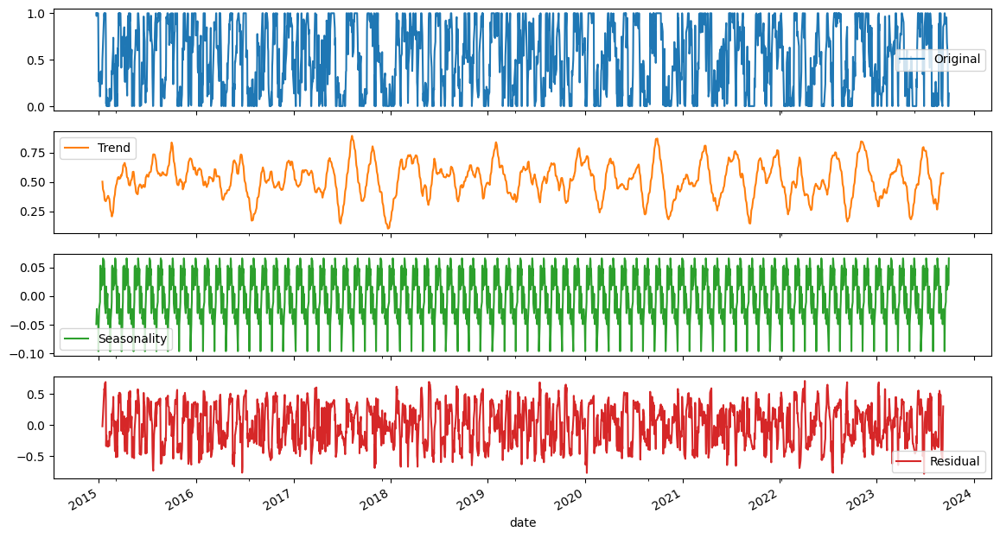

Plot momentum_stoch_rsi_k_AEP
True


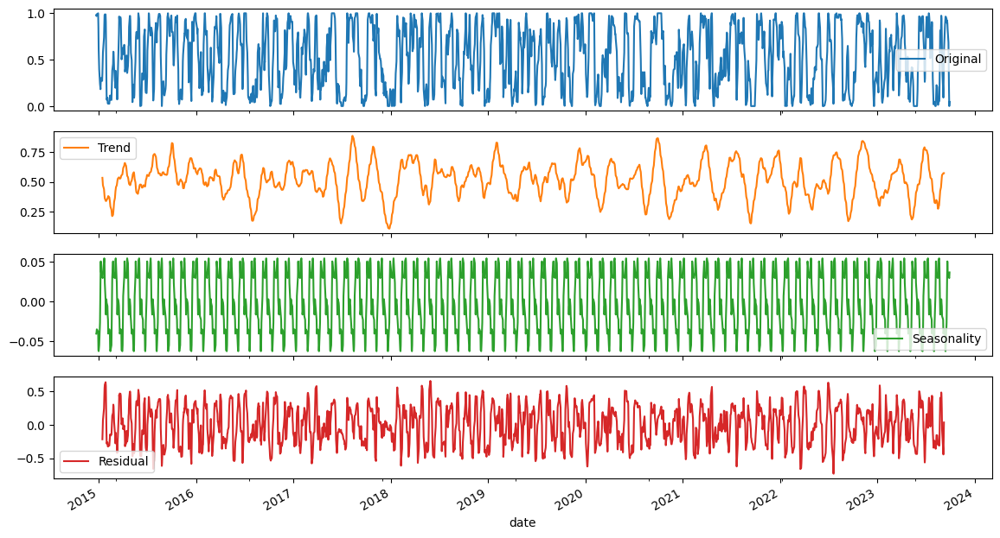

Plot momentum_stoch_rsi_d_AEP
True


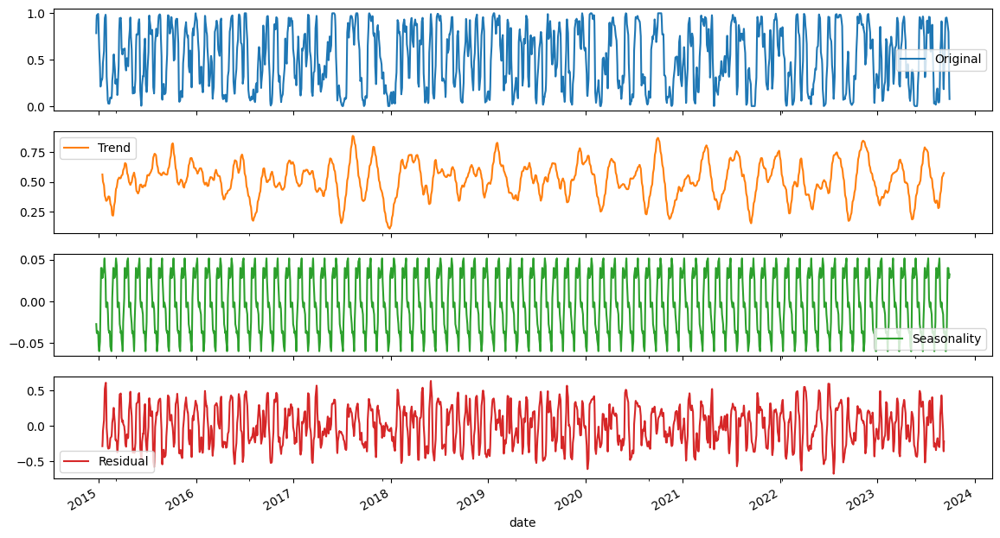

Plot momentum_tsi_AEP
True


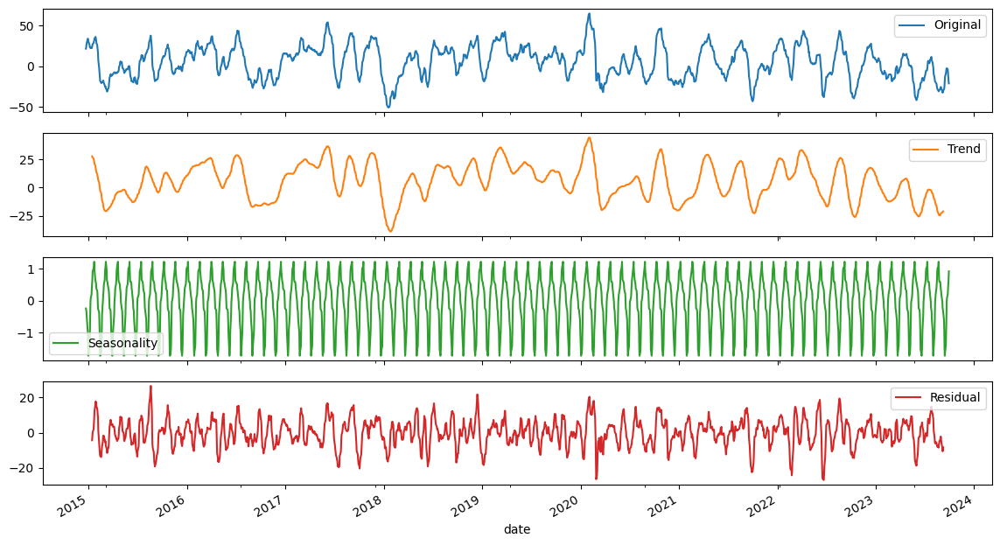

Plot momentum_uo_AEP
True


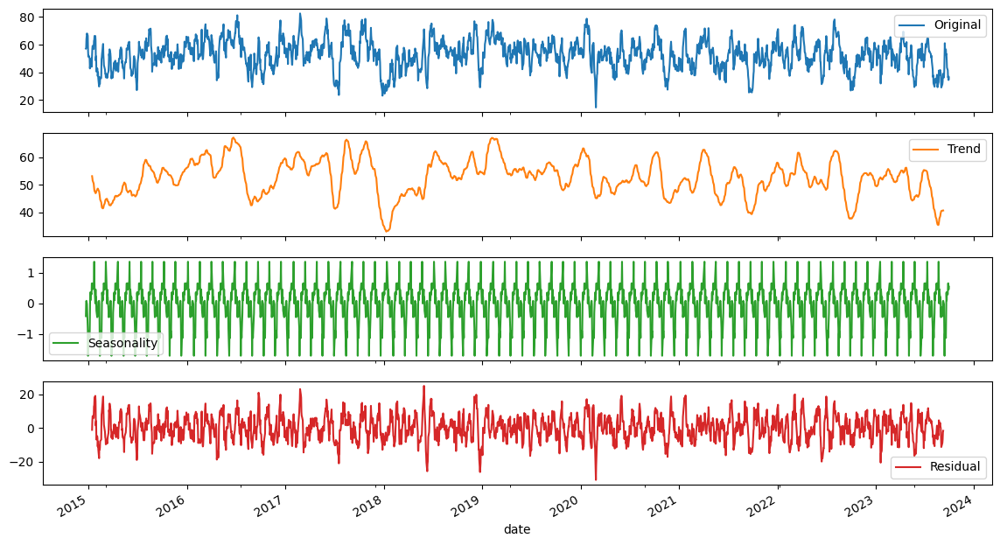

Plot momentum_stoch_AEP
True


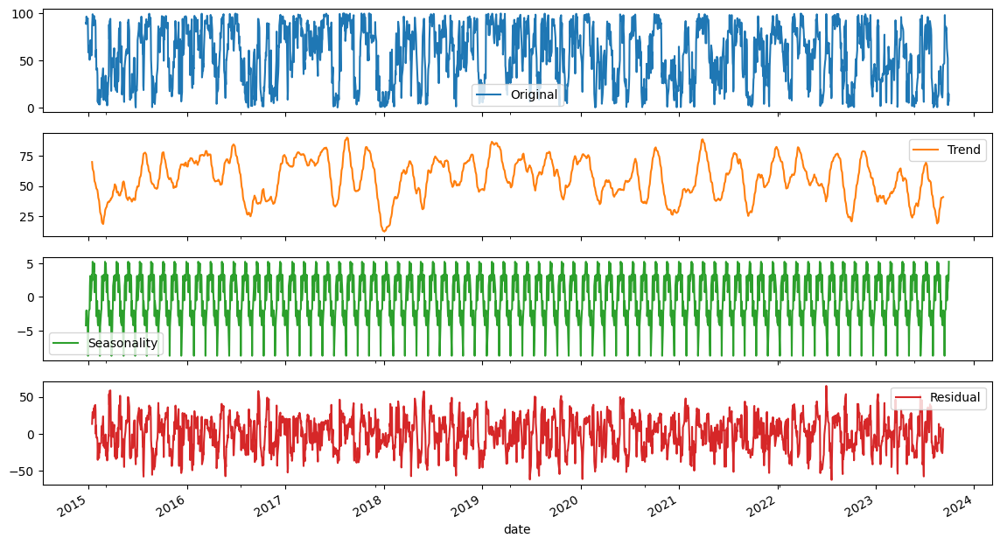

Plot momentum_stoch_signal_AEP
True


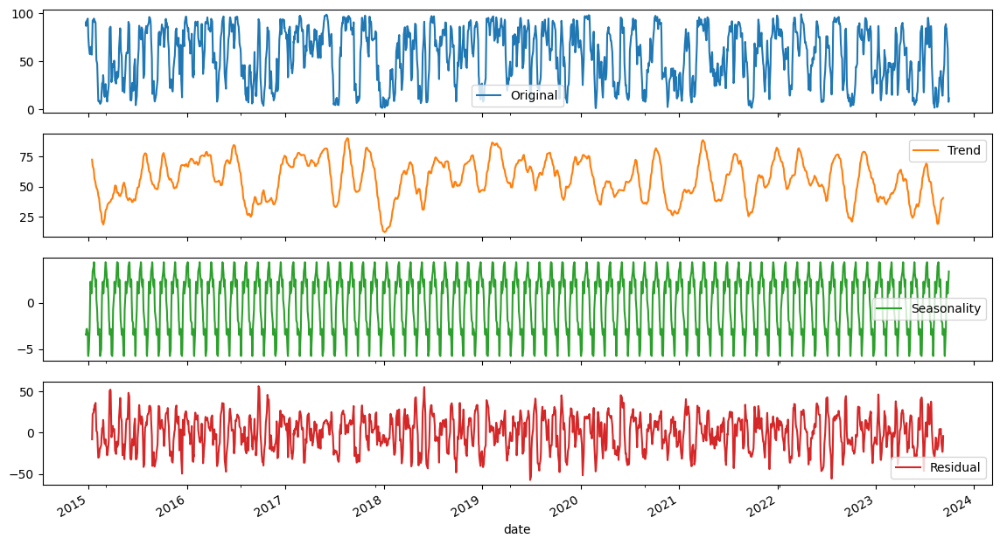

Plot momentum_wr_AEP
True


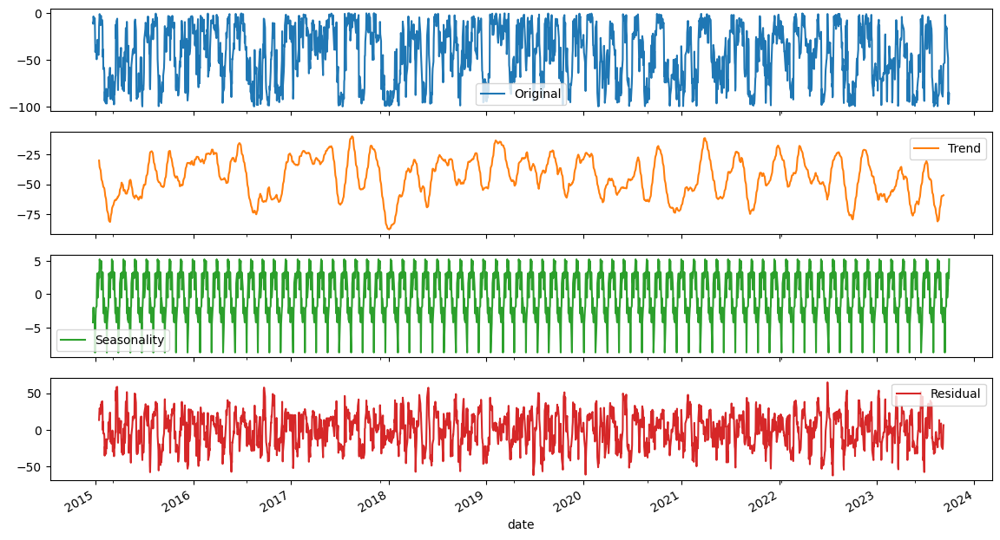

Plot momentum_ao_AEP
True


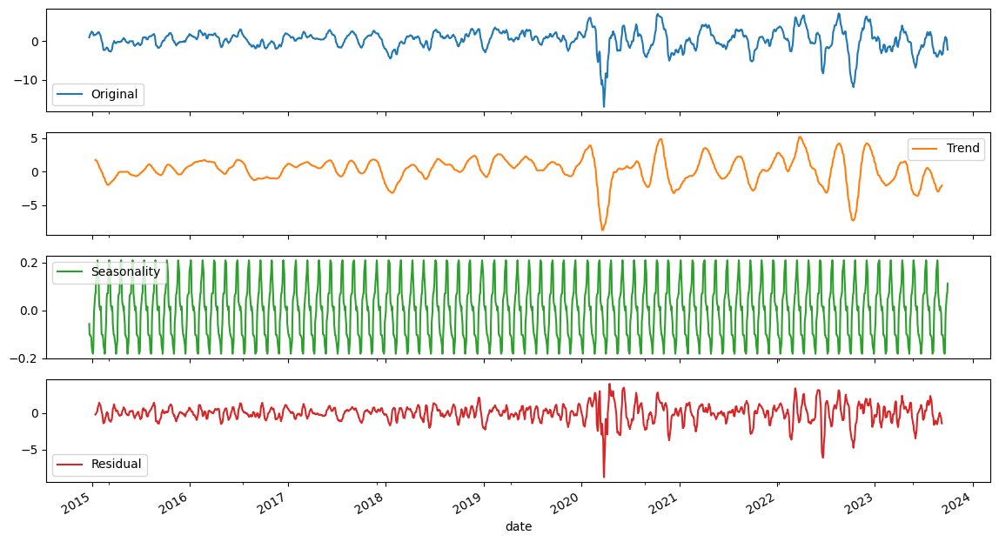

Plot momentum_roc_AEP
True


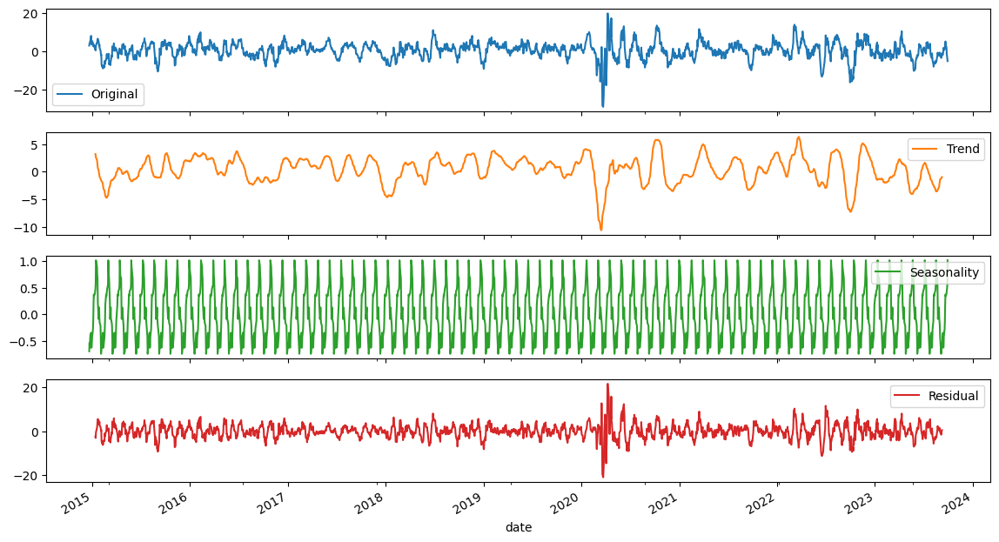

Plot momentum_ppo_AEP
True


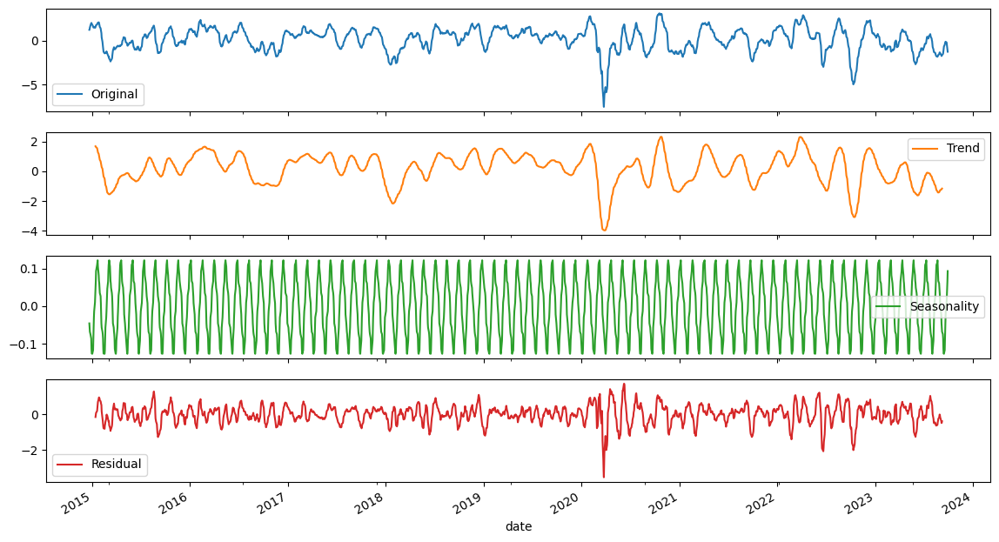

Plot momentum_ppo_signal_AEP
True


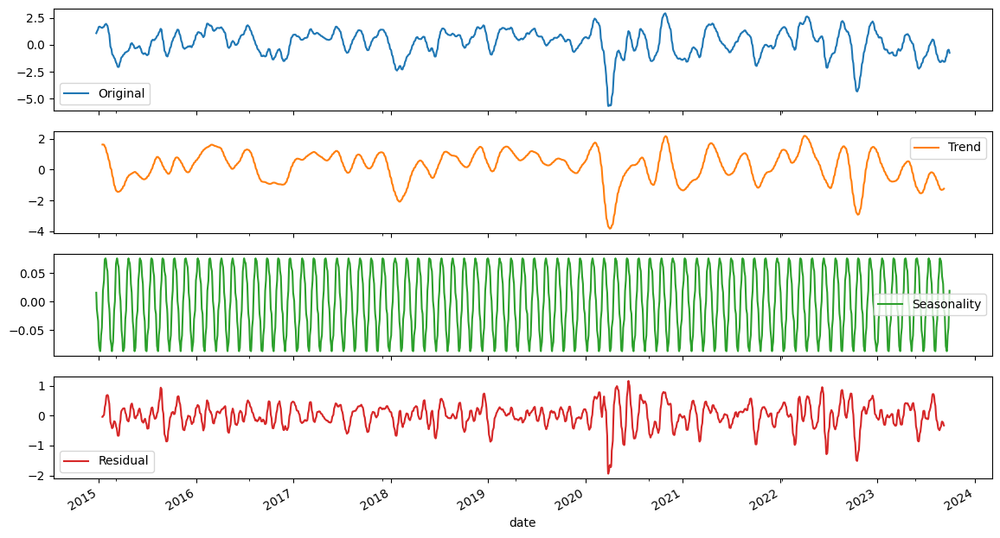

Plot momentum_ppo_hist_AEP
True


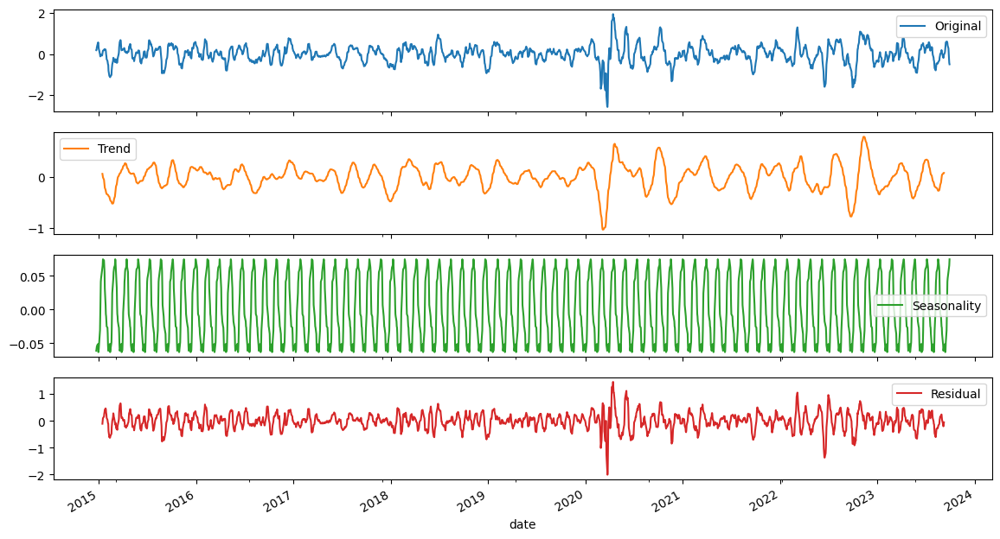

Plot momentum_pvo_AEP
True


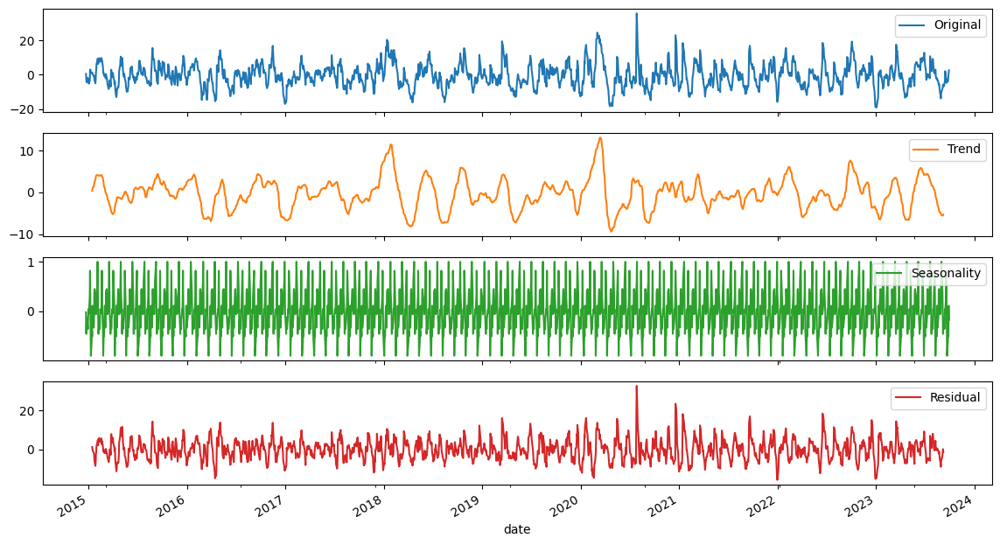

Plot momentum_pvo_signal_AEP
True


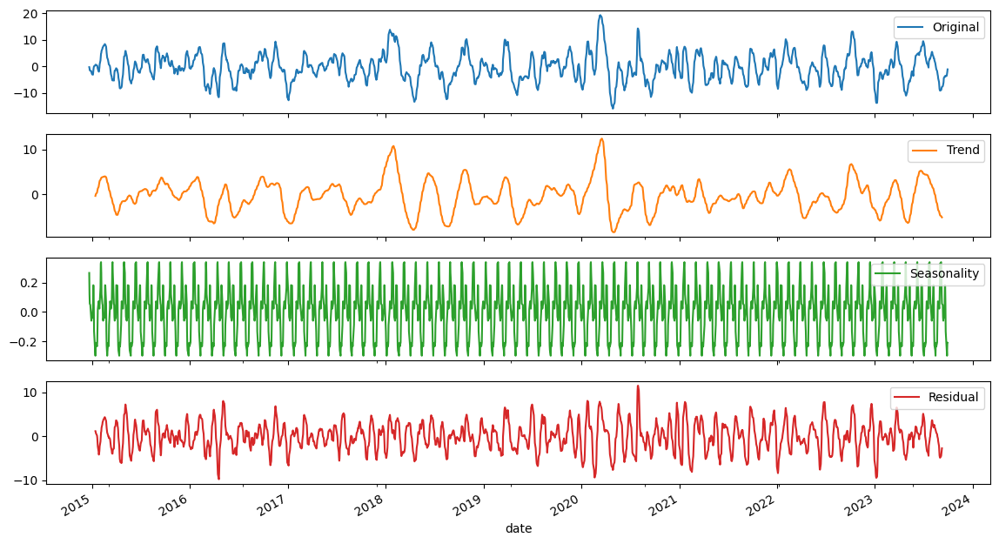

Plot momentum_pvo_hist_AEP
True


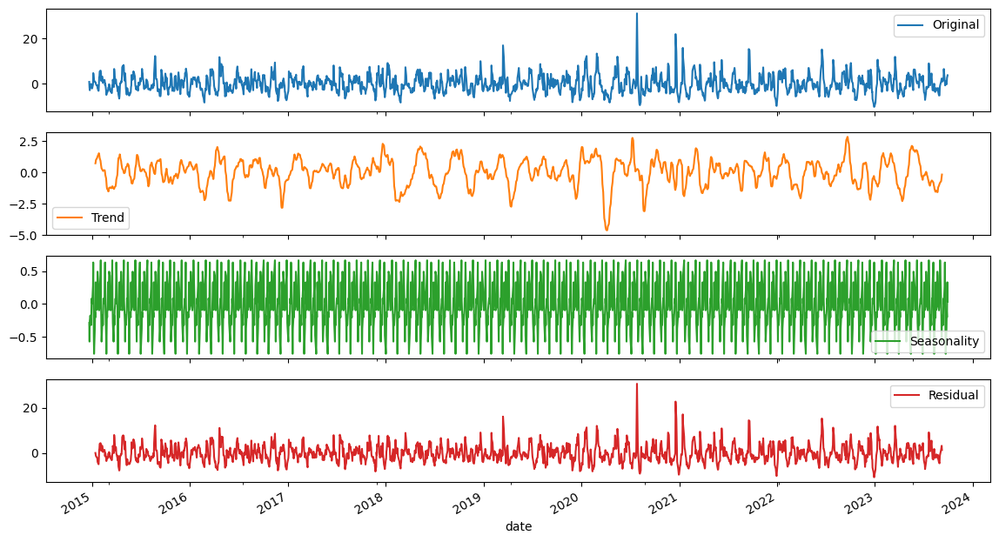

Plot momentum_kama_AEP
False


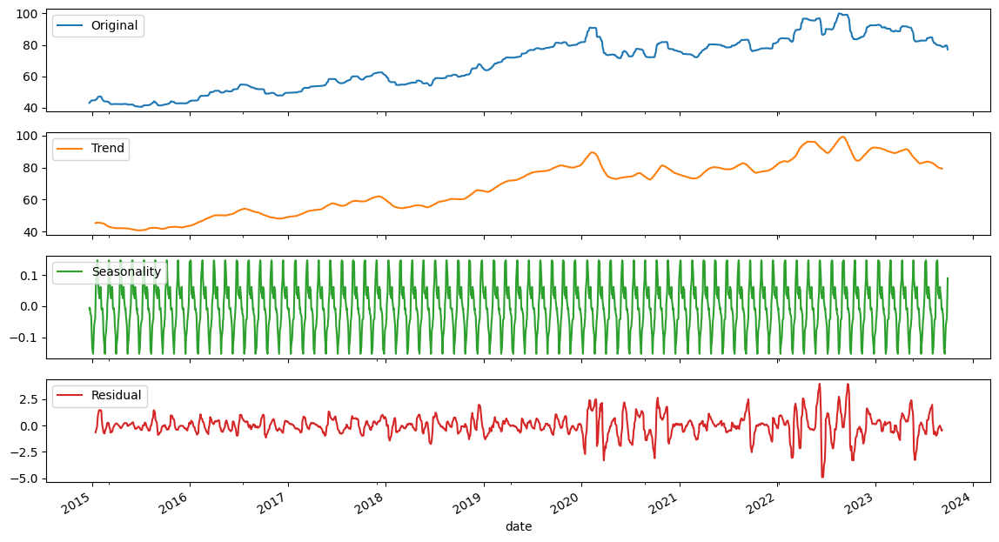

Plot others_dr_AEP
True


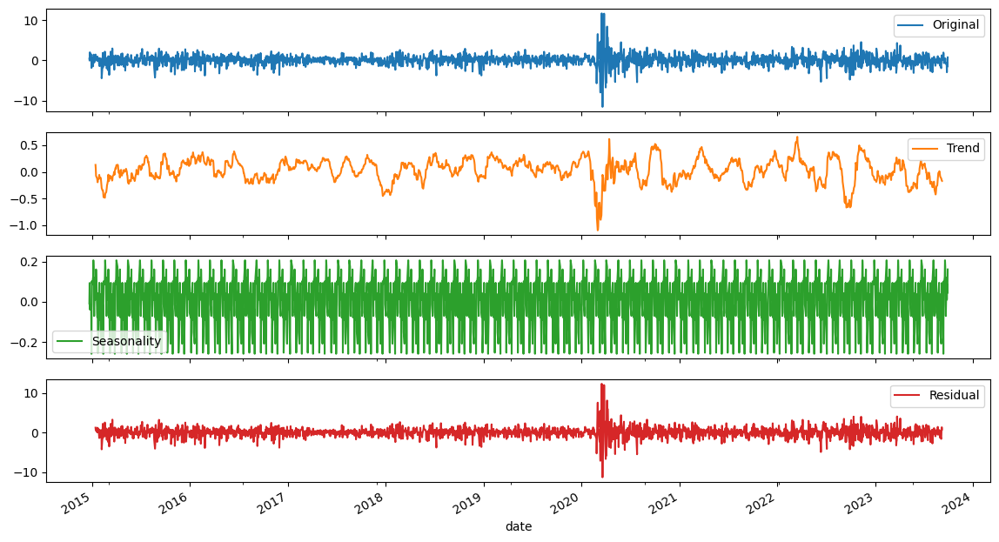

Plot others_dlr_AEP
True


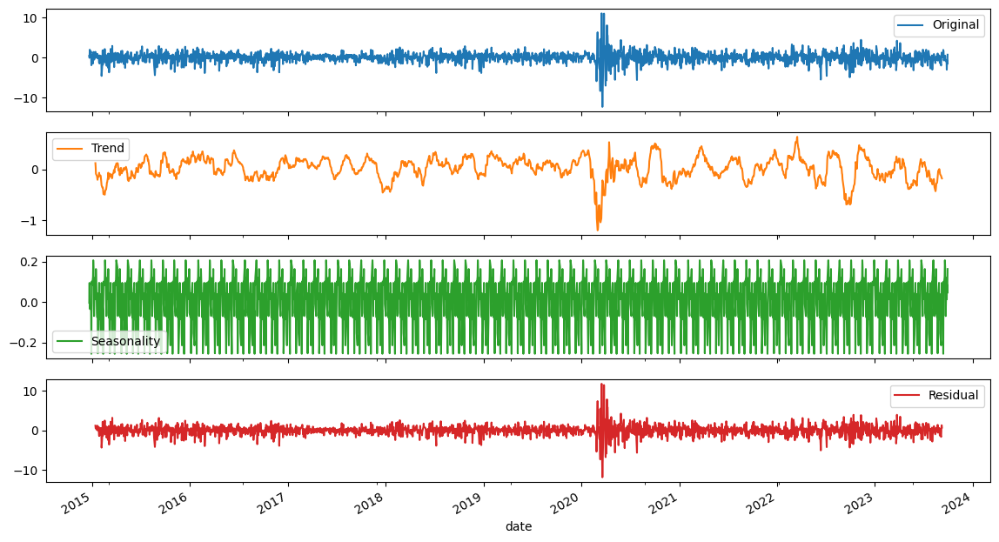

Plot others_cr_AEP
False


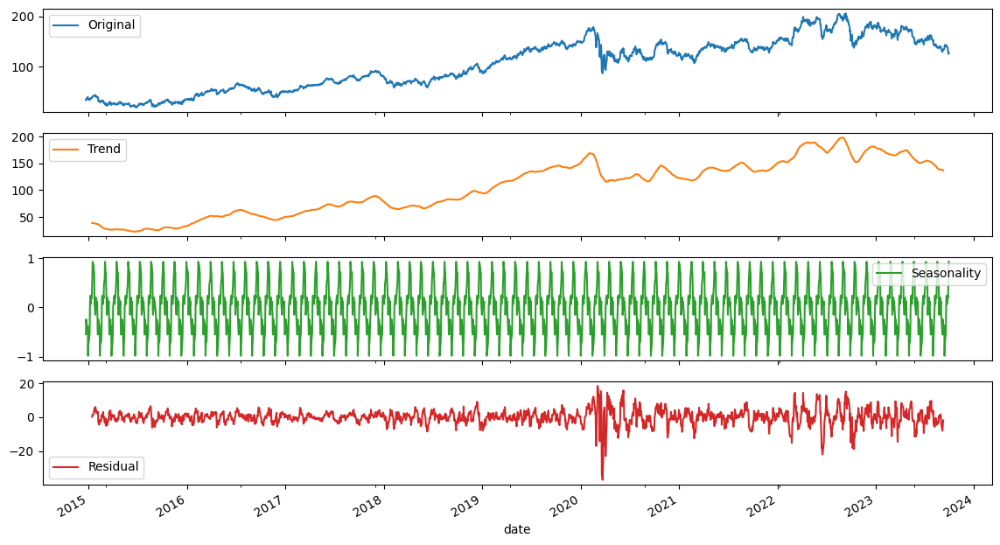

Plot close_diff_1_AEP
True


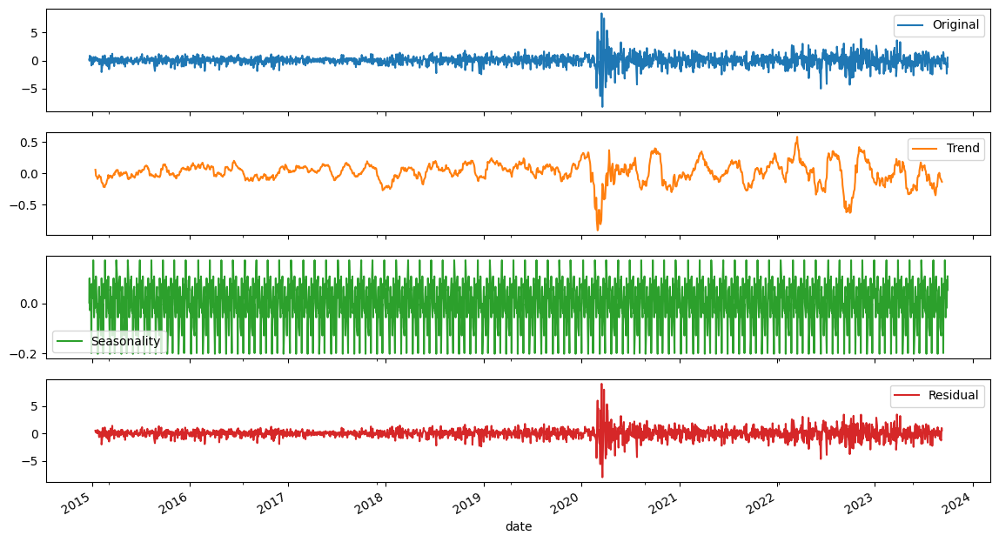

Plot close_diff_5_AEP
True


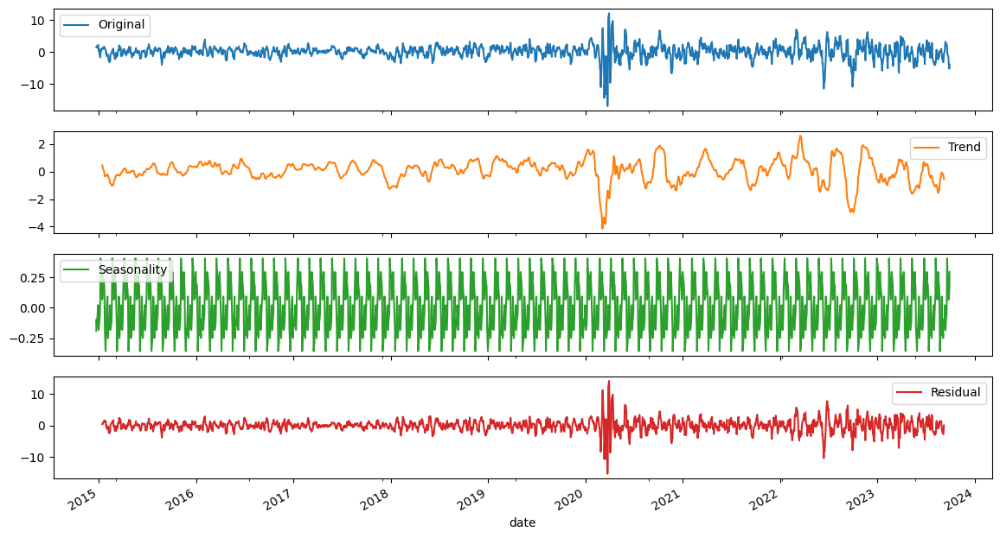

Plot close_diff_20_AEP
True


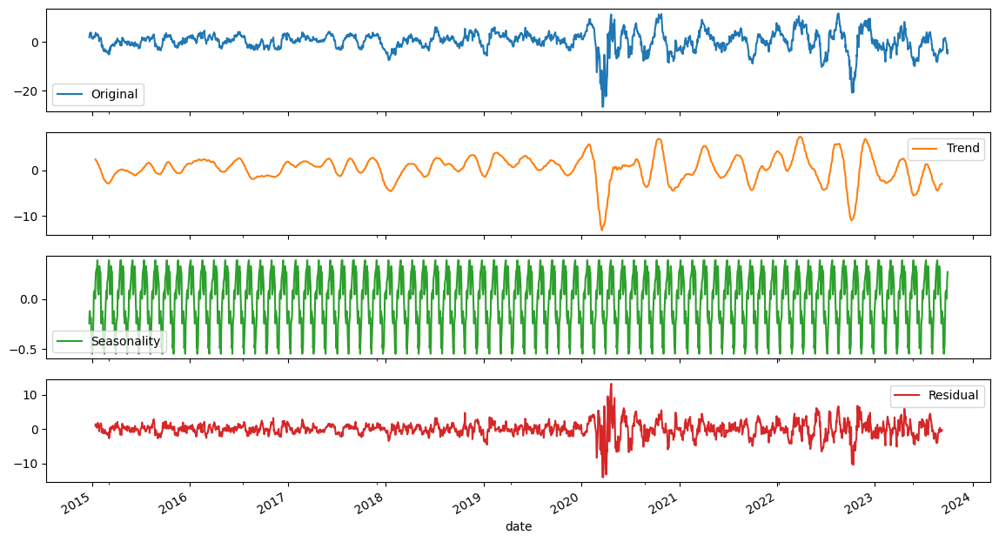

Plot close_diff_252_AEP
True


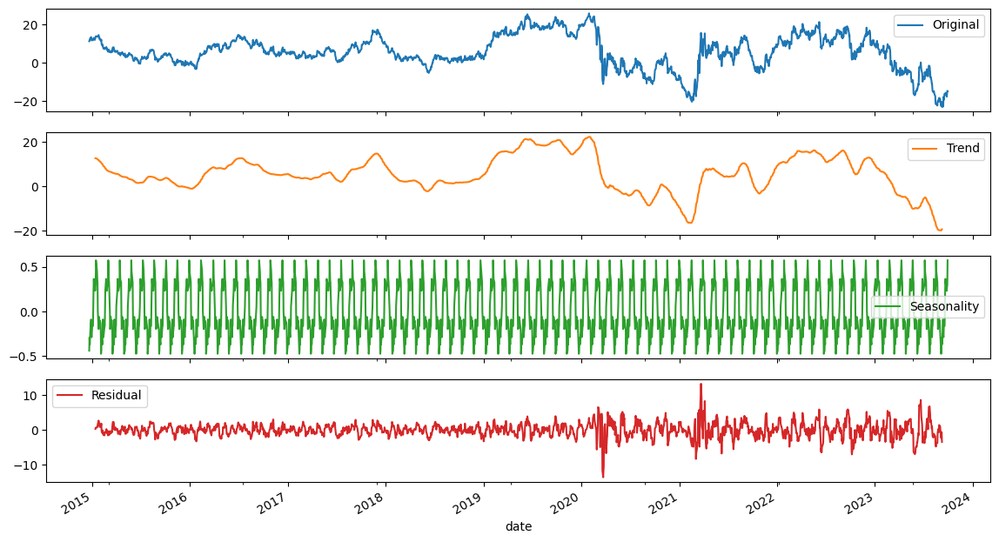

Plot high_diff_1_AEP
True


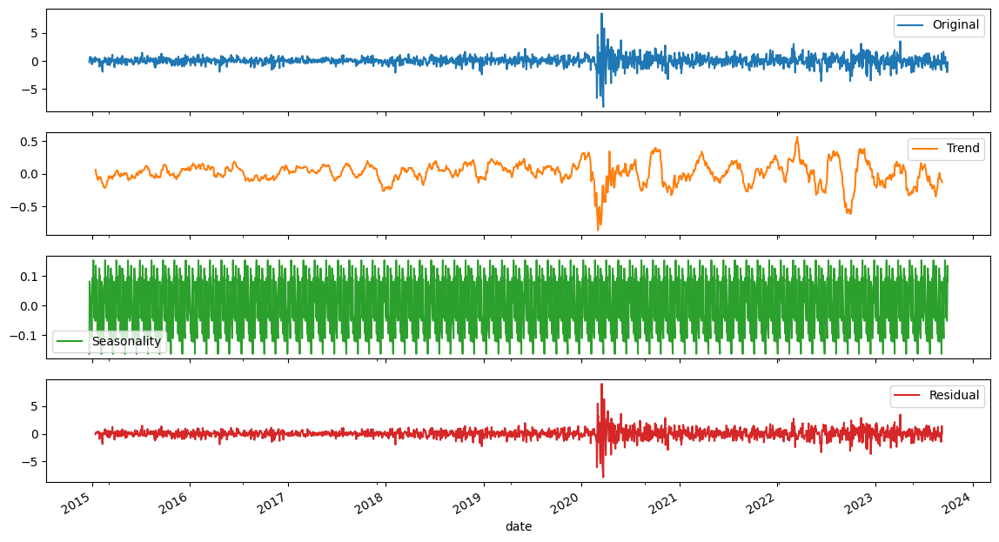

Plot high_diff_5_AEP
True


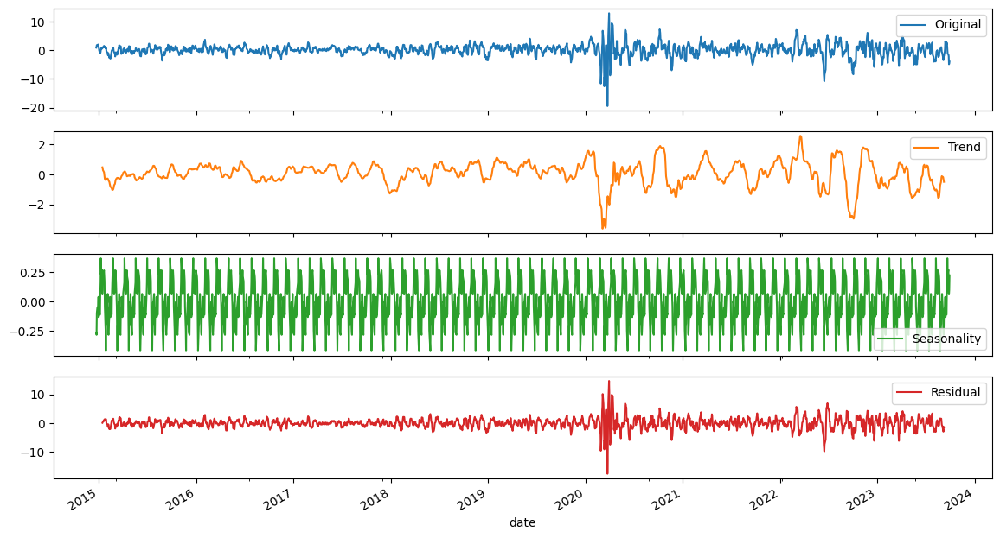

Plot high_diff_20_AEP
True


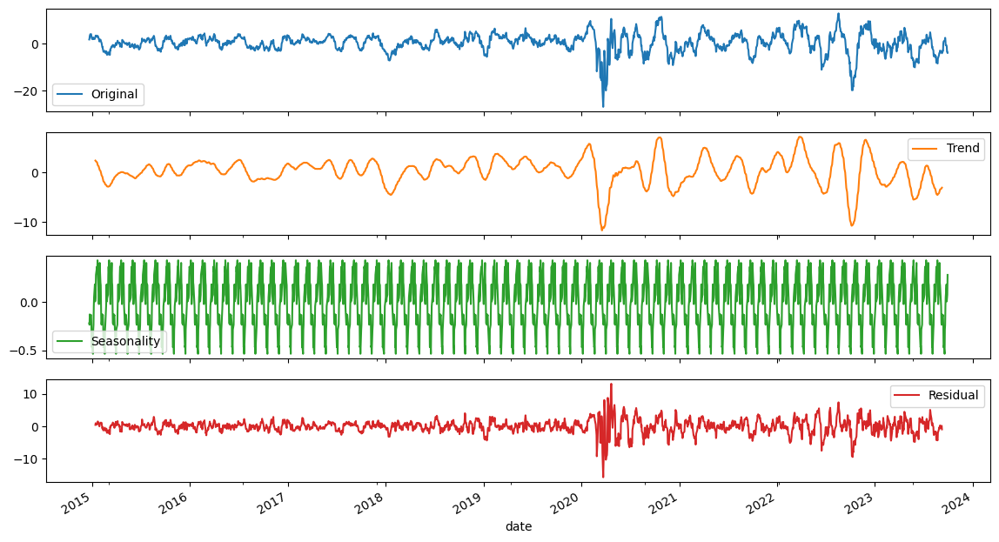

Plot high_diff_252_AEP
True


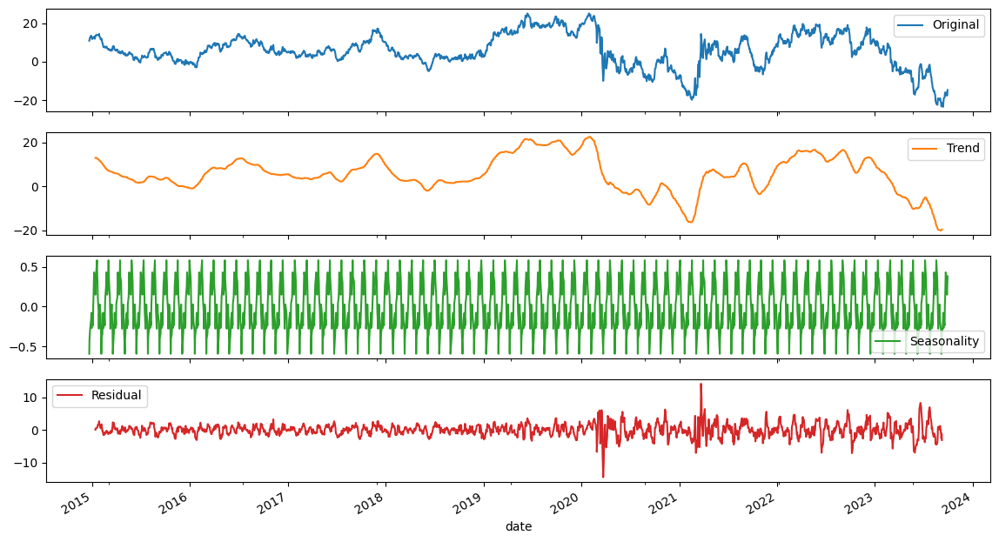

Plot open_diff_1_AEP
True


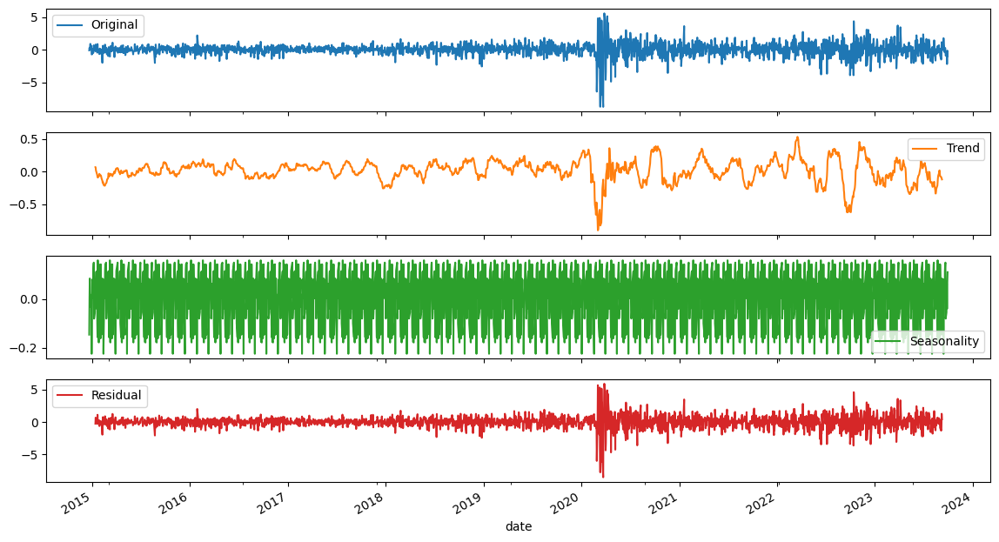

Plot open_diff_5_AEP
True


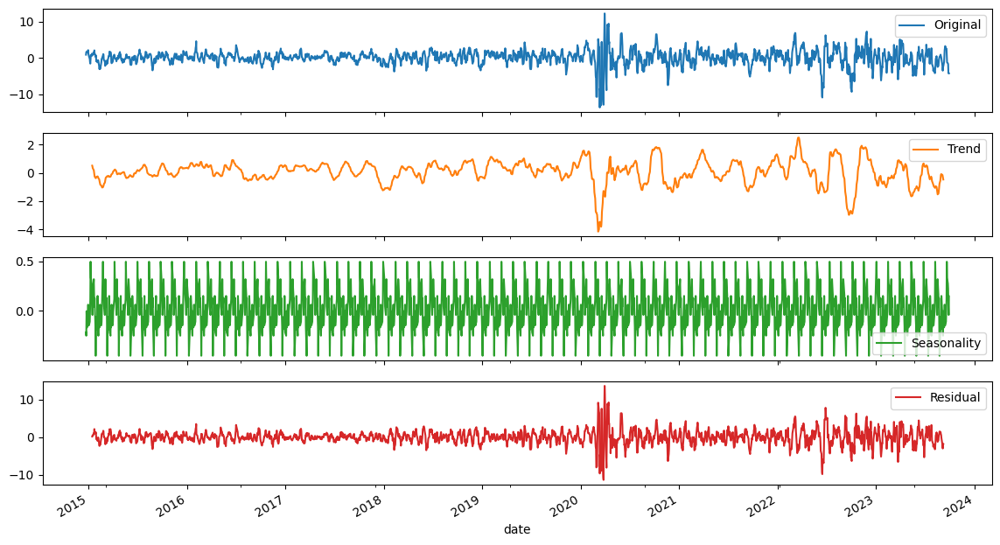

Plot open_diff_20_AEP
True


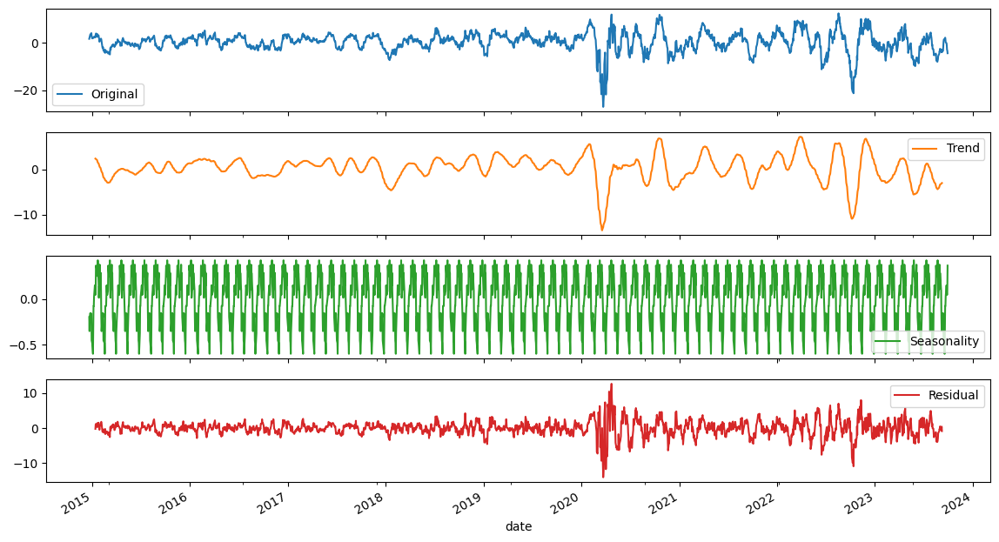

Plot open_diff_252_AEP
True


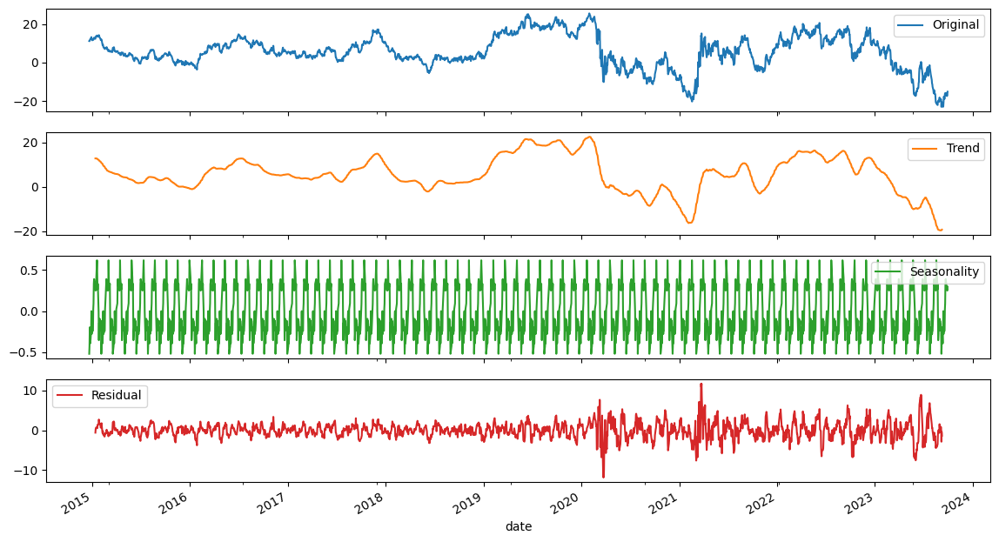

Plot low_diff_1_AEP
True


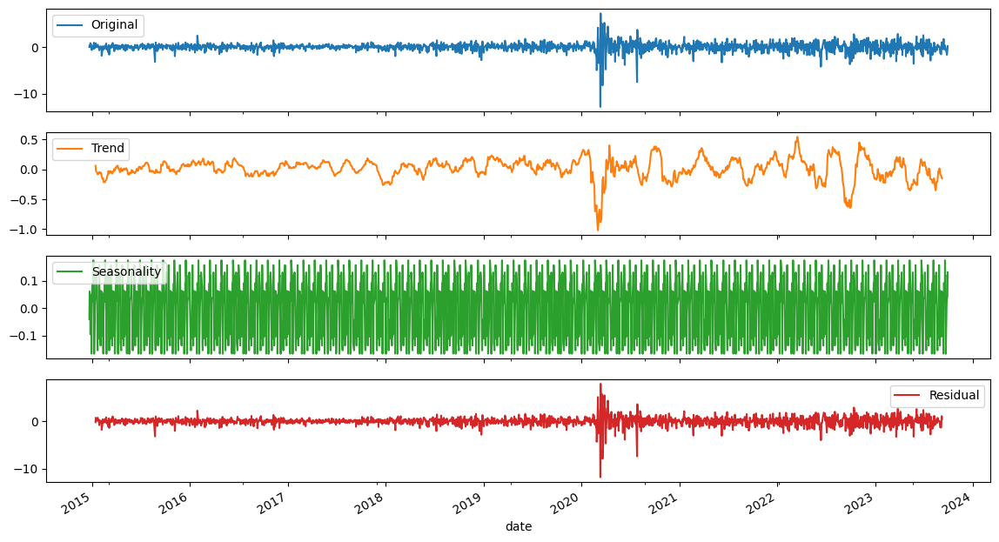

Plot low_diff_5_AEP
True


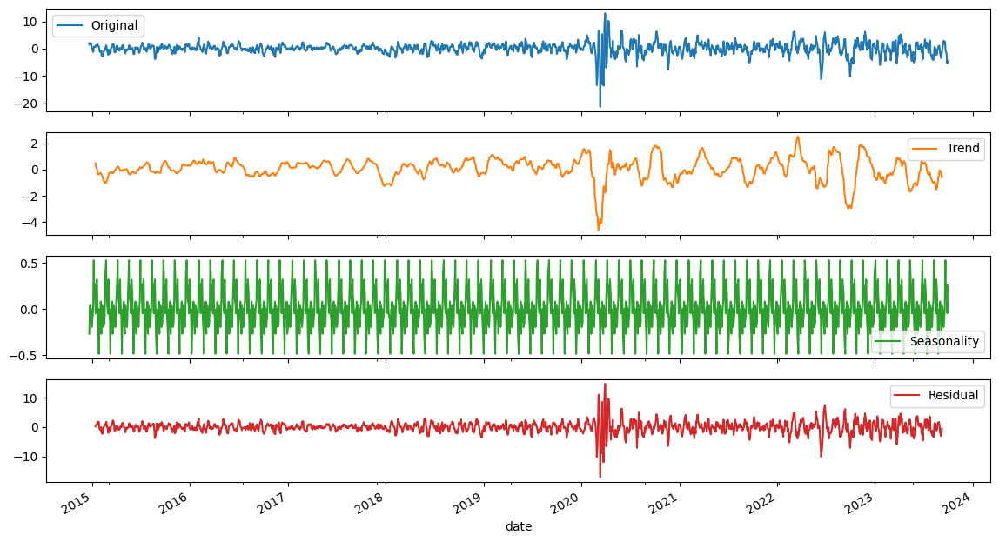

Plot low_diff_20_AEP
True


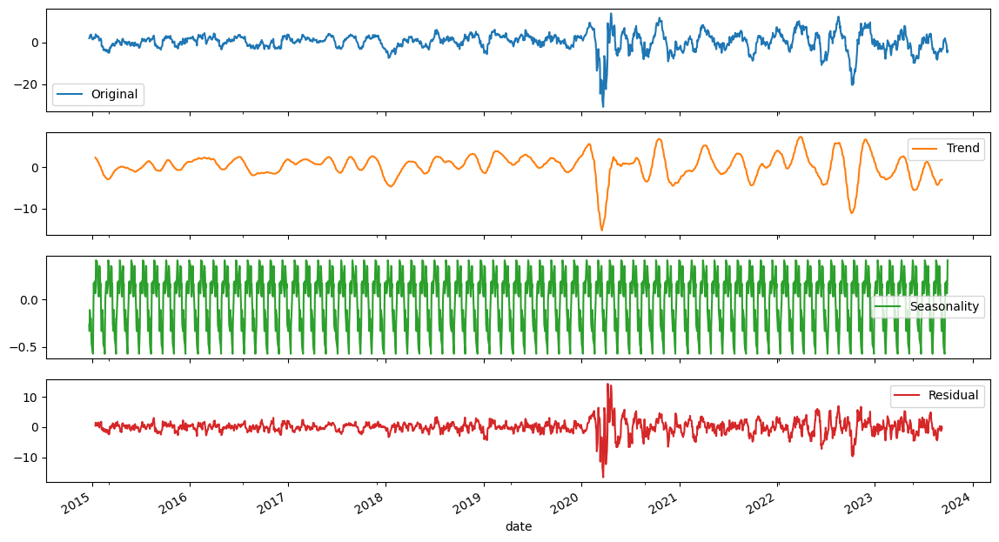

Plot low_diff_252_AEP
True


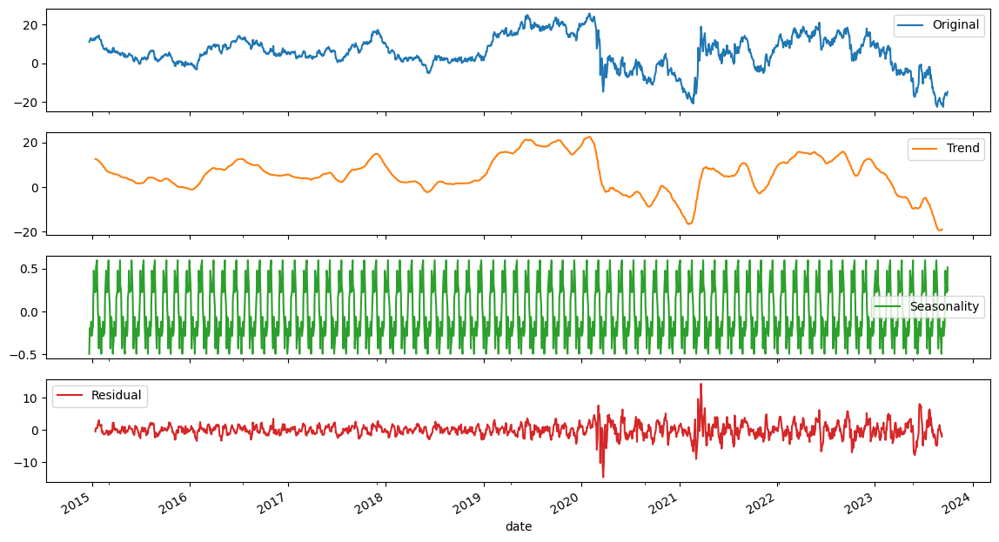

Plot momentum_kama_diff_1_AEP
True


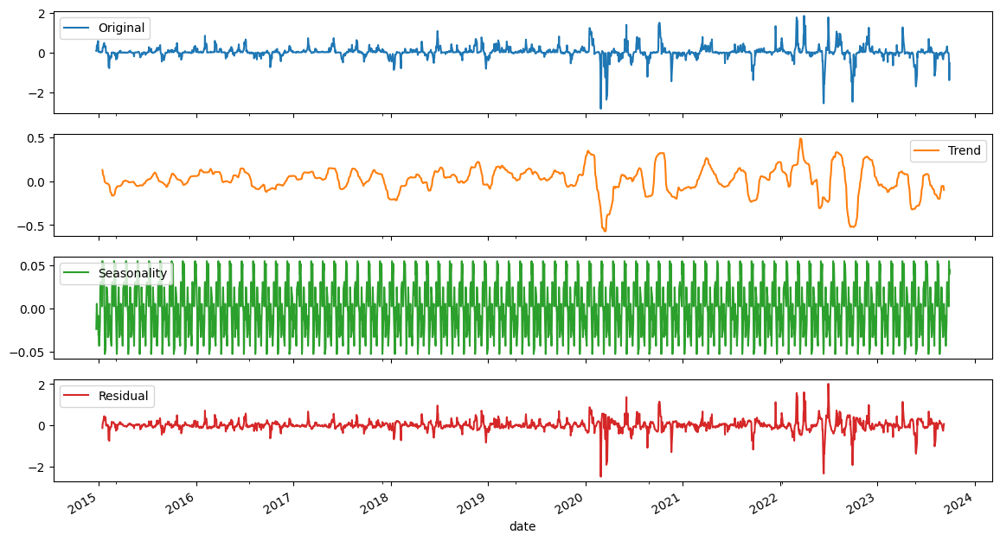

Plot momentum_kama_diff_5_AEP
True


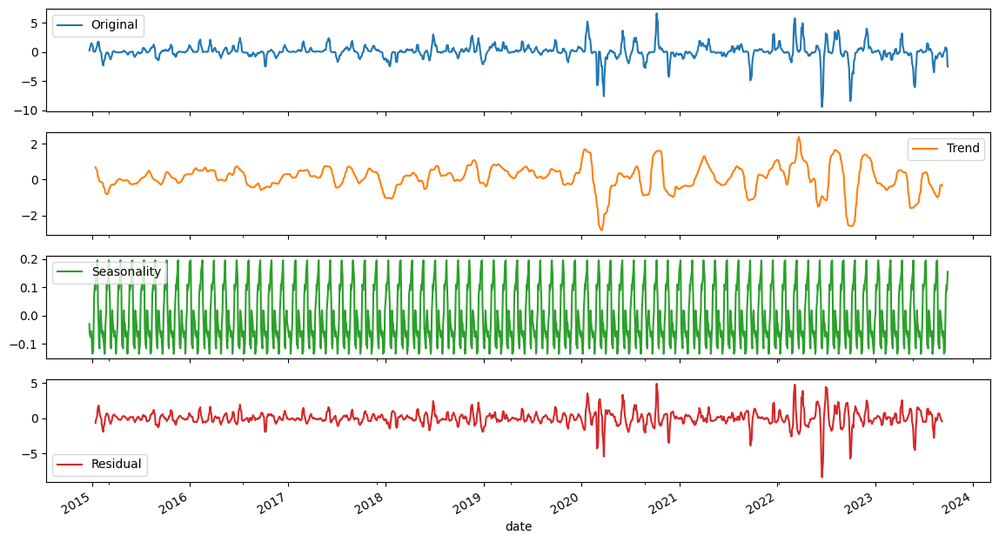

Plot momentum_kama_diff_20_AEP
True


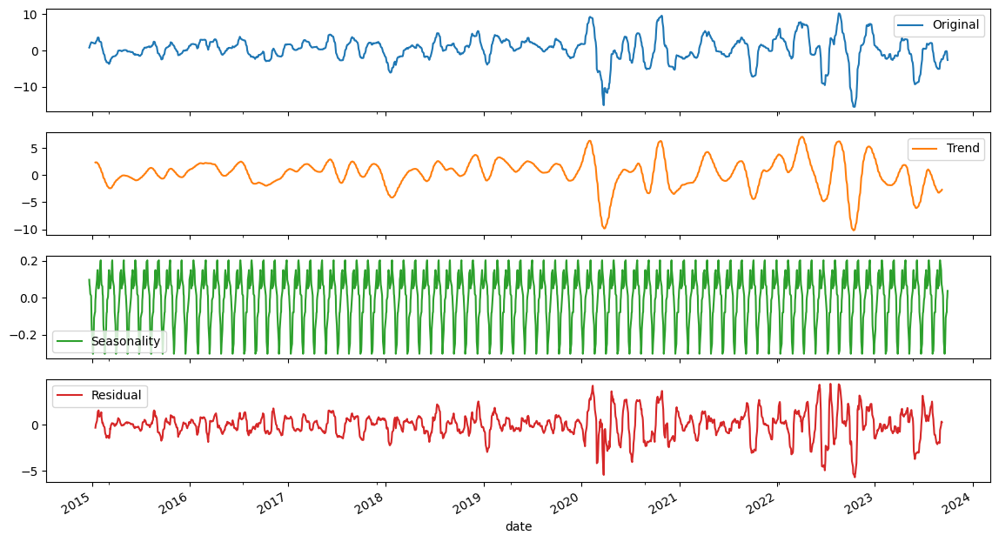

Plot momentum_kama_diff_252_AEP
True


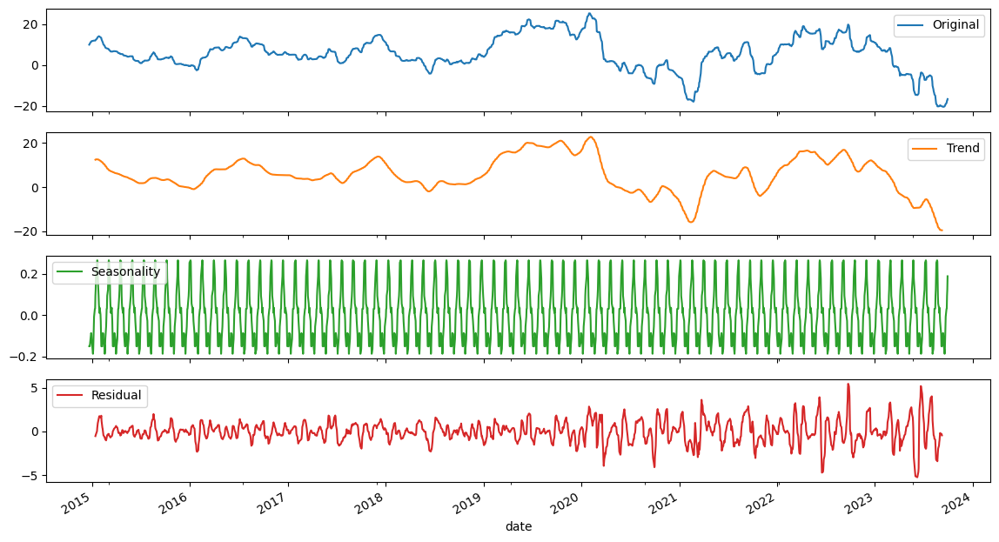

Plot others_cr_diff_1_AEP
True


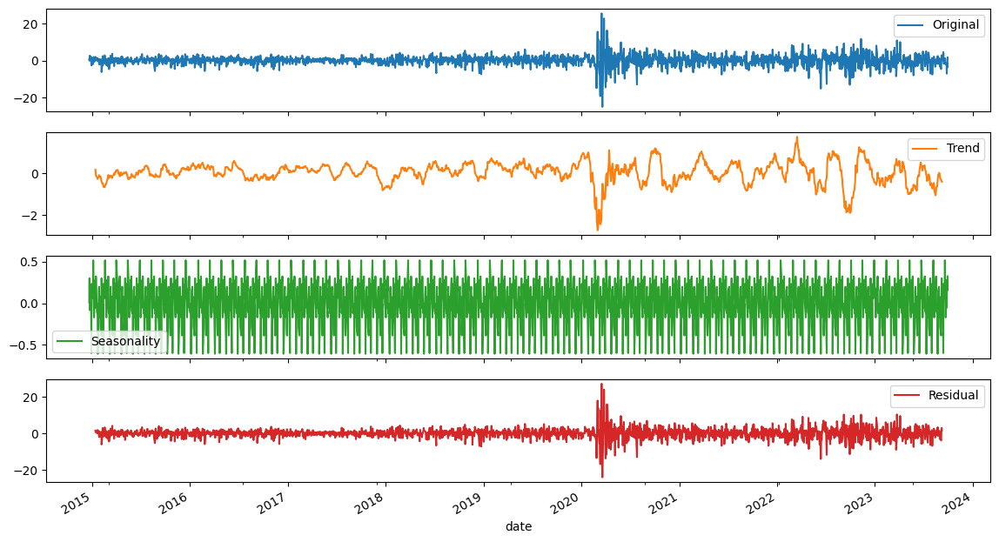

Plot others_cr_diff_5_AEP
True


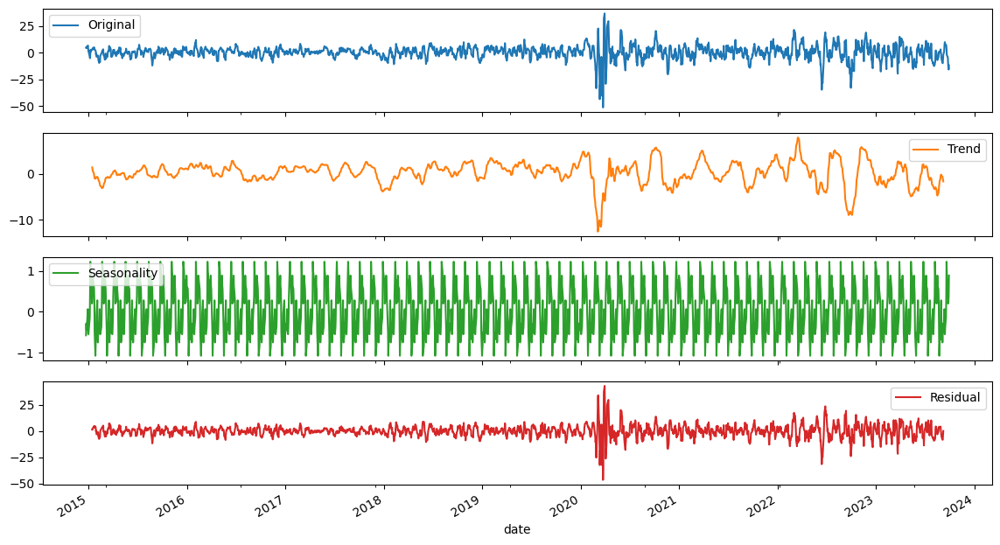

Plot others_cr_diff_20_AEP
True


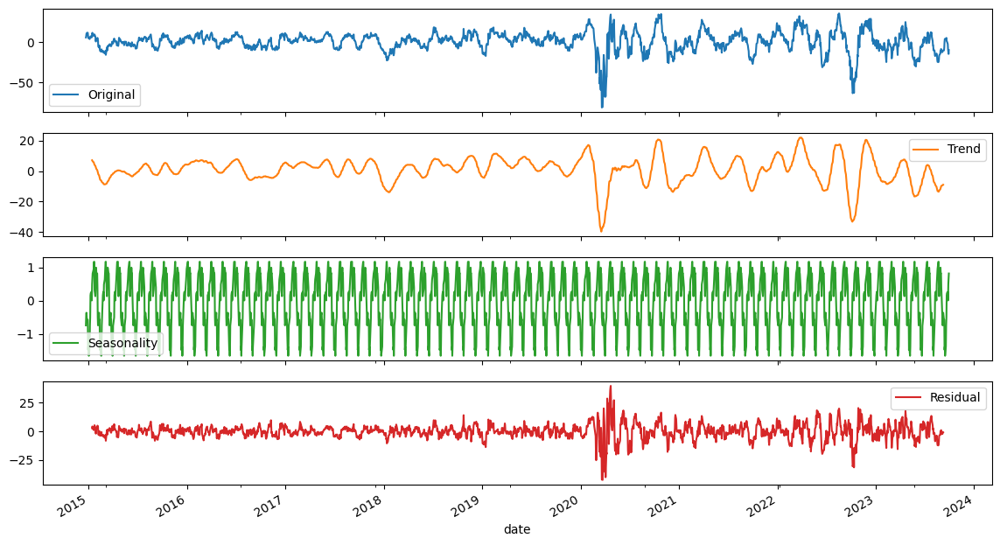

Plot others_cr_diff_252_AEP
True


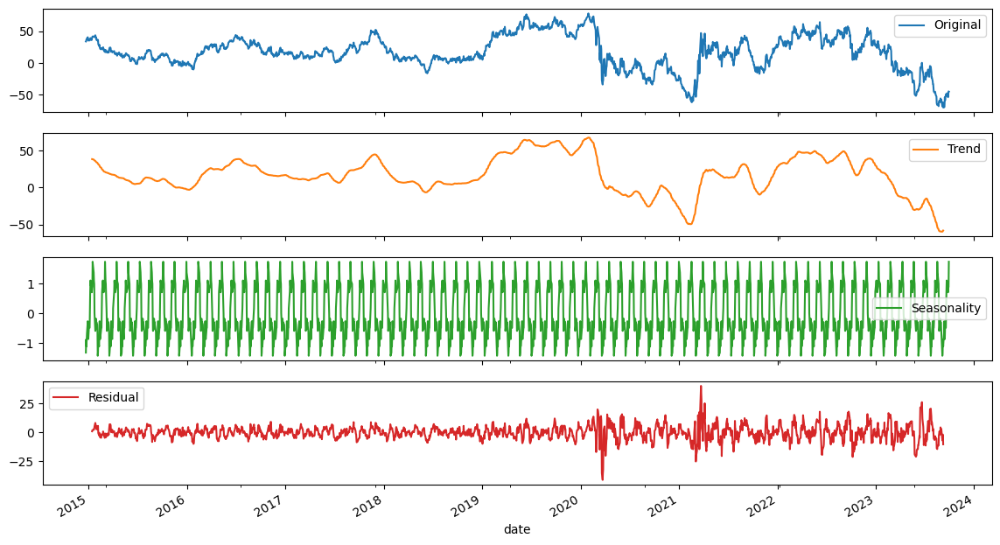

Plot trend_ema_fast_diff_1_AEP
True


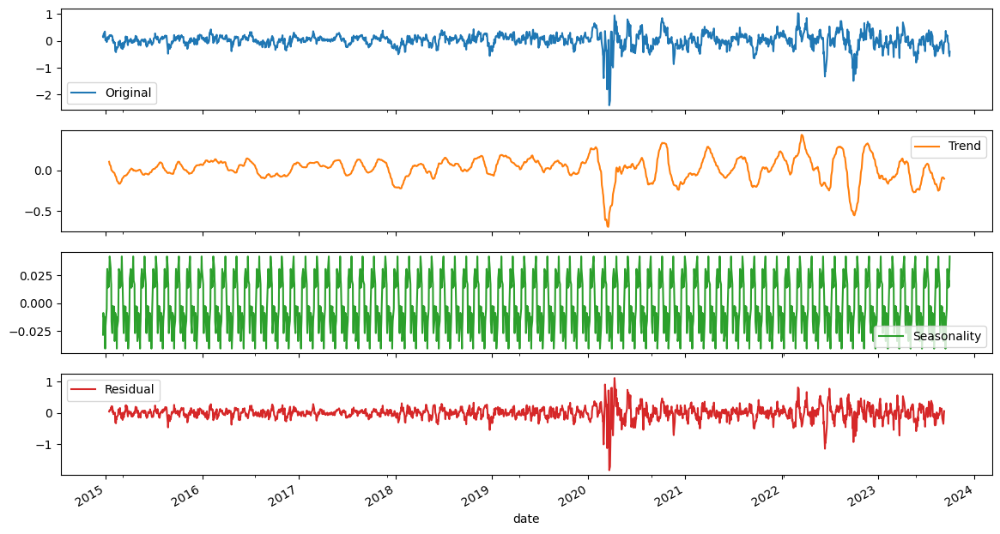

Plot trend_ema_fast_diff_5_AEP
True


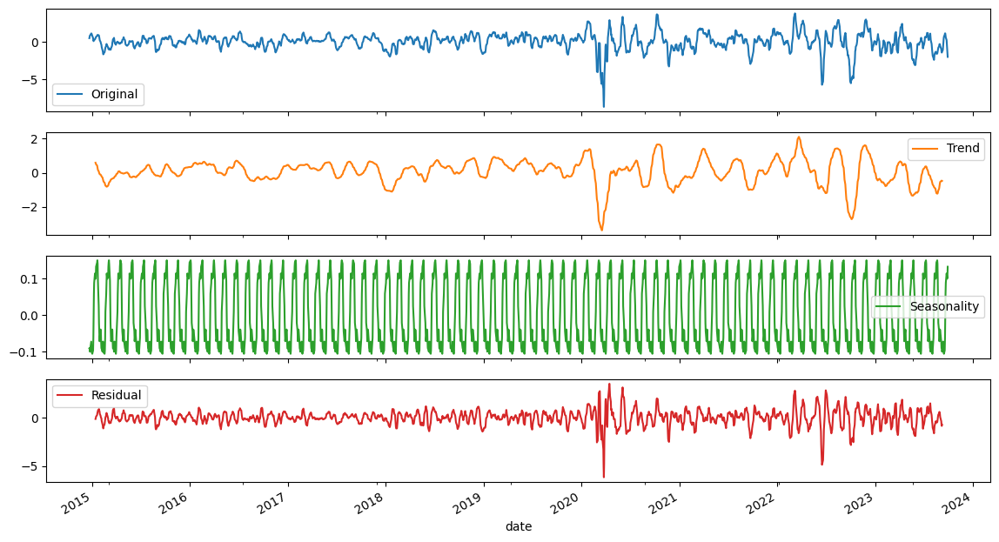

Plot trend_ema_fast_diff_20_AEP
True


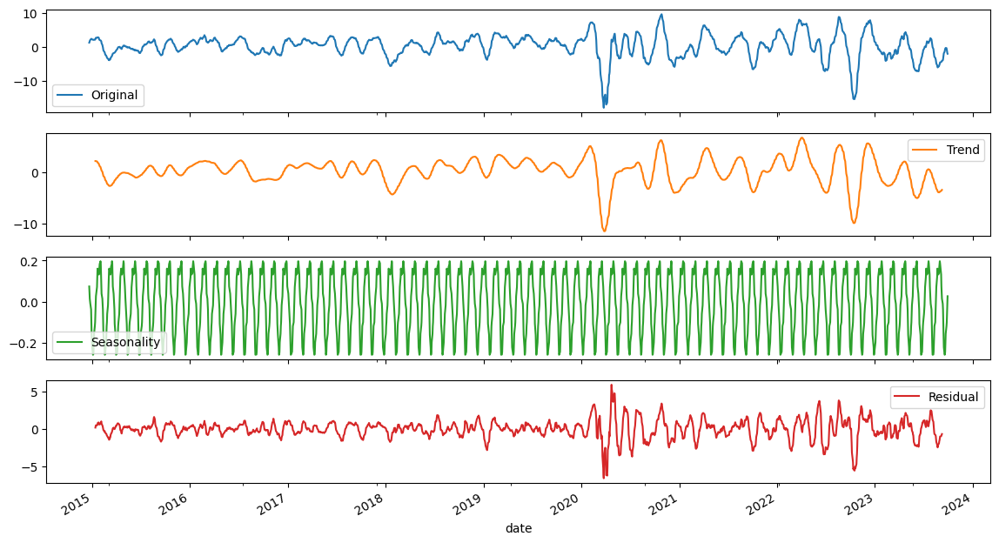

Plot trend_ema_fast_diff_252_AEP
True


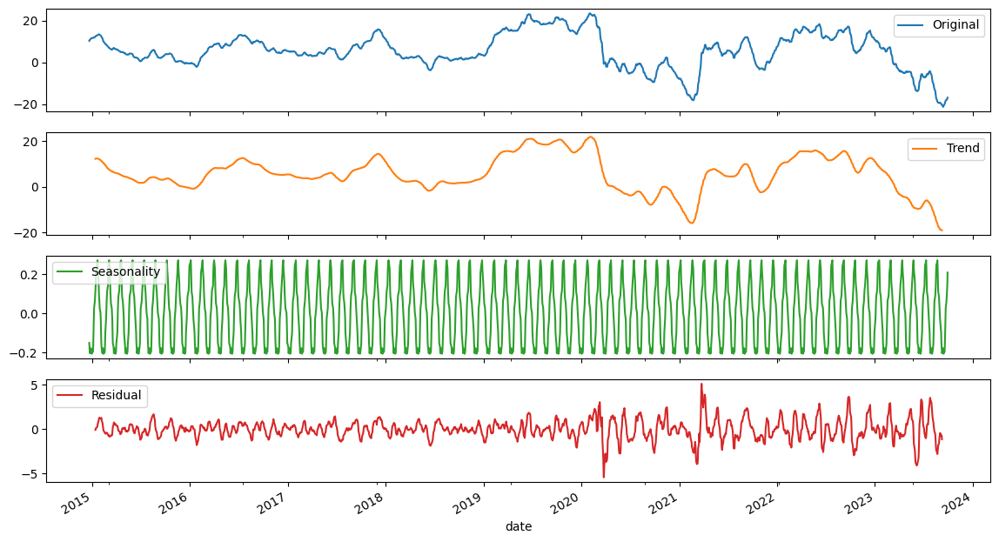

Plot trend_ema_slow_diff_1_AEP
True


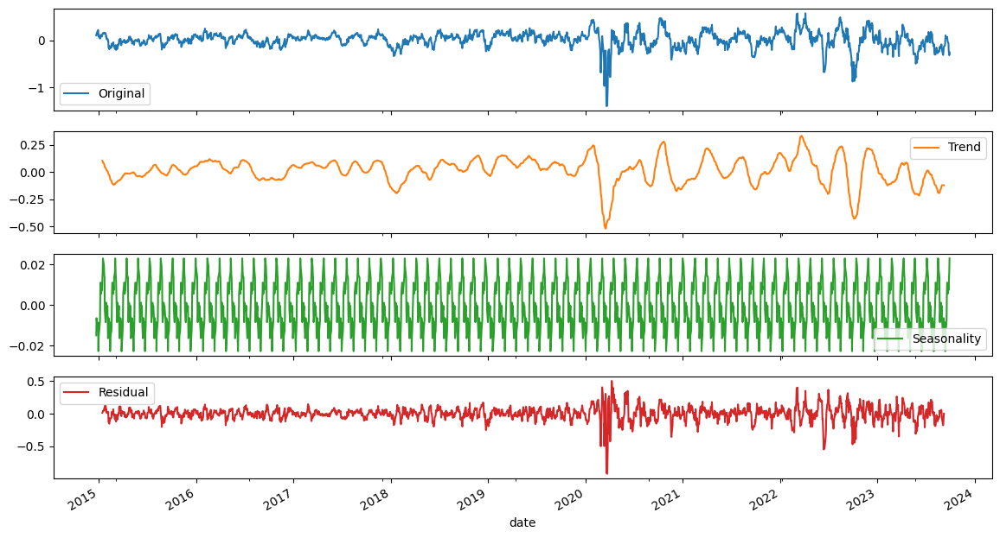

Plot trend_ema_slow_diff_5_AEP
True


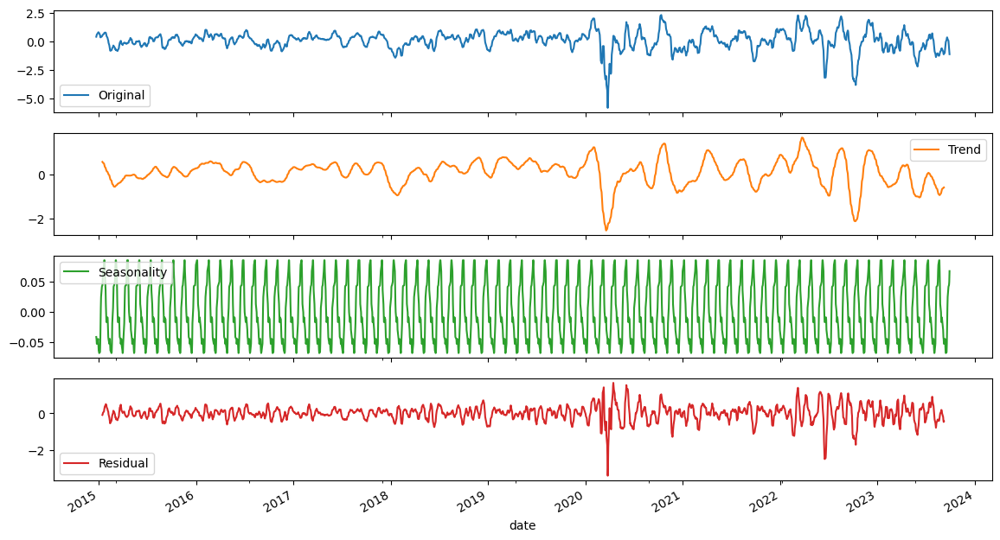

Plot trend_ema_slow_diff_20_AEP
True


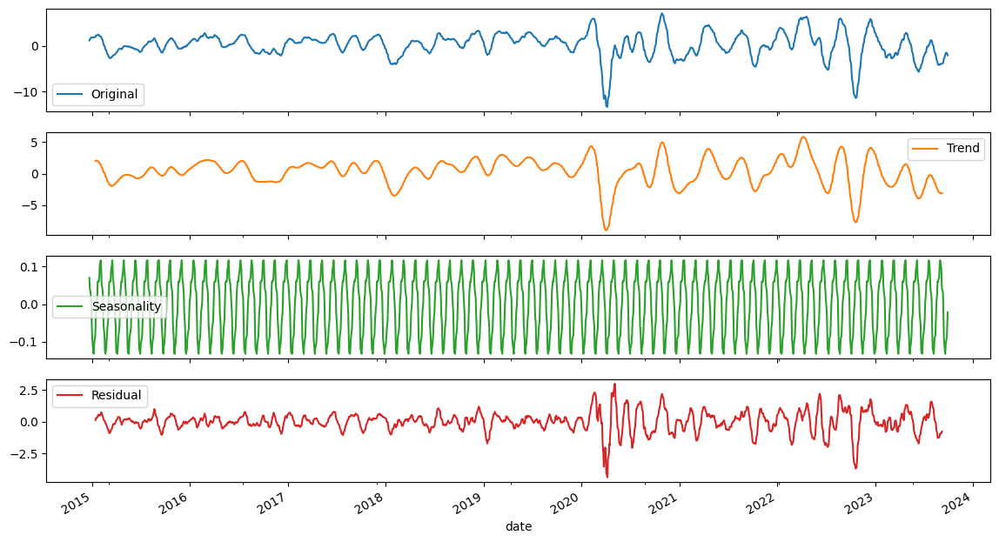

Plot trend_ema_slow_diff_252_AEP
False


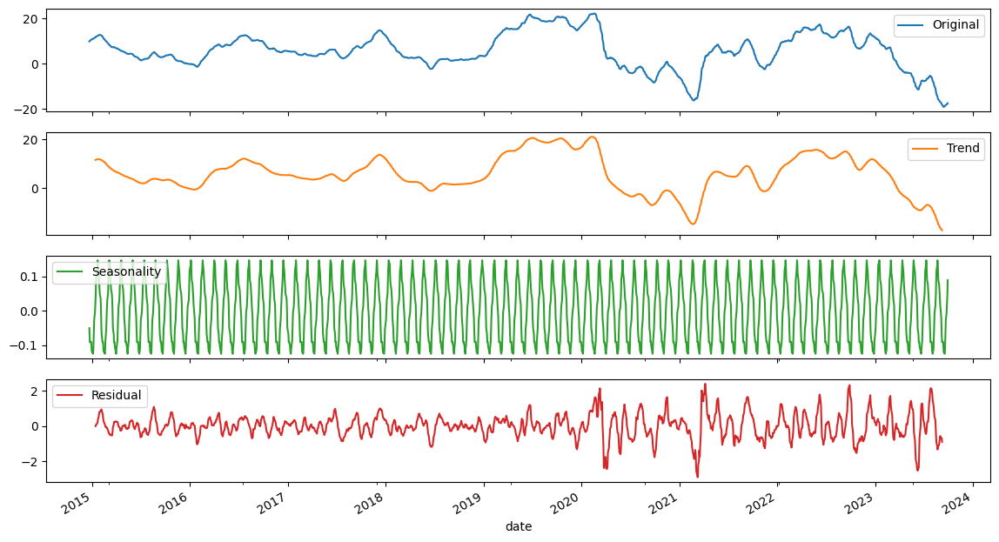

Plot trend_ichimoku_a_diff_1_AEP
True


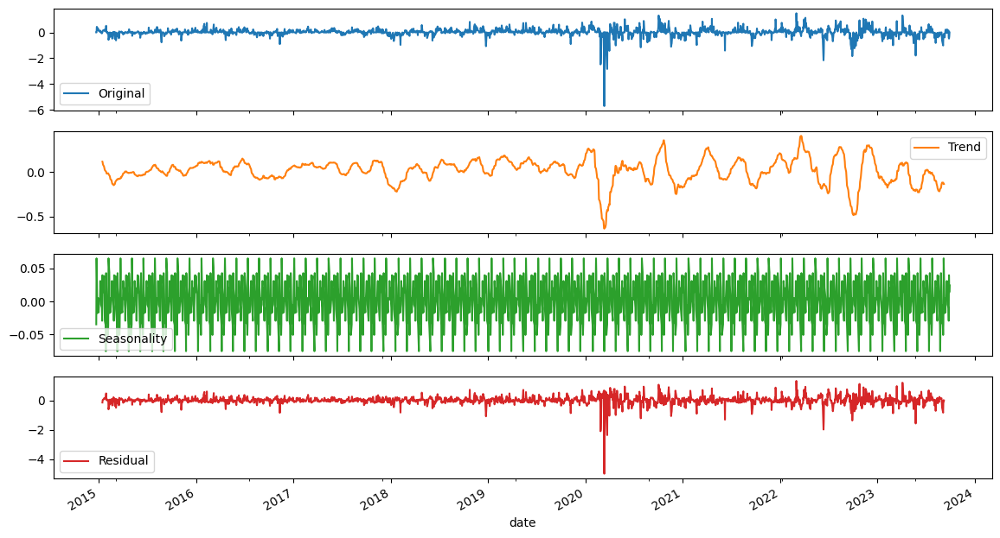

Plot trend_ichimoku_a_diff_5_AEP
True


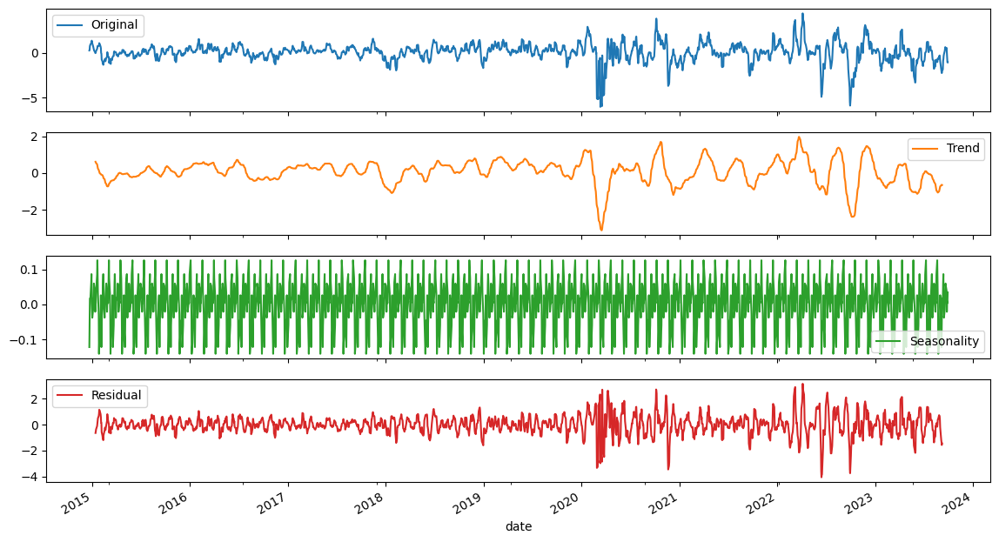

Plot trend_ichimoku_a_diff_20_AEP
True


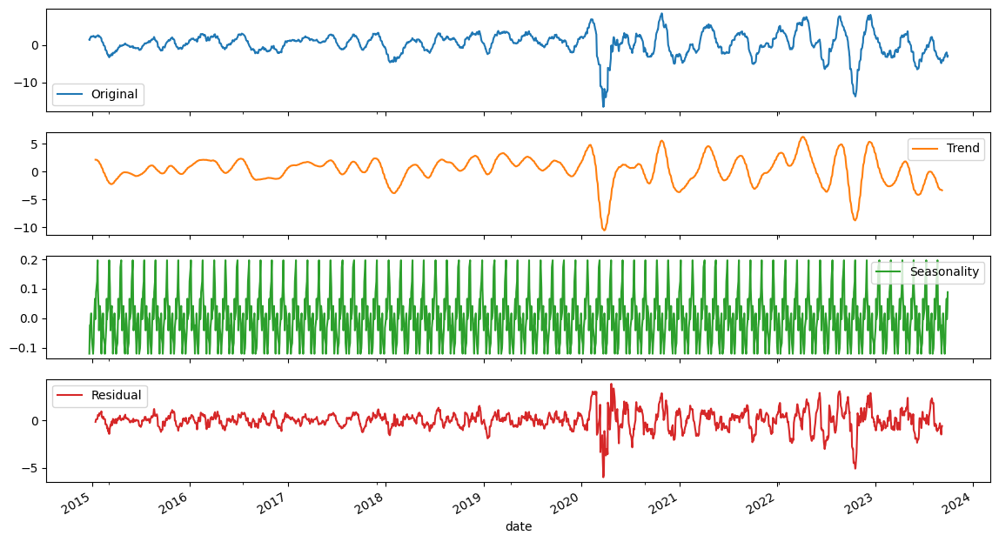

Plot trend_ichimoku_a_diff_252_AEP
False


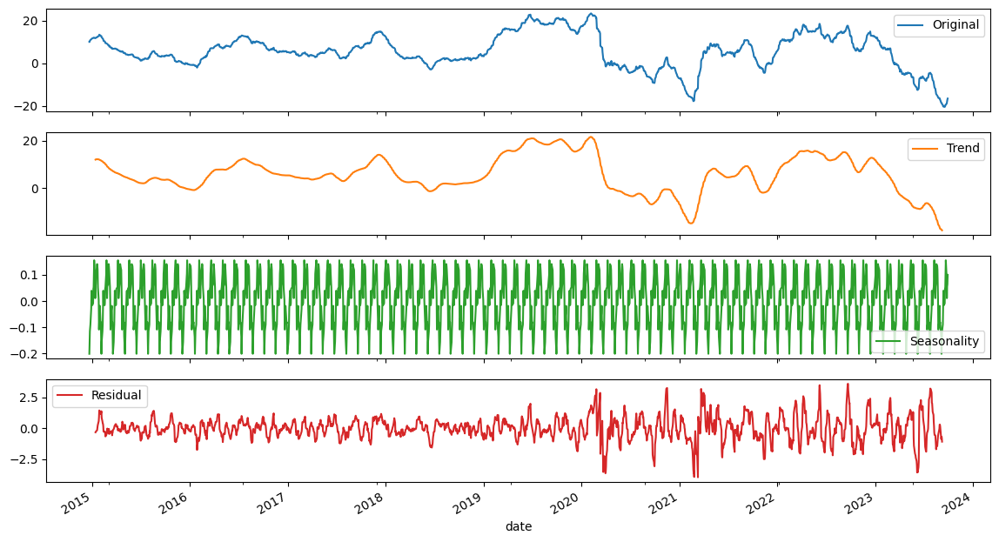

Plot trend_ichimoku_b_diff_1_AEP
True


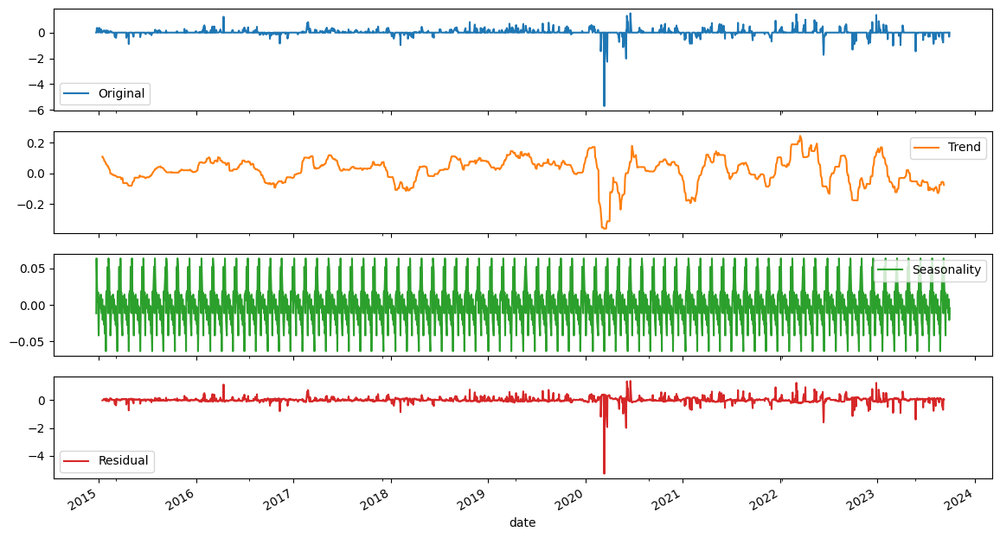

Plot trend_ichimoku_b_diff_5_AEP
True


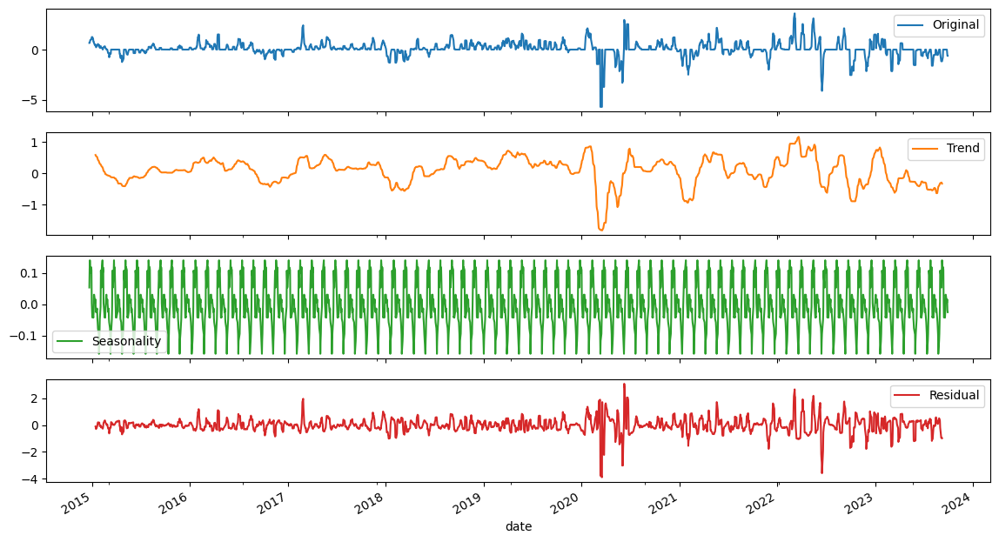

Plot trend_ichimoku_b_diff_20_AEP
True


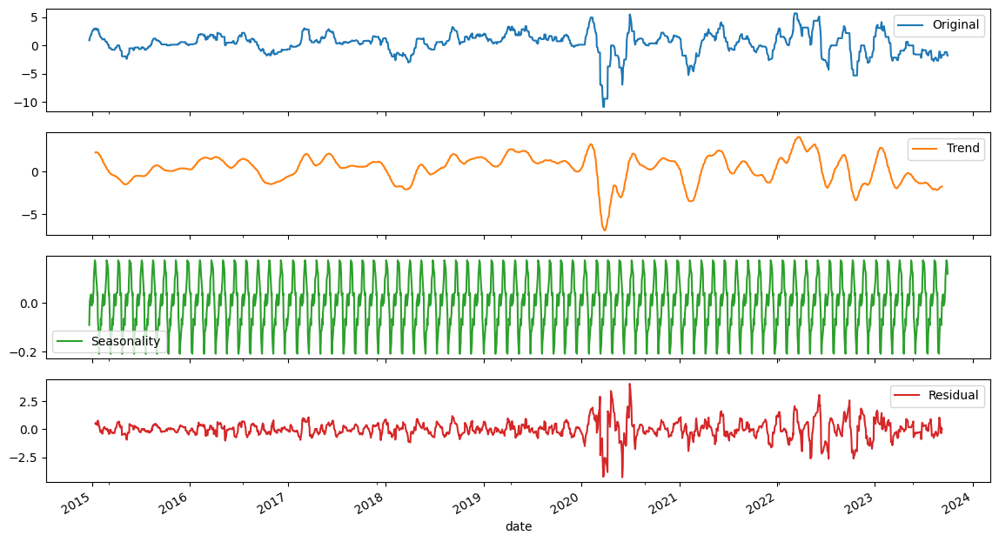

Plot trend_ichimoku_b_diff_252_AEP
False


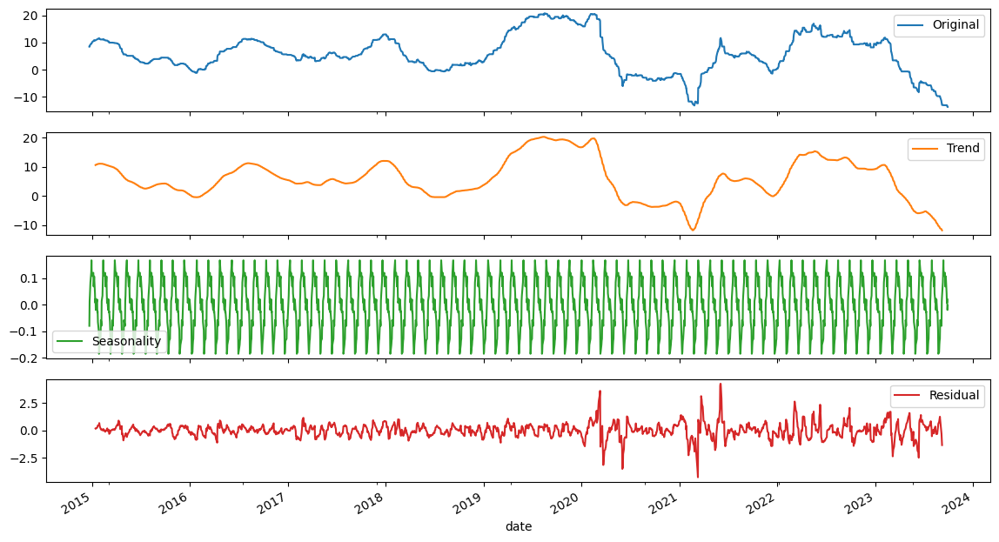

Plot trend_ichimoku_base_diff_1_AEP
True


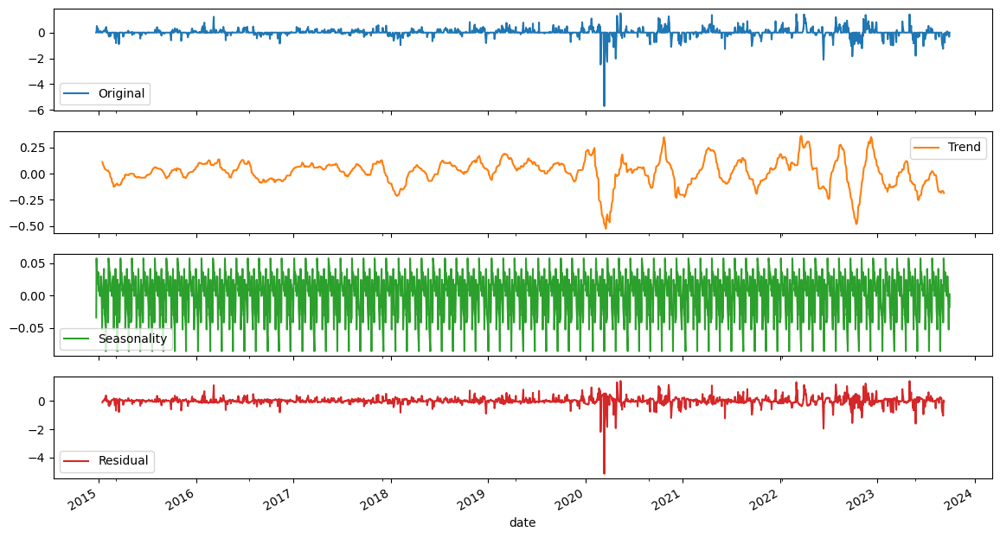

Plot trend_ichimoku_base_diff_5_AEP
True


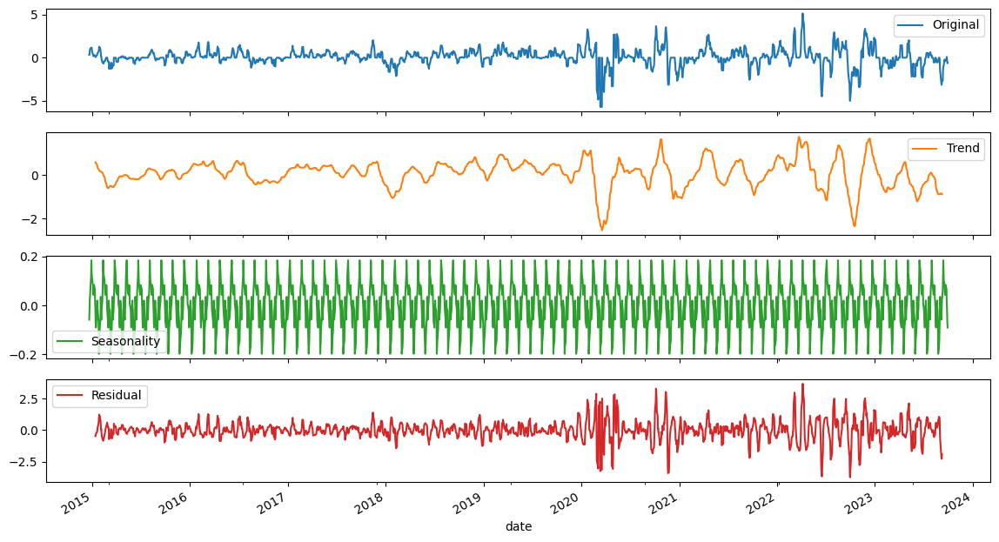

Plot trend_ichimoku_base_diff_20_AEP
True


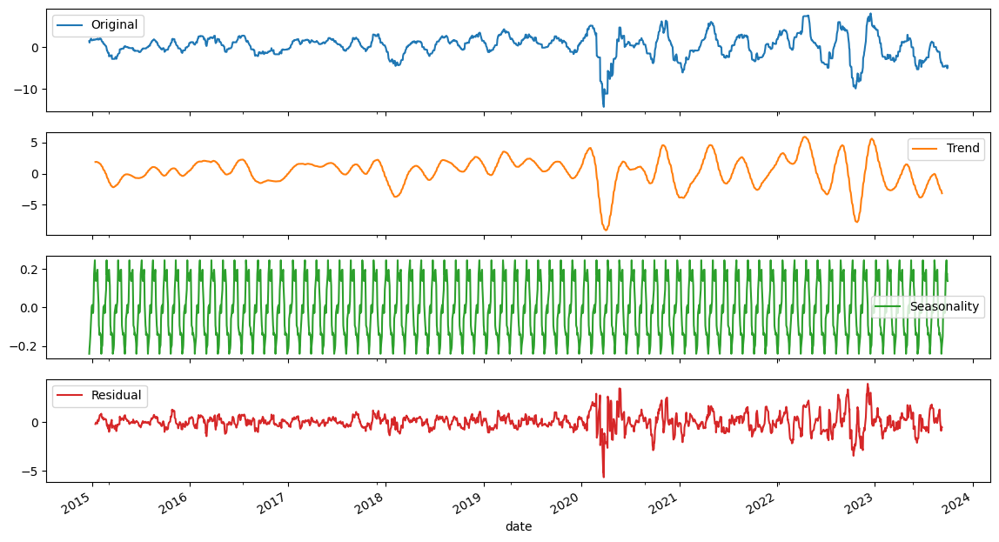

Plot trend_ichimoku_base_diff_252_AEP
True


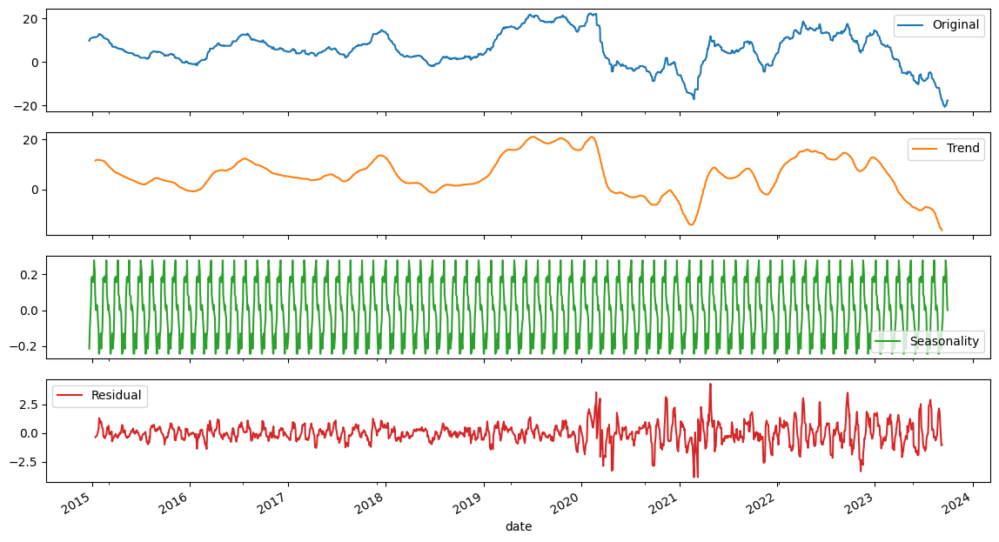

Plot trend_ichimoku_conv_diff_1_AEP
True


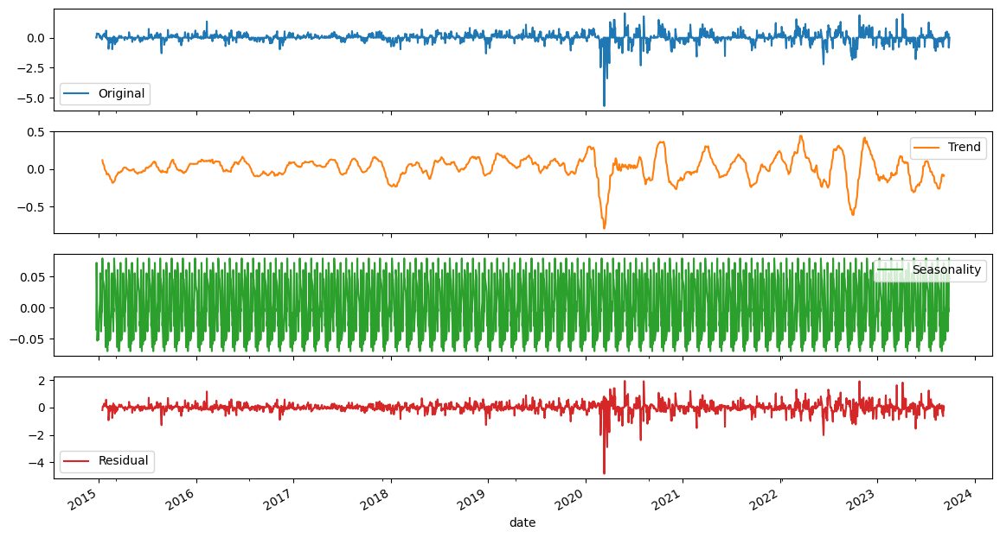

Plot trend_ichimoku_conv_diff_5_AEP
True


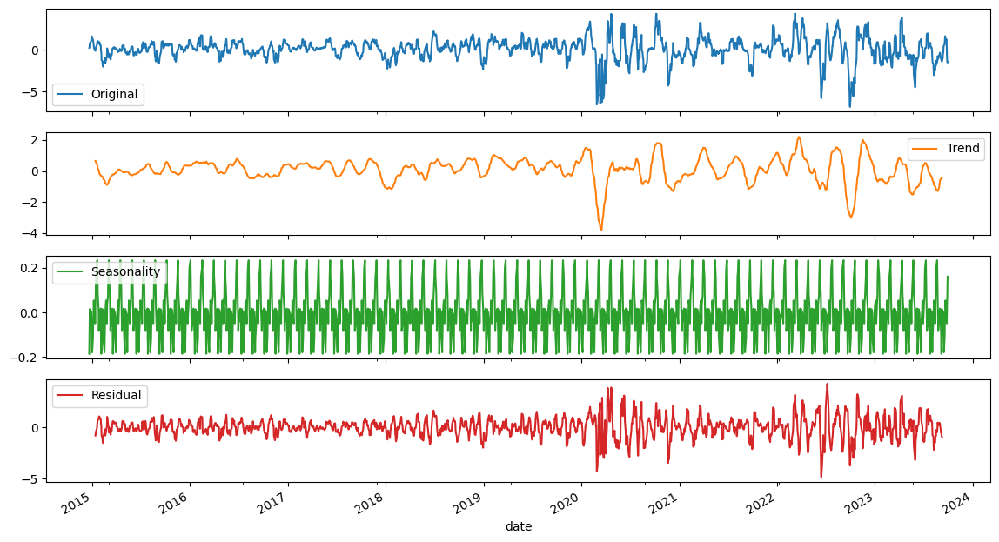

Plot trend_ichimoku_conv_diff_20_AEP
True


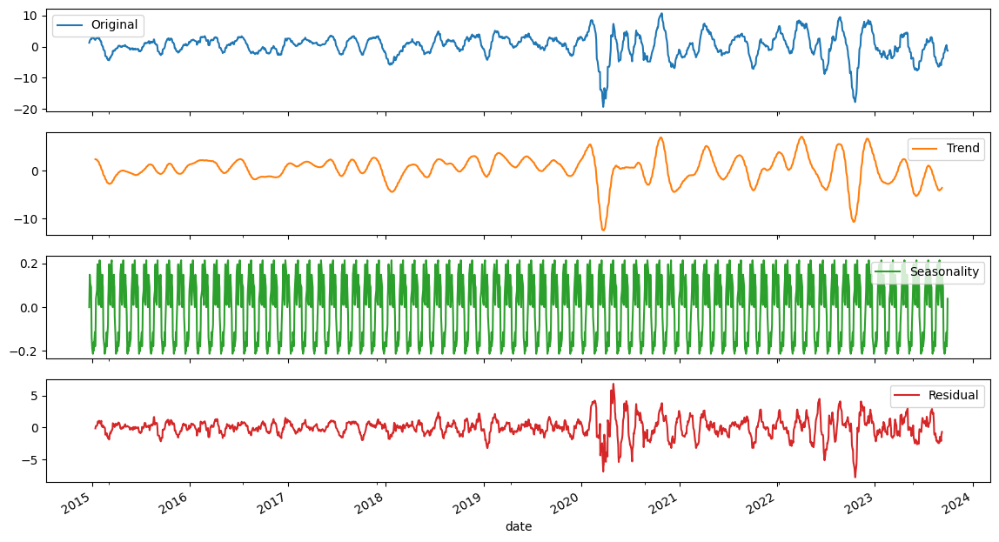

Plot trend_ichimoku_conv_diff_252_AEP
True


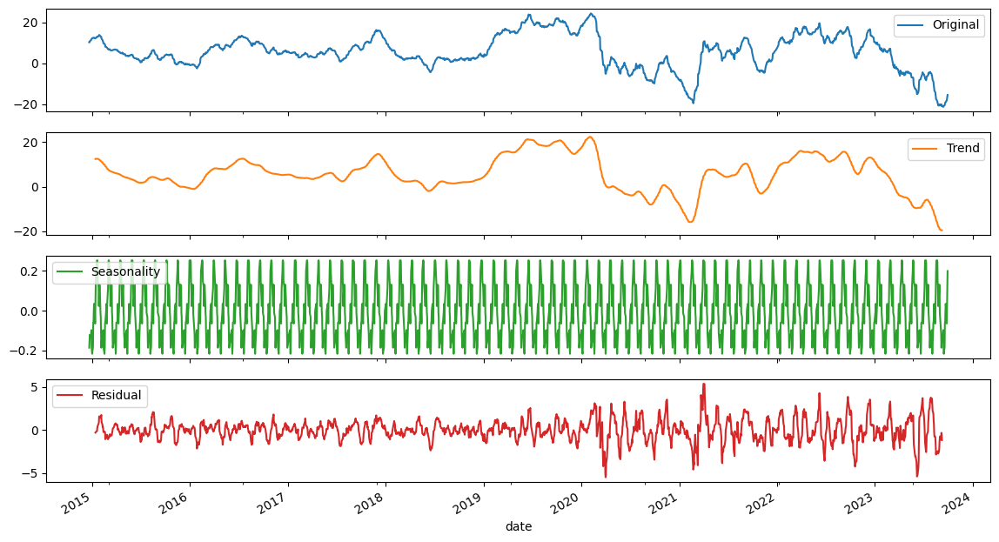

Plot trend_psar_down_diff_1_AEP
True


KeyboardInterrupt: ignored

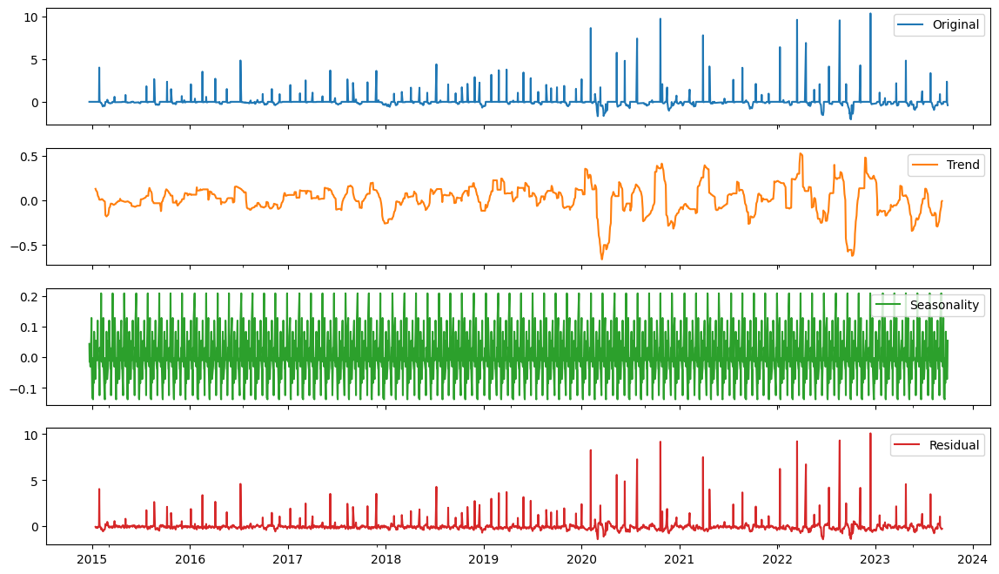

In [ ]:
import statsmodels.tsa.api as tsa

period = 30
for col in data_AEP.columns:
    series = data_AEP[col]
    #series = series.diff(periods=period).dropna()
    print(f"Plot {col}")
    print(test_stationarity(series))
    components = tsa.seasonal_decompose(series, model='additive', period=period)

    ts = (series.to_frame('Original')\
          .assign(Trend=components.trend)\
          .assign(Seasonality=components.seasonal)\
          .assign(Residual=components.resid))
    ts.plot(subplots=True, figsize=(14, 8));

    plt.show()